<a href="https://colab.research.google.com/github/yi004J13/lsa_topic/blob/main/LSA_TopicModeling.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import pickle
import numpy as np
import matplotlib.pyplot as plt
import re
import seaborn as sns
import string
import gensim
import os

!pip install wordcloud

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import TruncatedSVD
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import Normalizer
from gensim.corpora.dictionary import Dictionary
from sklearn.metrics import confusion_matrix, classification_report, precision_recall_fscore_support
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from gensim.models import CoherenceModel
from wordcloud import WordCloud

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
pickle_file = '/content/drive/MyDrive/RDS/RDSY3S1/FYP1/Code/train_data.pkl'

# Read the data from the pickle file
with open(pickle_file, 'rb') as file:
    train_data = pickle.load(file)

print(train_data)

         Detailed Category                                          WordTitle  \
0      Accelerator Physics       kek, stabilization, beam, proton, linac, mev   
1      Accelerator Physics  silicon, electron beam, trajectory, monitor, d...   
2      Accelerator Physics                         nlcta, radio beam, Monitor   
3      Accelerator Physics     period, mm, length, superconductive, undulator   
4      Accelerator Physics  asynchronous, active, longitudinal, accelerato...   
...                    ...                                                ...   
40628        Tumor Biology                    simulate, organogenesis, comsol   
40629        Tumor Biology  intestinal, model, crypt, organization, carcin...   
40630        Tumor Biology  profile, increase, force, note, resistance, ov...   
40631        Tumor Biology  adult, transplant, kidney, protein, mycophenol...   
40632        Tumor Biology  stomach, model, gastric, neuronal, firing, slo...   

                           

In [ ]:
pickle_file = '/content/drive/MyDrive/RDS/RDSY3S1/FYP1/Code/test_data.pkl'

# Read the data from the pickle file
with open(pickle_file, 'rb') as file:
    test_data = pickle.load(file)

##### Number of topic by using More details category

In [ ]:
pickle_file = '/content/drive/MyDrive/RDS/RDSY3S1/FYP1/Code/cleaned_dataset.pkl'

# Read the data from the pickle file
with open(pickle_file, 'rb') as file:
    clean_data = pickle.load(file)

    df = pd.DataFrame(clean_data)

# Get unique topics from the 'Primary Category' column
unique_topics = df['Full Description'].unique()
n_topics = len(unique_topics)

print(f"Number of unique topics: {n_topics}")

Number of unique topics: 152


##### Number of topic by using Prefix category

In [ ]:
# Get unique topics from the 'Primary Category' column
unique_topics = df['Prefix'].unique()
n_topics = len(unique_topics)

print(f"Number of unique topics: {n_topics}")

Number of unique topics: 12


In [ ]:
traindf = train_data[['WordTitle', 'WordSummary']]
traindf.head()

,WordTitle,WordSummary
0,"kek, stabilization, beam, proton, linac, mev","instal, fed, velocity, article, debuncher, pro..."
1,"silicon, electron beam, trajectory, monitor, d...","defines, electron, kev, silicon, micron, ampli..."
2,"nlcta, radio beam, Monitor","slope, nlcta, implementation, software, file, ..."
3,"period, mm, length, superconductive, undulator","mm, length, superconductive, vacuum, wire, dev..."
4,"asynchronous, active, longitudinal, accelerato...","frequency, operation, overcome, accelerate, ch..."


In [ ]:
print(train_data)

         Detailed Category                                          WordTitle  \
0      Accelerator Physics       kek, stabilization, beam, proton, linac, mev   
1      Accelerator Physics  silicon, electron beam, trajectory, monitor, d...   
2      Accelerator Physics                         nlcta, radio beam, Monitor   
3      Accelerator Physics     period, mm, length, superconductive, undulator   
4      Accelerator Physics  asynchronous, active, longitudinal, accelerato...   
...                    ...                                                ...   
40628        Tumor Biology                    simulate, organogenesis, comsol   
40629        Tumor Biology  intestinal, model, crypt, organization, carcin...   
40630        Tumor Biology  profile, increase, force, note, resistance, ov...   
40631        Tumor Biology  adult, transplant, kidney, protein, mycophenol...   
40632        Tumor Biology  stomach, model, gastric, neuronal, firing, slo...   

                           

#### Combine the words based on Topic

In [ ]:
train_df = pd.DataFrame(train_data)

# Combine the columns without duplicate words
train_df['WordsTopic'] = train_df.apply(
    lambda row: ', '.join(
        sorted(set(row['WordTitle'].split(', ') + row['WordSummary'].split(', ')))
    ),
    axis=1
)

# Display the updated DataFrame
print(train_df)

         Detailed Category                                          WordTitle  \
0      Accelerator Physics       kek, stabilization, beam, proton, linac, mev   
1      Accelerator Physics  silicon, electron beam, trajectory, monitor, d...   
2      Accelerator Physics                         nlcta, radio beam, Monitor   
3      Accelerator Physics     period, mm, length, superconductive, undulator   
4      Accelerator Physics  asynchronous, active, longitudinal, accelerato...   
...                    ...                                                ...   
40628        Tumor Biology                    simulate, organogenesis, comsol   
40629        Tumor Biology  intestinal, model, crypt, organization, carcin...   
40630        Tumor Biology  profile, increase, force, note, resistance, ov...   
40631        Tumor Biology  adult, transplant, kidney, protein, mycophenol...   
40632        Tumor Biology  stomach, model, gastric, neuronal, firing, slo...   

                           

In [ ]:
test_df = pd.DataFrame(test_data)

# Combine the columns without duplicate words
test_df['WordsTopic'] = test_df.apply(
    lambda row: ', '.join(
        sorted(set(row['WordTitle'].split(', ') + row['WordSummary'].split(', ')))
    ),
    axis=1
)

# Display the updated DataFrame
print(test_df)

         Detailed Category                                          WordTitle  \
0      Accelerator Physics  wakefield, diffraction, applicability, calcula...   
1      Accelerator Physics  periodically, channel, particle, crystal, lase...   
2      Accelerator Physics  consequence, transition, practical, coherence,...   
3      Accelerator Physics  nonlinearities, linear accelerator, particle, ...   
4      Accelerator Physics                              test, mhz, circulator   
...                    ...                                                ...   
10195        Tumor Biology  ripen, alatus, face, premature, hit, red, leav...   
10196        Tumor Biology         wound, advance, collagen, medical dressing   
10197        Tumor Biology      esr, infinitesimal calculus, test, fractional   
10198        Tumor Biology  sauropod dinosaur, palaeobiology, history, tax...   
10199        Tumor Biology  medicine, personalize, context, histo, blood, ...   

                           

In [ ]:
def preprocess_text(text):
    # Remove special characters, numbers, and convert to lowercase
    text = re.sub(r'\W+', ' ', text)  # Remove non-word characters
    text = re.sub(r'\d+', '', text)  # Remove numbers
    # Replace punctuation except for commas with a blank space
    text = ''.join(' ' if char in string.punctuation and char != ',' else char for char in text)
    return text.lower()

In [ ]:
# Temporarily rename columns for train_df
train_df = train_df.rename(columns={
    'Detailed Category': 'train_label',
    'WordsTopic': 'train_input'
})

# Temporarily rename columns for test_df
test_df = test_df.rename(columns={
    'Detailed Category': 'test_label',
    'WordsTopic': 'test_input'
})

# Display the temporary DataFrames
print("Temporary Train DataFrame:")
print(train_df)

print("\nTemporary Test DataFrame:")
print(test_df)

Temporary Train DataFrame:
               train_label                                          WordTitle  \
0      Accelerator Physics       kek, stabilization, beam, proton, linac, mev   
1      Accelerator Physics  silicon, electron beam, trajectory, monitor, d...   
2      Accelerator Physics                         nlcta, radio beam, Monitor   
3      Accelerator Physics     period, mm, length, superconductive, undulator   
4      Accelerator Physics  asynchronous, active, longitudinal, accelerato...   
...                    ...                                                ...   
40628        Tumor Biology                    simulate, organogenesis, comsol   
40629        Tumor Biology  intestinal, model, crypt, organization, carcin...   
40630        Tumor Biology  profile, increase, force, note, resistance, ov...   
40631        Tumor Biology  adult, transplant, kidney, protein, mycophenol...   
40632        Tumor Biology  stomach, model, gastric, neuronal, firing, slo...   



In [ ]:
# Apply preprocessing to all rows in the DataFrame
train_df['train_input'] = train_df['train_input'].apply(preprocess_text)

# Group by 'train_label' and combine texts, removing duplicate words
combined_train_df = (
    train_df
    .groupby('train_label')['train_input']
    .apply(lambda x: ' '.join(set(' '.join(x).split())))
    .reset_index()
)

# Display the combined DataFrame
print("Combined DataFrame based on train_label without repeating words:")
print(train_df)

Combined DataFrame based on train_label without repeating words:
               train_label                                          WordTitle  \
0      Accelerator Physics       kek, stabilization, beam, proton, linac, mev   
1      Accelerator Physics  silicon, electron beam, trajectory, monitor, d...   
2      Accelerator Physics                         nlcta, radio beam, Monitor   
3      Accelerator Physics     period, mm, length, superconductive, undulator   
4      Accelerator Physics  asynchronous, active, longitudinal, accelerato...   
...                    ...                                                ...   
40628        Tumor Biology                    simulate, organogenesis, comsol   
40629        Tumor Biology  intestinal, model, crypt, organization, carcin...   
40630        Tumor Biology  profile, increase, force, note, resistance, ov...   
40631        Tumor Biology  adult, transplant, kidney, protein, mycophenol...   
40632        Tumor Biology  stomach, model, 

#### Configuration 1: Basic TF-IDF Vectorization

In [ ]:
vectorizer1 = TfidfVectorizer(stop_words='english')
X_tfidf1 = vectorizer1.fit_transform(combined_train_df['train_input'])

#### Configuration 2: Include Bigrams

In [ ]:
vectorizer2 = TfidfVectorizer(stop_words='english', ngram_range=(1, 2))
X_tfidf2 = vectorizer2.fit_transform(combined_train_df['train_input'])

#### Configuration 3: Limit Features

In [ ]:
vectorizer3 = TfidfVectorizer(stop_words='english', max_features=1000)
X_tfidf3 = vectorizer3.fit_transform(combined_train_df['train_input'])

#### Configuration 4: Use Minimum and Maximum Document Frequency

In [ ]:
vectorizer4 = TfidfVectorizer(stop_words='english', min_df=1, max_df=5)
X_tfidf4 = vectorizer4.fit_transform(combined_train_df['train_input'])

In [ ]:
unique_categories = combined_train_df['train_label']
print(f"{unique_categories}")
num_unique_categories = combined_train_df['train_label'].nunique()

0                    Accelerator Physics
1            Adaptation and Optimization
2                Algebraic Combinatorics
3                     Algebraic Geometry
4                     Algebraic Topology
                     ...                
136                  Systems and Control
137                Theoretical Economics
138                               Theory
139    Trading and Market Microstructure
140                        Tumor Biology
Name: train_label, Length: 141, dtype: object


In [ ]:
def apply_lsa(X_tfidf, n_components=None):
    # Dynamically set n_components if not provided or too high
    n_components = n_components or min(X_tfidf.shape[1], num_unique_categories)
    n_components = min(n_components, X_tfidf.shape[1])  # Ensure it doesn't exceed available features

    # Apply LSA using TruncatedSVD
    from sklearn.decomposition import TruncatedSVD
    lsa = TruncatedSVD(n_components=n_components)
    lsa_topic_matrix = lsa.fit_transform(X_tfidf)
    return lsa, lsa_topic_matrix

lsa1, lsa_matrix1 = apply_lsa(X_tfidf1)
lsa2, lsa_matrix2 = apply_lsa(X_tfidf2)
lsa3, lsa_matrix3 = apply_lsa(X_tfidf3)
lsa4, lsa_matrix4 = apply_lsa(X_tfidf4)

#### Evaluation of 4 Configuration

In [ ]:
# Function to print top terms for each topic with unique labels (even if content repeats)
def print_top_terms_with_labels(lsa, vectorizer, category_column, num_top_terms=10):
    feature_names = vectorizer.get_feature_names_out()
    num_topics = lsa.components_.shape[0]  # Get the number of topics from LSA components
    num_categories = len(category_column)

    # Assign categories to topics (avoiding repeats for labels)
    for topic_idx in range(num_topics):
        top_terms_idx = np.argsort(lsa.components_[topic_idx])[-num_top_terms:][::-1]
        top_terms = [feature_names[i] for i in top_terms_idx]

        # Assign category label to topic
        if topic_idx < num_categories:
            topic_label = category_column.iloc[topic_idx]
        else:
            # If topics exceed categories, assign generic names for additional topics
            topic_label = f"Topic #{topic_idx + 1}"  # Default label for extra topics

        print(f"Topic: {topic_label} -> {', '.join(top_terms)}")

In [ ]:
# Assuming `train_df['Detailed Category']` contains the category labels for the topics
print("Top Terms for Each Topic on Configuration 1:")
print_top_terms_with_labels(lsa1, vectorizer1, combined_train_df['train_label'])

Top Terms for Each Topic on Configuration 1:
Topic: Accelerator Physics -> region, dependent, approximation, approximate, ratio, dynamical, contrast, analytic, transform, presence
Topic: Adaptation and Optimization -> cohomology, bbb, automorphism, automorphisms, homomorphism, finiteness, quotient, algebra, modulo, codimension
Topic: Algebraic Combinatorics -> helium, anisotropy, dipole, excited, temperature, plasma, quench, wavelength, fermi, excitation
Topic: Algebraic Geometry -> debt, equity, aversion, investor, trader, arbitrage, garch, macroeconomic, buyer, portfolio
Topic: Algebraic Topology -> spectrograph, luminosity, observatory, telescope, sky, keplerian, hubble, photometry, epoch, galactic
Topic: Analysis of PDEs -> hamiltonians, hartree, wavefunctions, fermionic, diagonalize, wavefunction, ferromagnetic, antiferromagnetic, valence, impurity
Topic: Applications -> boson, chiral, chern, bosonic, partner, professional, pedagogical, pairing, otimes, ethic
Topic: Applied Physic

In [ ]:
print("Top Terms for Each Topic on Configuration 2:")
print_top_terms_with_labels(lsa2, vectorizer2, combined_train_df['train_label'])

Top Terms for Each Topic on Configuration 2:
Topic: Accelerator Physics -> region, dynamical, dependent, approximation, approximate, contrast, modify, transform, ratio, constraint
Topic: Adaptation and Optimization -> cohomology, bbb, automorphism, automorphisms, homomorphism, finiteness, quotient, modulo, borel, algebra
Topic: Algebraic Combinatorics -> helium, analogous excitation, anisotropy, dipole, excited, temperature, plasma, quench, wavelength, fermi
Topic: Algebraic Geometry -> debt, equity, investor, aversion, trader, garch, arbitrage, macroeconomic, buyer, portfolio
Topic: Algebraic Topology -> planetary galactic, spectrograph, keplerian, galactic, epoch, photometry, observatory, hst, northern, hubble
Topic: Analysis of PDEs -> mammalian, mitochondrial, metabolism, metabolic, neoplastic, subunit, biophysical, mutation biologist, extracellular, pathogen
Topic: Applications -> math monotone, coloring, delete set, intractable, monotone, decomposition belongs, smallest walk, ham

In [ ]:
print("Top Terms for Each Topic on Configuration 3:")
print_top_terms_with_labels(lsa3, vectorizer3, combined_train_df['train_label'])

Top Terms for Each Topic on Configuration 3:
Topic: Accelerator Physics -> description, develop, derive, discuss, form, combine, follow, determine, factor, extend
Topic: Adaptation and Optimization -> conjecture, rational, algebraic, integer, pi, equivalence, analogous, identity, suppose, lambda
Topic: Algebraic Combinatorics -> inspire, setting, pose, software, abstract, objective, code, task, communication, know
Topic: Algebraic Geometry -> exponentially, deterministic, sharp, tend, rational, derivative, gaussian, nonlinear, behavior, quadratic
Topic: Algebraic Topology -> formalism, formal, static, formulation, reduces, theory, exploit, treatment, systematic, loop
Topic: Analysis of PDEs -> simplicity, orthogonal, practical, projection, brief, convergence, building, estimation, primary, relies
Topic: Applications -> angle, inside, virtual, propagation, ring, rotation, fixed, mu, compose, channel
Topic: Applied Physics -> integrate, integration, devote, setting, decay, nonlinear, pri

In [ ]:
print("Top Terms for Each Topic on Configuration 4:")
print_top_terms_with_labels(lsa4, vectorizer4, combined_train_df['train_label'])

Top Terms for Each Topic on Configuration 4:
Topic: Accelerator Physics -> lookback, flatter, capm, unbinding, supermassive, arcmin, calibrators, ngc, msun, redden
Topic: Adaptation and Optimization -> operad, bordism, coproduct, operads, comodule, nilpotence, homotopies, chevalley, hirzebruch, kähler
Topic: Algebraic Combinatorics -> redden, msun, ngc, supermassive, arcmin, calibrators, balmer, magnetorotational, circumstellar, agn
Topic: Algebraic Geometry -> vasicek, drawdowns, numeraire, otc, tenor, solvency, counterparties, moneyness, exogenously, dupire
Topic: Algebraic Topology -> vasicek, tenor, otc, drawdowns, dupire, numeraire, dva, cva, kjaer, solvency
Topic: Analysis of PDEs -> vasicek, drawdowns, tenor, otc, numeraire, dupire, lookback, cva, dva, capm
Topic: Applications -> duopoly, curb, jel, taxation, cournot, litigation, rawls, shipping, hungary, privatization
Topic: Applied Physics -> treewidth, succinctness, exptime, palindrome, spielman, recognizability, valiant, seq

### Measuerement of Configuration

In [ ]:
def compute_silhouette_score(lsa_matrix, n_clusters=4):
    kmeans = KMeans(n_clusters=n_clusters, random_state=42)
    cluster_labels = kmeans.fit_predict(lsa_matrix)
    score = silhouette_score(lsa_matrix, cluster_labels)
    return score

score1 = compute_silhouette_score(lsa_matrix1)
score2 = compute_silhouette_score(lsa_matrix2)
score3 = compute_silhouette_score(lsa_matrix3)
score4 = compute_silhouette_score(lsa_matrix4)

print(f"Silhouette Score for Configuration 1: {score1:.4f}")
print(f"Silhouette Score for Configuration 2: {score2:.4f}")
print(f"Silhouette Score for Configuration 3: {score3:.4f}")
print(f"Silhouette Score for Configuration 4: {score4:.4f}")

Silhouette Score for Configuration 1: 0.0131
Silhouette Score for Configuration 2: 0.0072
Silhouette Score for Configuration 3: 0.1243
Silhouette Score for Configuration 4: 0.0009


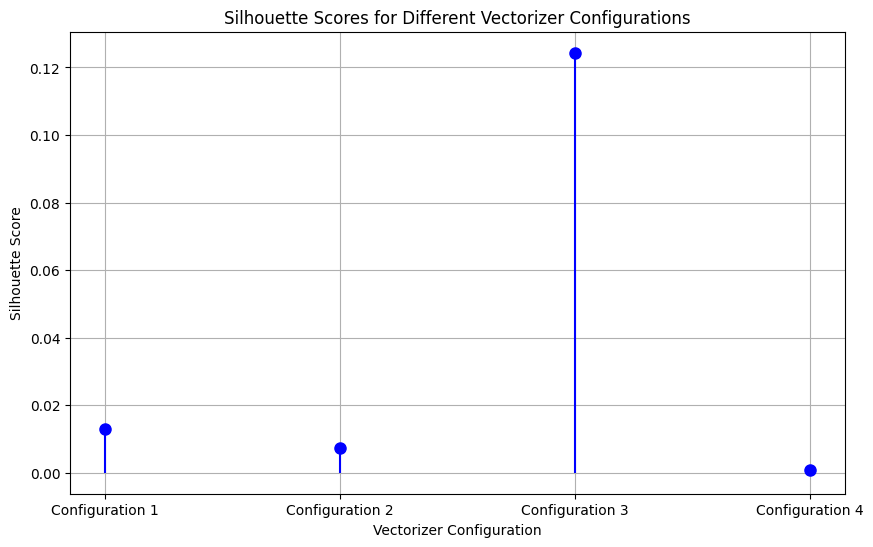

In [ ]:
scores = [score1, score2, score3, score4]
labels = ['Configuration 1', 'Configuration 2', 'Configuration 3', 'Configuration 4']

# Create a figure and axis
plt.figure(figsize=(10, 6))

# Plot lollipop chart
(markerline, stemlines, baseline) = plt.stem(labels, scores, basefmt=" ", linefmt='-b', markerfmt='ob')

plt.setp(markerline, marker='o', markersize=8, markerfacecolor='blue')
plt.setp(stemlines, linestyle='-', color='blue')

plt.xlabel('Vectorizer Configuration')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Scores for Different Vectorizer Configurations')
plt.grid(True)
plt.show()


### The best configuration:

In [ ]:
vectorizer_best = TfidfVectorizer(stop_words='english', min_df=1, max_df=5)
X_tfidf_best = vectorizer_best.fit_transform(combined_train_df['train_input'])

# Set up the LSA with the desired number of topics
unique_topics = combined_train_df['train_label'].unique()
n_topics = len(unique_topics)
lsa_best = TruncatedSVD(n_components=n_topics)

# Fit and transform the TF-IDF matrix with LSA
lsa_topic_matrix_best = lsa_best.fit_transform(X_tfidf_best)

print(lsa_topic_matrix_best.shape)  # Check the shape to ensure the reduction worked

(141, 141)


In [ ]:
# Step 1: Extract topic names
topic_names = list(unique_topics)  # Assuming unique_topics contains the topic names

# Step 2: Set document index to retrieve its topic distribution
doc_index = 0

# Step 3: Retrieve topic distribution for the specified document
topic_distribution = lsa_topic_matrix_best[doc_index]

# Step 4: Print header for the document
print(f"Document {doc_index} Topic Distribution:")

# Step 5: Iterate through topics and print their contributions with names
for i, contribution in enumerate(topic_distribution):
    topic_name = topic_names[i] if i < len(topic_names) else f"Topic {i}"  # Fallback for missing names
    print(f"{topic_name}: {contribution * 100:.2f}%")

Document 0 Topic Distribution:
Accelerator Physics: 10.41%
Adaptation and Optimization: -4.04%
Algebraic Combinatorics: 3.84%
Algebraic Geometry: -1.11%
Algebraic Topology: 4.61%
Analysis of PDEs: -10.05%
Applications: -5.73%
Applied Physics: -17.01%
Artificial Intelligence: 8.97%
Atmospheric and Climate Physics: -3.77%
Atomic Physics: -18.78%
Atomic and Molecular Physics: -7.67%
Audio and Speech: -3.38%
Audio and Speech Processing: 1.35%
Biological Physics: 5.78%
Biomolecules: 0.58%
Category Theory: -8.11%
Cell Behavior: 3.67%
Cellular and Granular: 10.38%
Chaotic Dynamics: 10.08%
Chemical Physics: -15.28%
Classical Physics: -12.93%
Combinatorics: -22.17%
Commutative Algebra: -4.81%
Complex Variables: 14.68%
Computation and Language: 8.94%
Computational Complexity: 3.56%
Computational Finance: -1.75%
Computational Geometry: -2.46%
Computational Physics: -9.52%
Computational Statistics: 24.09%
Computer Engineering: 1.49%
Computer Vision: -0.85%
Cosmology and Nongalactic Astrophysics: -

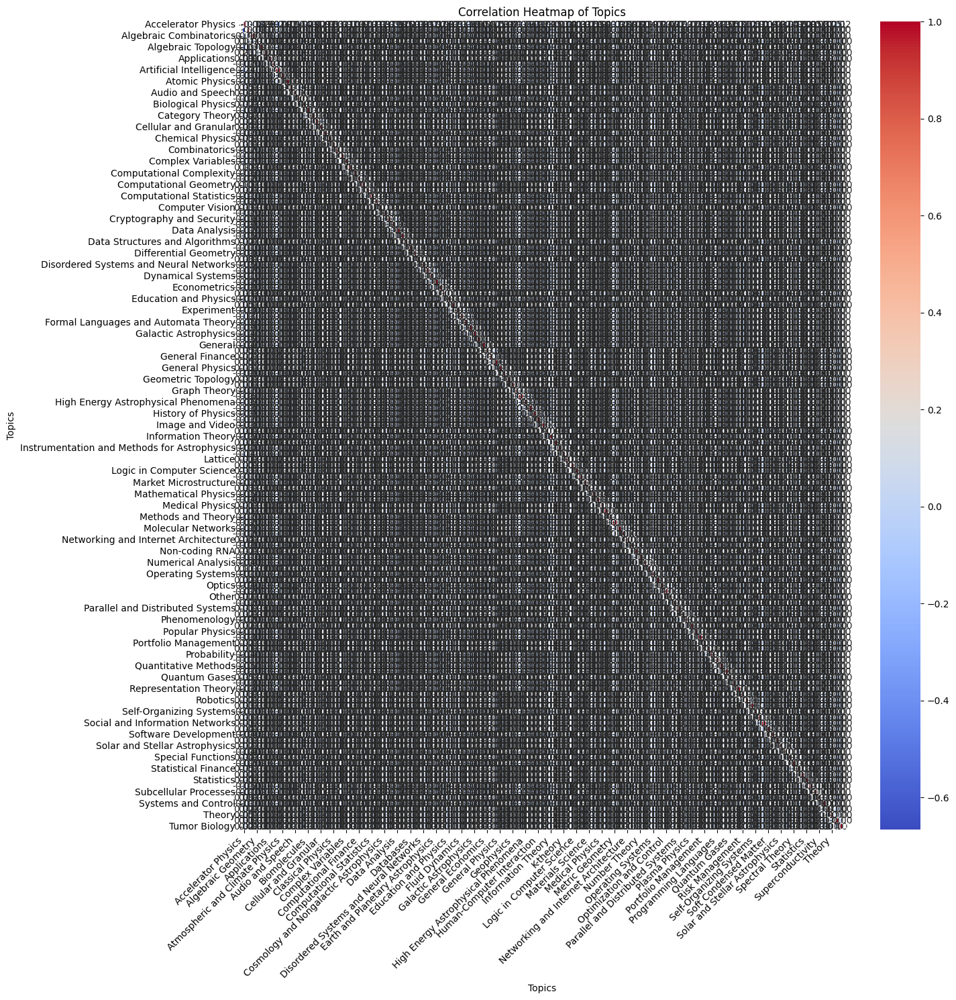

In [ ]:
topic_df = pd.DataFrame(lsa_topic_matrix_best, columns=topic_names)

# Step 2: Calculate the correlation matrix
correlation_matrix = topic_df.corr()

# Step 3: Plot the correlation heatmap
plt.figure(figsize=(15, 15))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.2)
plt.title("Correlation Heatmap of Topics")
plt.xlabel("Topics")
plt.ylabel("Topics")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

In [ ]:
print(clean_data)

                                                   Title  \
0                                   dynamic backtracking   
1      a market-oriented programming environment and ...   
2                an empirical analysis of search in gsat   
3      the difficulties of learning logic programs wi...   
4      software agents: completing patterns and const...   
...                                                  ...   
53119  over-measurement paradox: suspension of thermo...   
53120  comparison of open-source software for produci...   
53121  orderings of extremes among dependent extended...   
53122  phasetype distributions, autoregressive proces...   
53123  inherent difficulties of non-bayesian likeliho...   

                                                 Summary Primary Category  \
0      because of their occasional need to return to ...            cs.AI   
1      market price systems constitute a well-underst...            cs.AI   
2      we describe an extensive study of search 

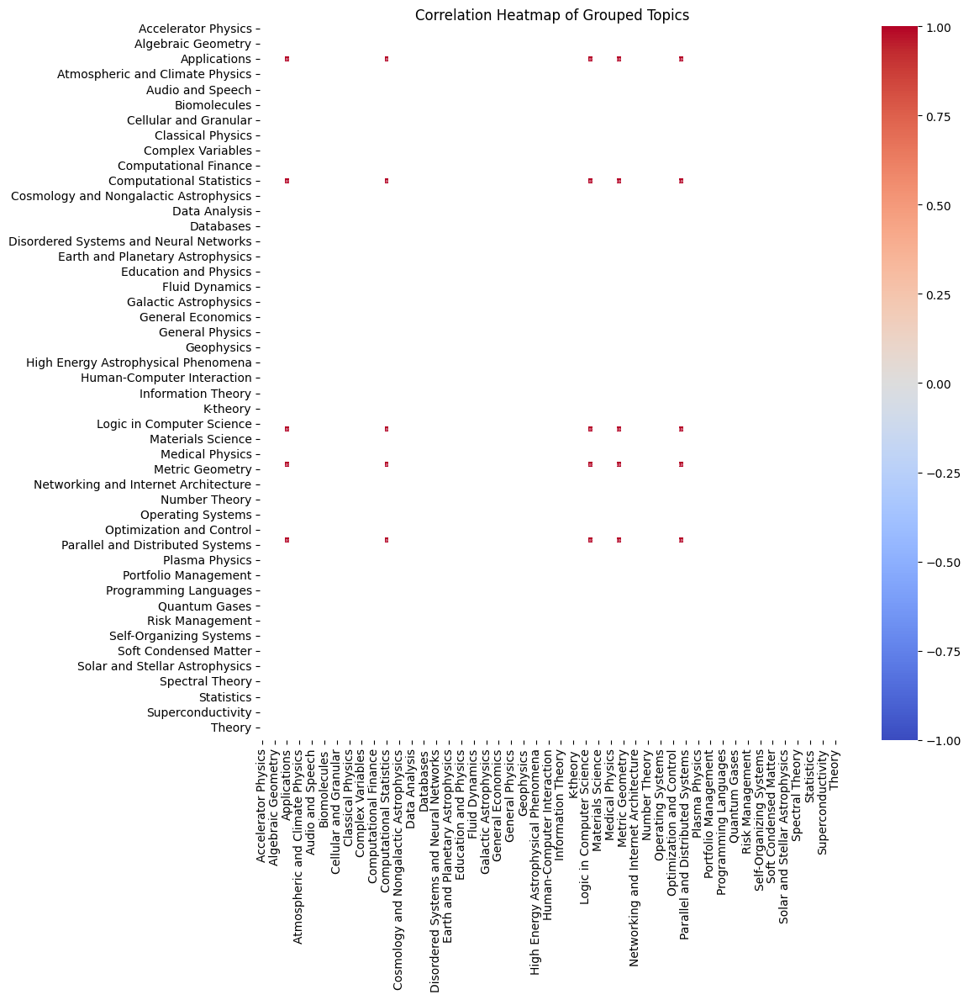

In [ ]:
# Step 1: Group by 'Detailed Category' and collect unique prefixes
grouped_categories = clean_data.groupby("Detailed Category")["Prefix"].apply(set).to_dict()

# Step 2: Ensure all topics exist in the topic DataFrame
# Remove any prefixes in grouped_categories that are not in topic_df columns
filtered_grouped_categories = {
    category: [topic for topic in topics if topic in topic_df.columns]
    for category, topics in grouped_categories.items()
}

# Step 3: Aggregate topic data for each detailed category
grouped_data = {category: topic_df[topics].mean(axis=1) for category, topics in filtered_grouped_categories.items()}
grouped_df = pd.DataFrame(grouped_data)

# Step 4: Calculate the correlation matrix for grouped categories
grouped_correlation_matrix = grouped_df.corr()

# Step 5: Plot the heatmap
plt.figure(figsize=(12, 12))
sns.heatmap(grouped_correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f",linewidths=0, annot_kws={"size": 3}, vmin=-1, vmax=1)
plt.title("Correlation Heatmap of Grouped Topics")
plt.tight_layout()
plt.show()


Topic #0:
Top terms: lookback, flatter, capm, unbinding, supermassive, arcmin, calibrators, ngc, msun, redden, gasoline, balmer, exogenously, outflows, emt



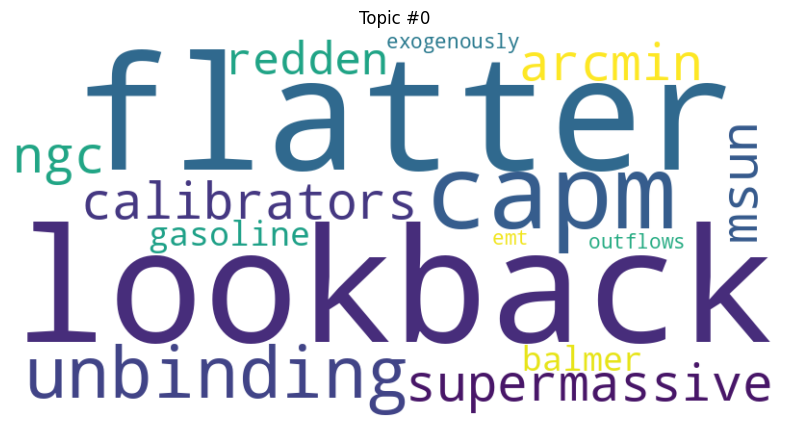

Topic #1:
Top terms: operad, bordism, coproduct, operads, comodule, nilpotence, homotopies, chevalley, hirzebruch, kähler, motivic, beilinson, abelianization, kostant, twisting



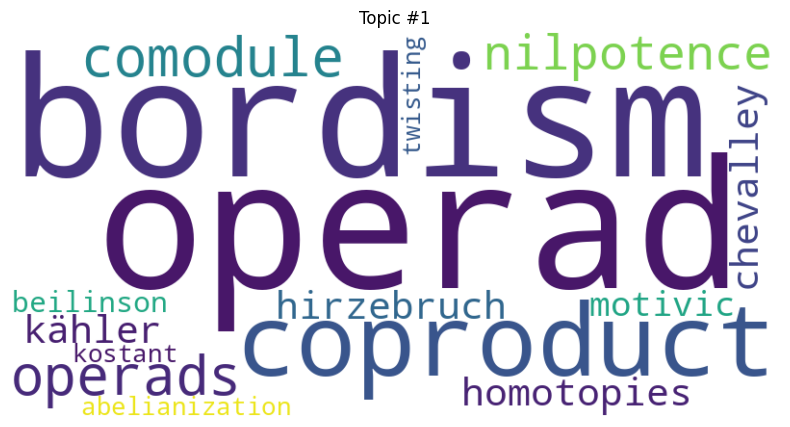

Topic #2:
Top terms: redden, msun, ngc, supermassive, arcmin, calibrators, balmer, magnetorotational, circumstellar, agn, ukirt, mmt, subaru, photospheric, ejecta



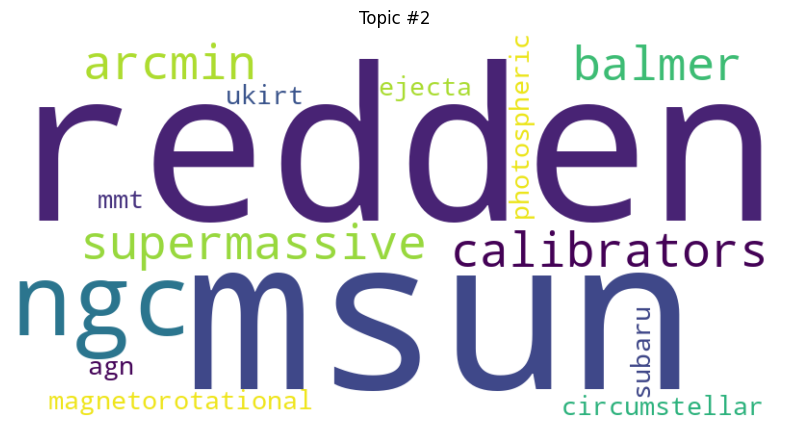

Topic #3:
Top terms: vasicek, drawdowns, numeraire, otc, tenor, solvency, counterparties, moneyness, exogenously, dupire, lookback, cva, dva, repo, fernholz



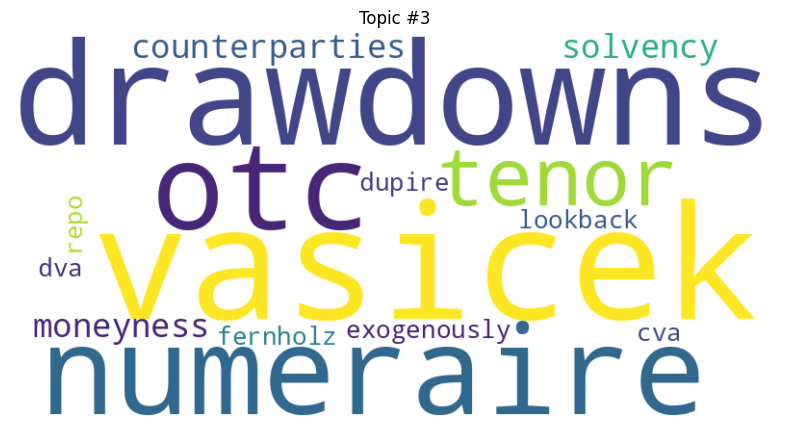

Topic #4:
Top terms: vasicek, otc, tenor, drawdowns, dupire, numeraire, cva, dva, kjaer, solvency, moneyness, counterparties, polaronic, ema, fbsdes



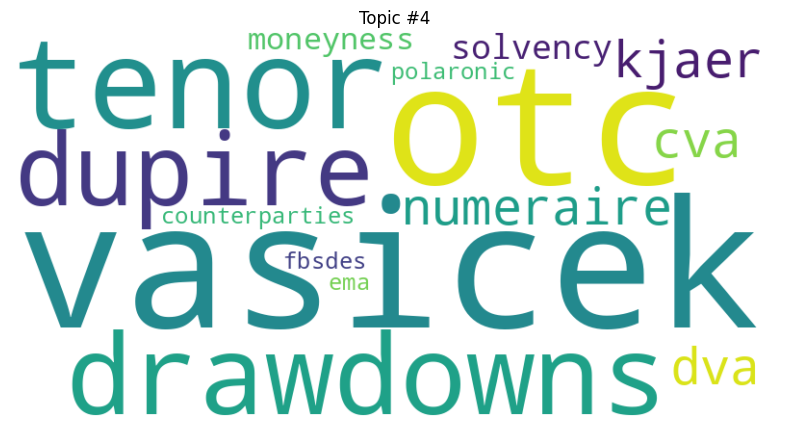

Topic #5:
Top terms: vasicek, drawdowns, otc, tenor, numeraire, dupire, lookback, cva, dva, capm, counterparties, solvency, fbsdes, fbsde, fernholz



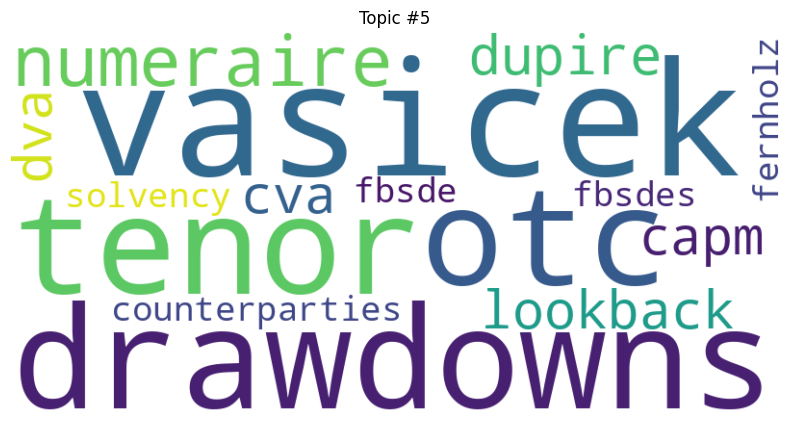

Topic #6:
Top terms: duopoly, curb, jel, taxation, cournot, litigation, rawls, shipping, hungary, privatization, consultant, fdi, keynesian, households, gasoline



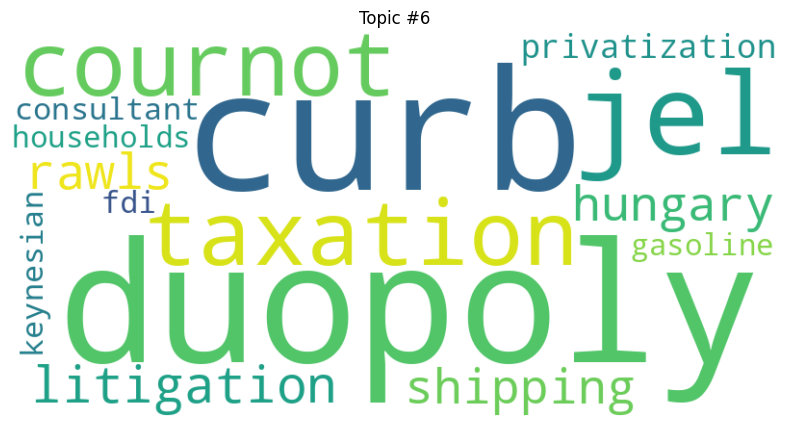

Topic #7:
Top terms: treewidth, succinctness, exptime, palindrome, spielman, recognizability, valiant, sequentiality, equicontinuity, emptiness, subshift, csps, chomsky, parikh, henzinger



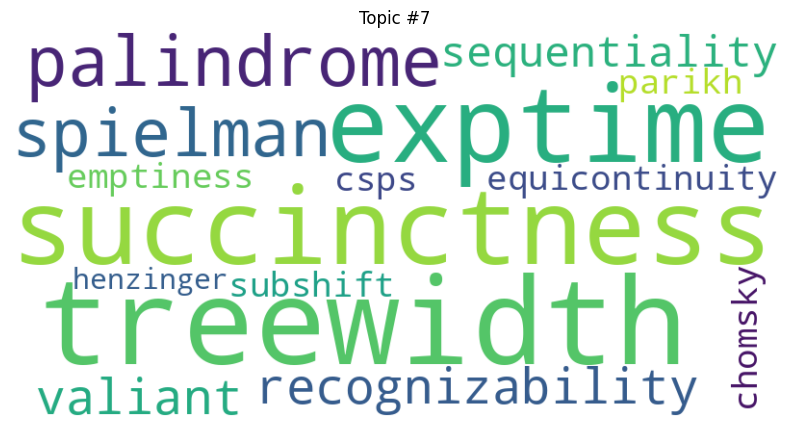

Topic #8:
Top terms: regge, quarks, multiparticle, pseudoscalar, pomeron, electroweak, leptonic, gluonic, maskawa, callan, multiplets, bjorken, nubar, γγ, partonic



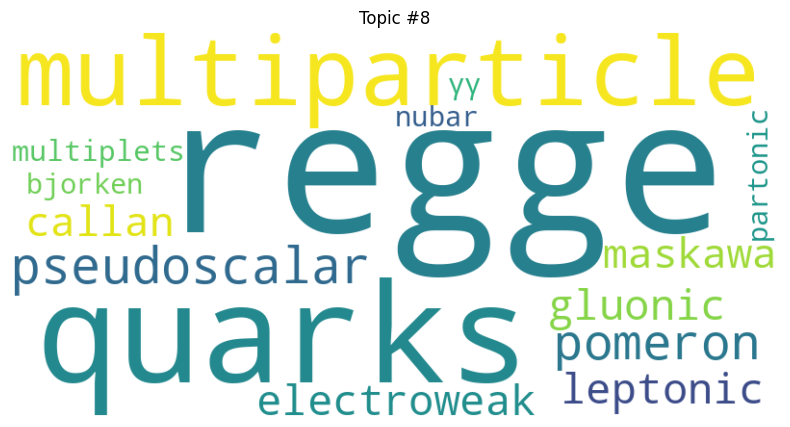

Topic #9:
Top terms: microlocal, zygmund, bourgain, christoffel, davey, szeg, vishik, yamabe, miura, treves, acklund, bmo, foias, umbilic, hitchin



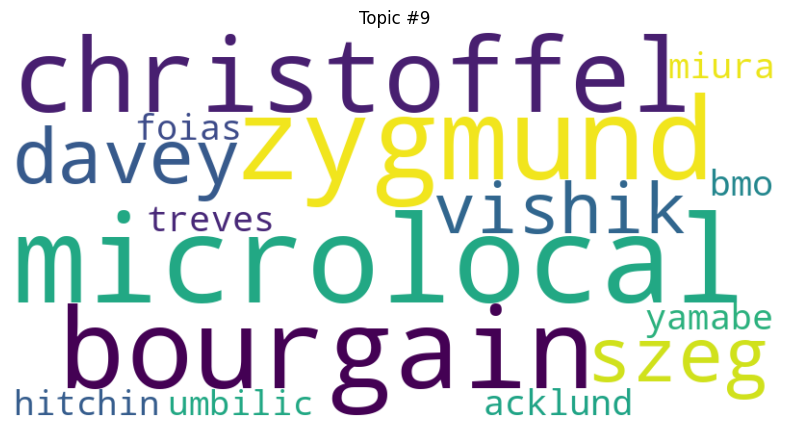

Topic #10:
Top terms: subbands, prosody, mfcc, codec, resnet, codecs, cepstral, asr, talker, utterances, wsj, mandarin, prosodic, audiovisual, dmrg



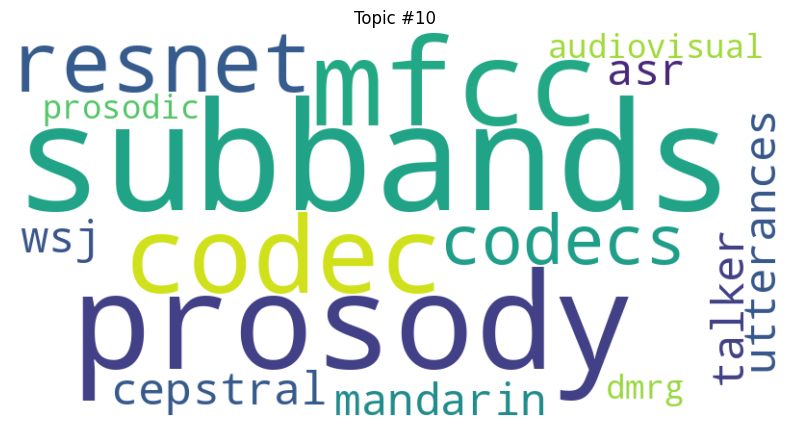

Topic #11:
Top terms: dram, nvm, writes, overheads, xen, evict, wcet, multicores, noc, gpgpus, filesystem, crossbar, vco, traversed, manycore



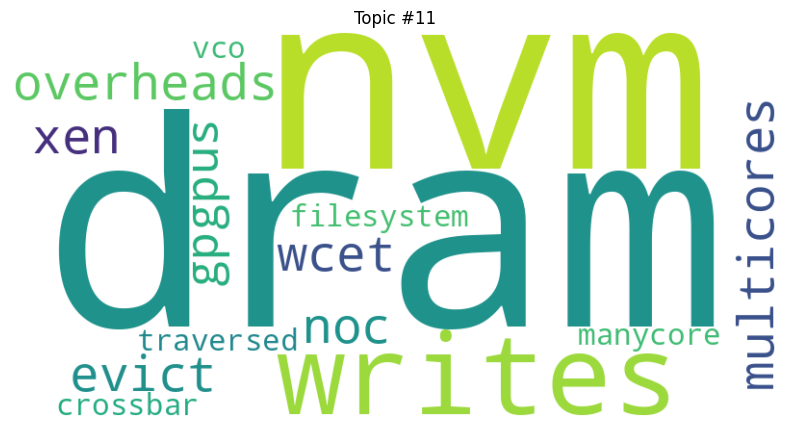

Topic #12:
Top terms: statist, clt, fdr, huber, minorization, subsampling, ignorability, tweedie, npmle, omnibus, biostatistics, estimable, changepoint, jackknife, saem



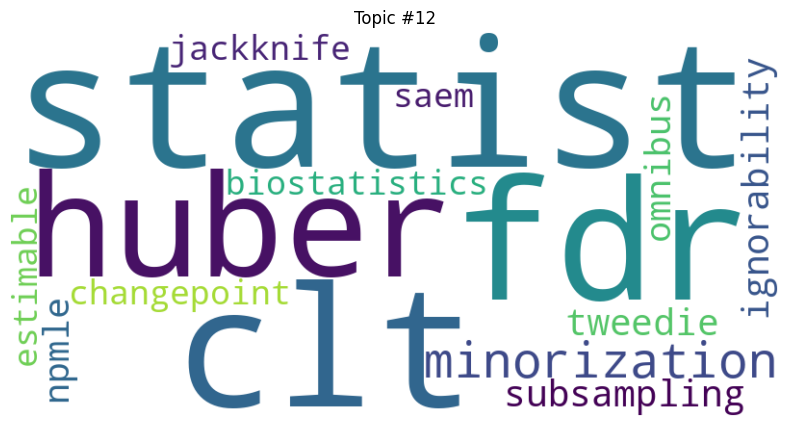

Topic #13:
Top terms: statist, biostatistics, shewhart, rosenthal, subsampling, implementational, gelman, markoff, lindley, efron, rejoinder, rubin, overdispersion, veronese, saem



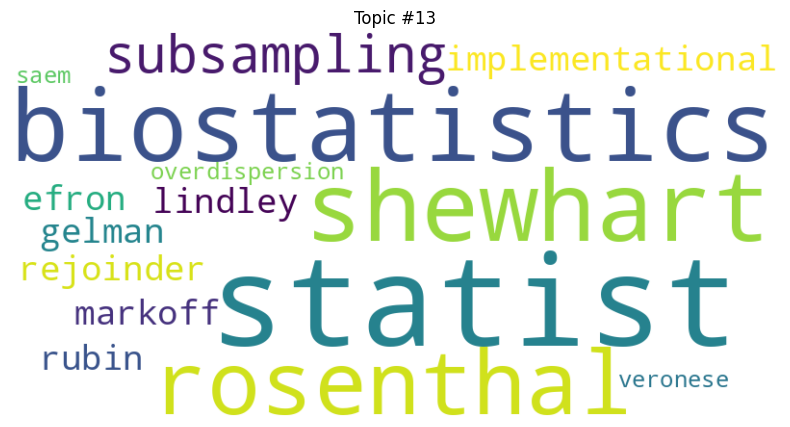

Topic #14:
Top terms: rudin, milman, compactum, szeg, reilly, nio, tesselation, tauberian, lindelof, valent, mcmillan, polaronic, talagrand, alexandrov, effros



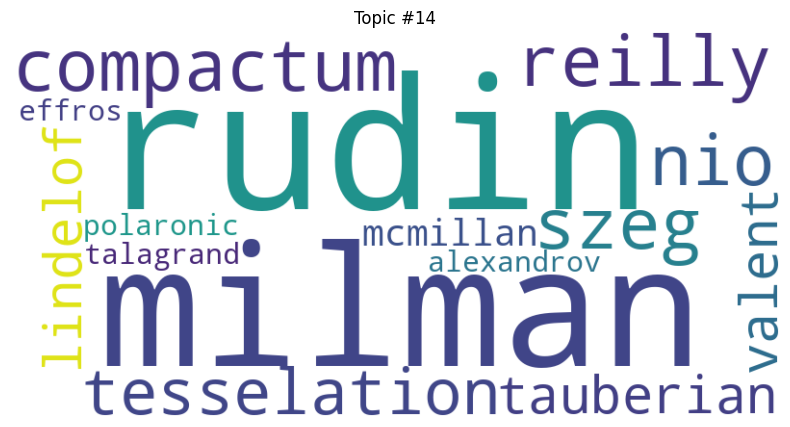

Topic #15:
Top terms: minorization, autoionization, muonic, photoabsorption, tweedie, beryllium, subsampling, statist, gmms, caesium, deuteron, intershell, muonium, estimable, tdse



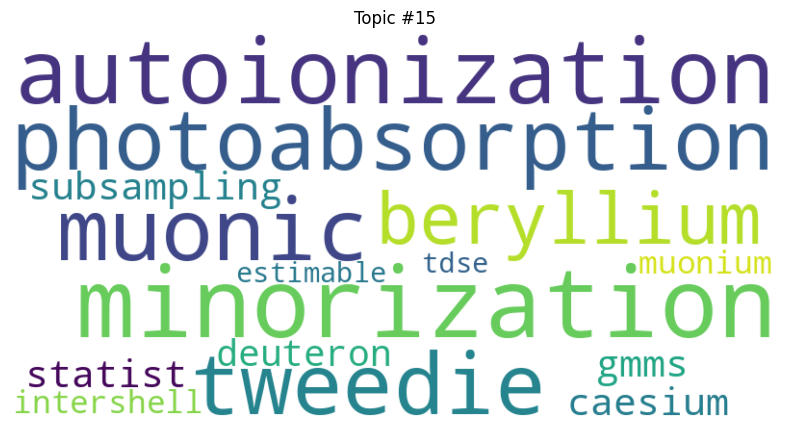

Topic #16:
Top terms: autoionization, beryllium, yangian, intershell, formules, efimov, superalgebras, superoperator, autoionizing, tdse, lmm, isomer, phenol, sublevels, intrashell



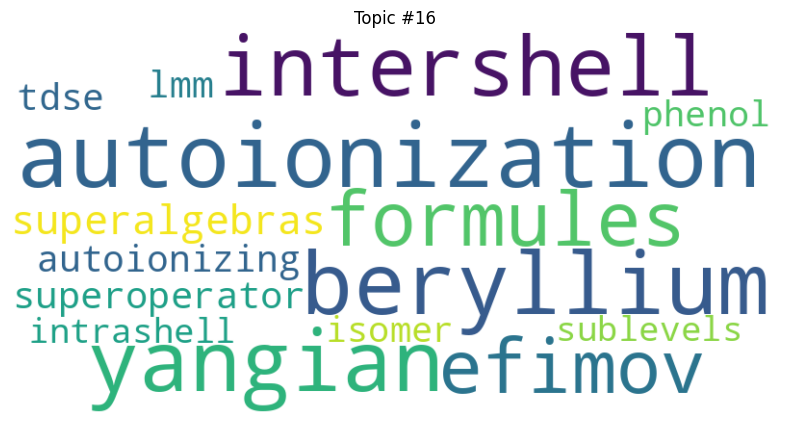

Topic #17:
Top terms: bordism, pontrjagin, reidemeister, pant, sternberg, emb, kaehler, apx, teichmüller, teichm, reeb, seiberg, homotopies, teleman, tangency



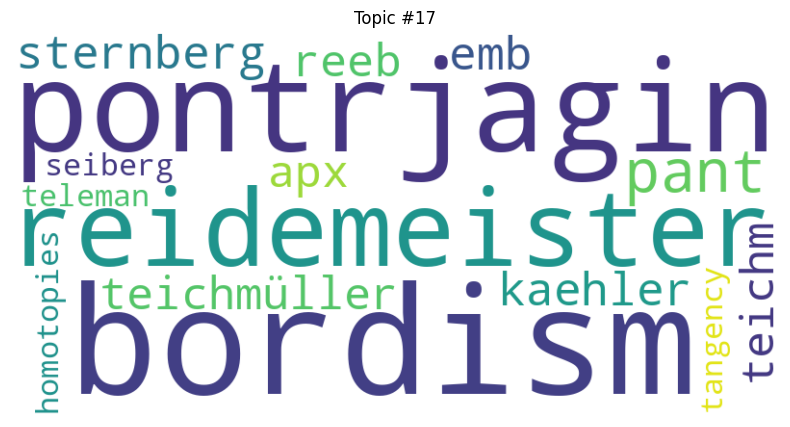

Topic #18:
Top terms: lehmann, chaplygin, lichnerowicz, bihamiltonian, floer, metatheory, clausal, subgoals, nonemptiness, kripke, interfaces, entailment, yangian, exptime, hyperk



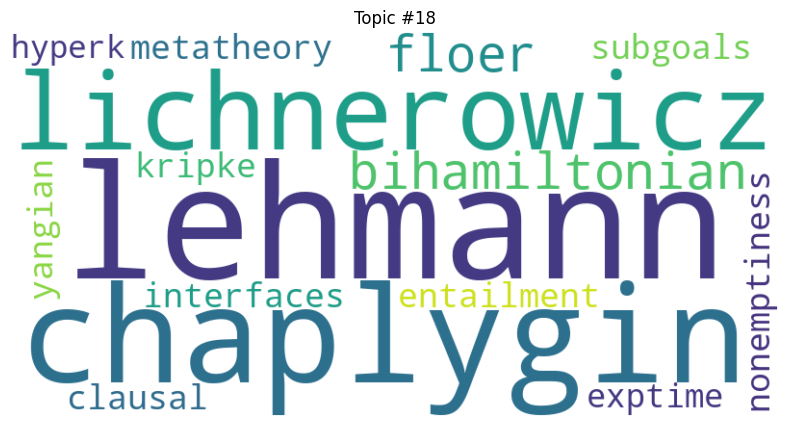

Topic #19:
Top terms: ytterbium, hydrogenic, hua, perceptible, edm, lying, benard, untrapped, sublevels, dicke, efimov, intrashell, lau, cummings, husimi



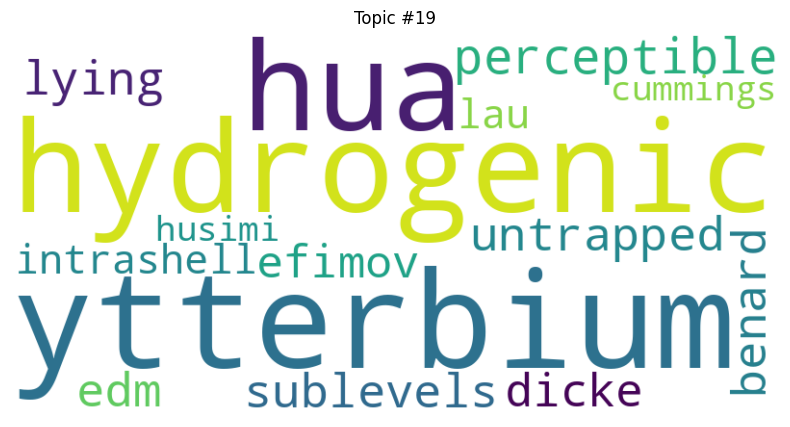

Topic #20:
Top terms: grayscale, hue, prohibits, micelle, saliency, phospholipid, morphologic, viscoelasticity, colorise, subregions, ezier, crumple, excluded, fused, octree



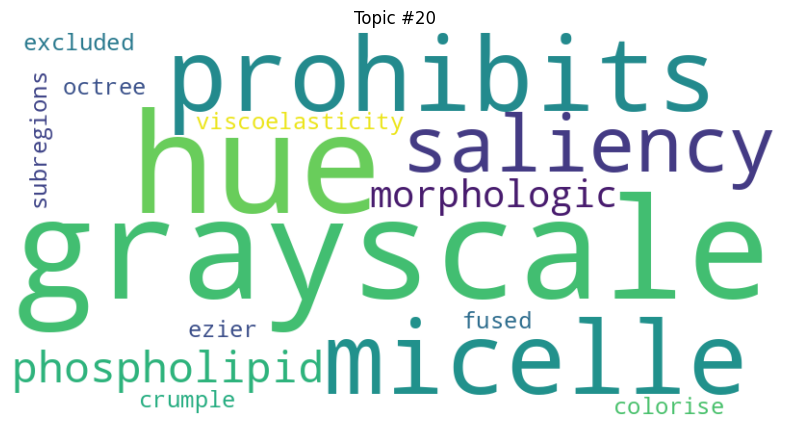

Topic #21:
Top terms: memristor, memristors, kauffman, memristive, fredkin, toffoli, cyclist, hyperspace, leech, xnor, dendrite, biosensor, talagrand, zhabotinsky, belousov



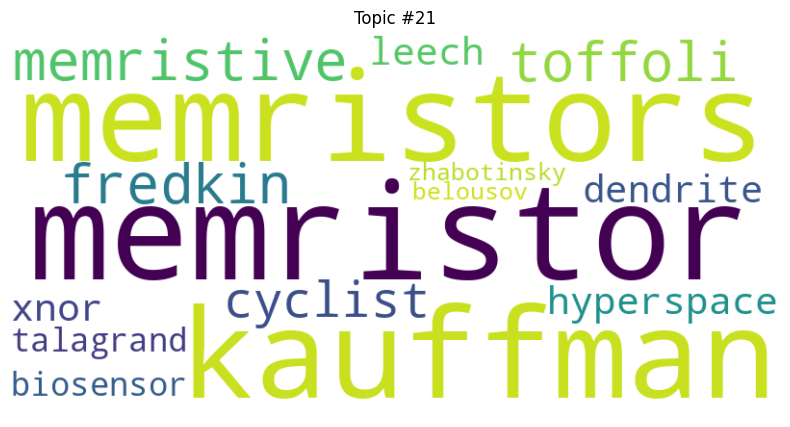

Topic #22:
Top terms: diabatic, beryllium, efimov, zener, autoionization, sublevels, lmm, intershell, tdse, autoionizing, muonium, photoabsorption, intrashell, feshbach, vibronic



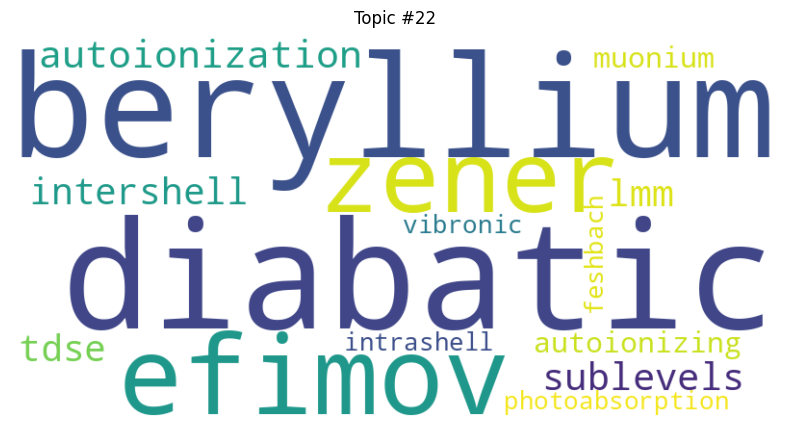

Topic #23:
Top terms: zener, untrapped, hydrogenic, hua, zermelo, tanh, efimov, husimi, lying, dicke, positronium, antiparticle, sturmian, feshbach, hermiticity



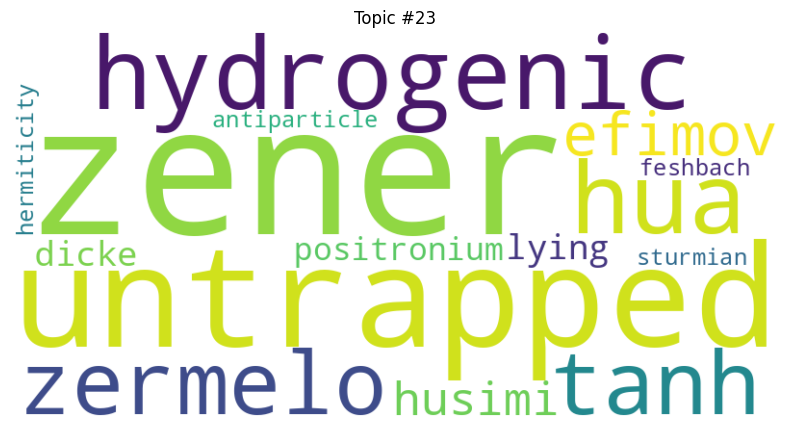

Topic #24:
Top terms: intertwiners, harish, subfactor, kashiwara, osp, feigin, lace, yangian, effros, wyner, braided, soit, ol, rudin, continous



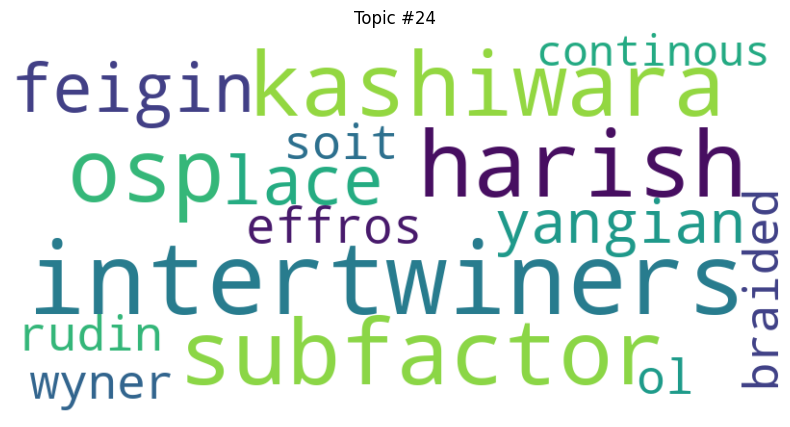

Topic #25:
Top terms: underactuated, lmi, backstepping, gyroscopically, hooke, animated, ol, strategical, pmp, aerodynamics, wardrop, stealth, pursuer, kannan, matricial



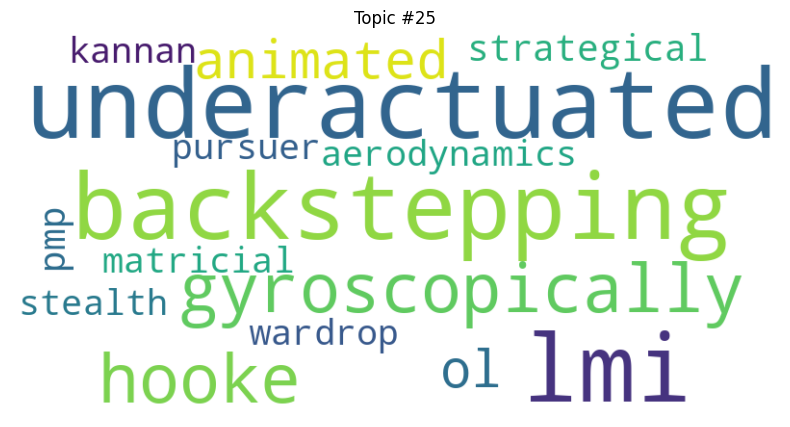

Topic #26:
Top terms: carleman, tustin, blowup, lqg, awgn, segre, backstepping, underactuated, krasovskii, wheeled, pendubot, gramian, brunovsky, trailer, maneuverability



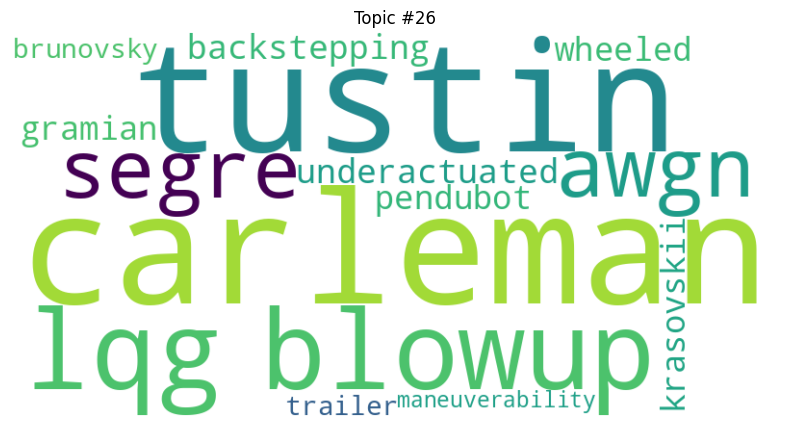

Topic #27:
Top terms: quartette, juhasz, compacta, bigcap, hua, hydrogenic, efimov, sack, absoluteness, nyikos, ech, subcontinua, cichon, diamondsuit, supercompactness



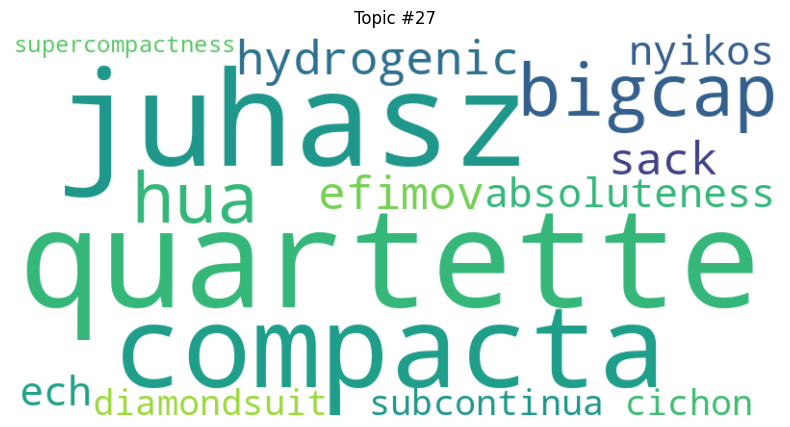

Topic #28:
Top terms: uwb, nonzeros, passband, precoding, lut, gsp, codewords, gpp, lz, precoded, papr, precoders, lmmse, mpsk, ldgm



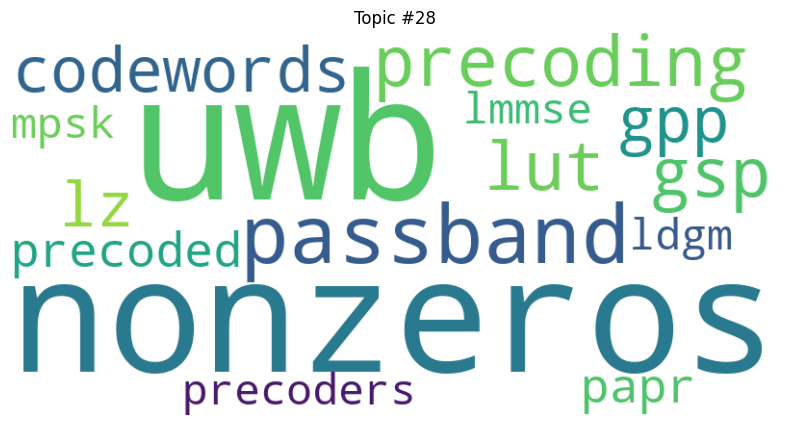

Topic #29:
Top terms: metronome, insult, indifferent, cerebellum, hippocampus, electrophysiology, tonic, rumor, epilepsy, edg, desynchronization, extensor, tbi, transferring, somatosensory



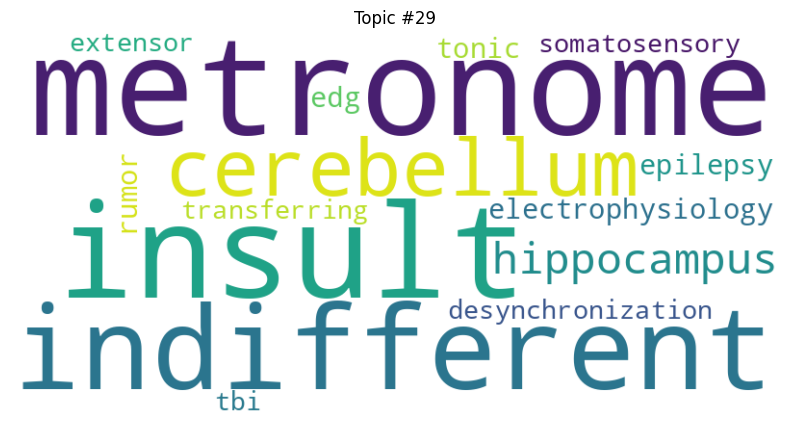

Topic #30:
Top terms: kauffman, weinberger, overlapping, recreational, leonhard, gardner, simplexes, tubing, paragraph, smarandache, rightmost, leftmost, ibs, collatz, knudsen



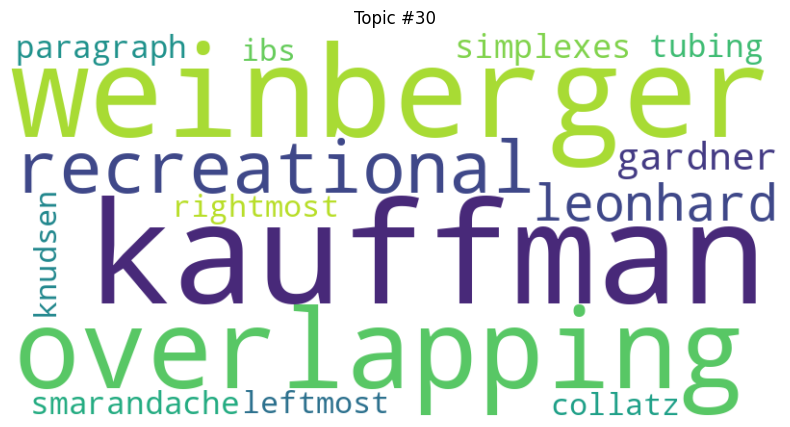

Topic #31:
Top terms: ctrw, subprime, tse, multiscaling, breakpoints, seasonalities, bacry, topix, jpy, cac, monday, nearness, diesel, seng, darling



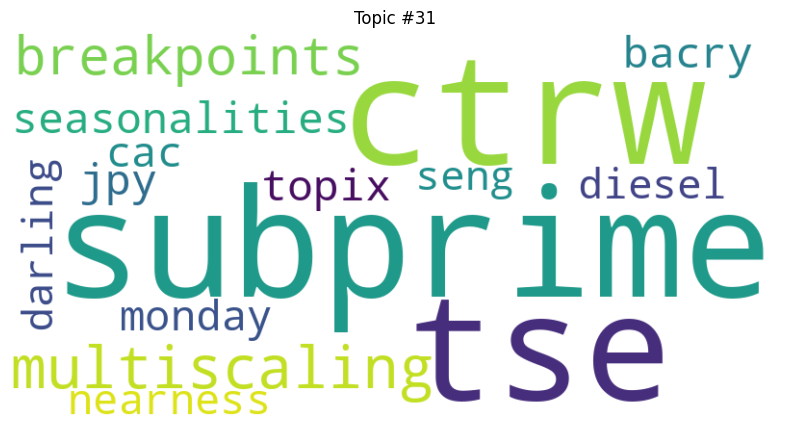

Topic #32:
Top terms: preimages, preimage, noninvertible, ahlfors, gevrey, neuman, residually, removable, orlicz, denjoy, holomorphically, lattes, forstneric, hironaka, pluripolar



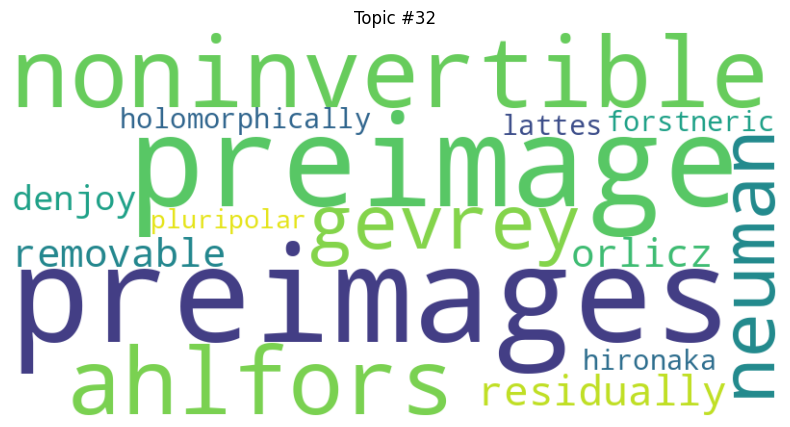

Topic #33:
Top terms: rohlin, anosov, blaschke, disambiguation, pgl, checked, residually, breaker, lau, tangency, horseshoe, obstruct, continous, marden, mcmullen



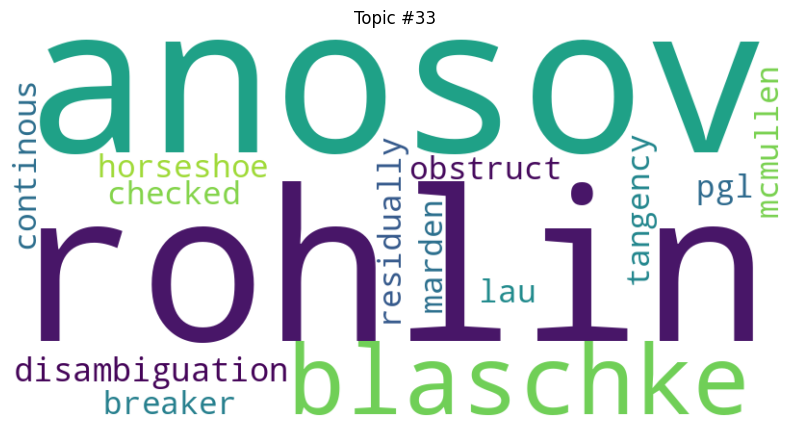

Topic #34:
Top terms: executed, collins, amortization, assessing, lehman, motivational, reflexivity, sharpest, jp, proving, noindent, bonnet, vegas, cyclist, wiedemann



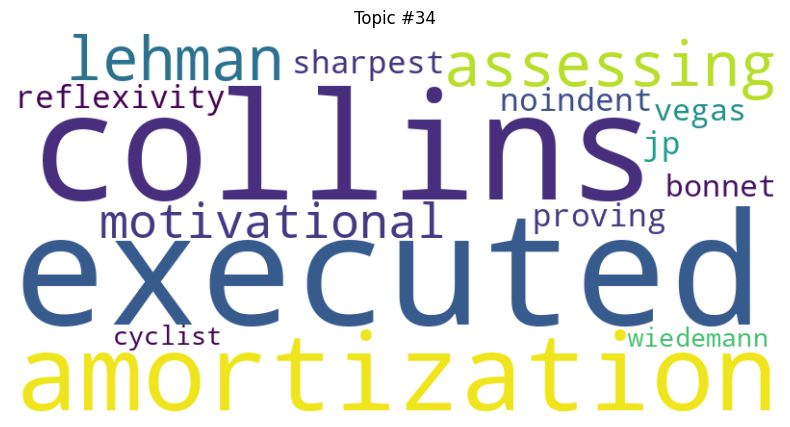

Topic #35:
Top terms: contented, anosov, commensurable, irr, locaux, quasigroups, shpilrain, quasigroup, dehornoy, algorithme, ivanov, compactifying, nil, aussi, metabelian



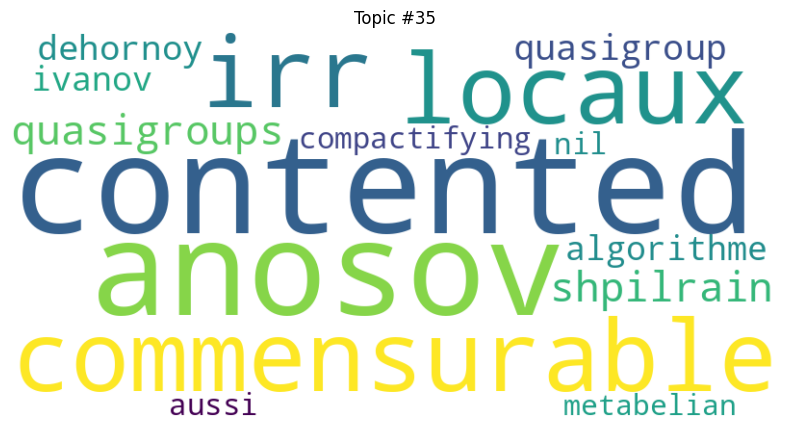

Topic #36:
Top terms: singularities, speiser, segre, cech, bigoplus, biholomorphic, extremality, douady, scarf, continous, nowicki, gorenstein, bihomogeneous, qft, xn



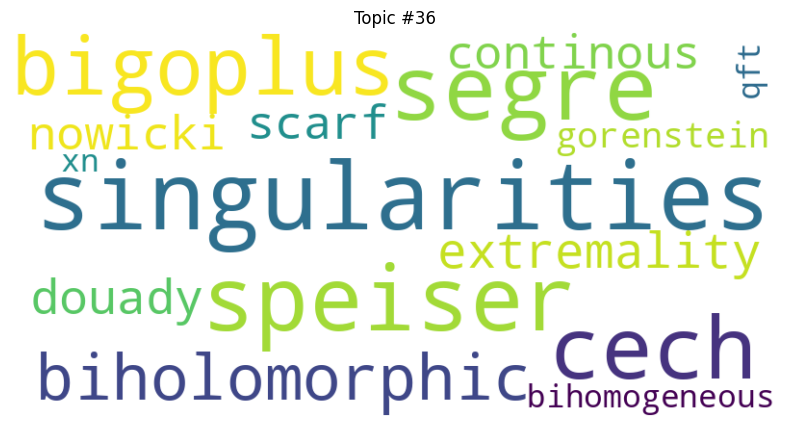

Topic #37:
Top terms: executed, held, citeseer, madrid, shenzhen, méthode, edm, lehman, bhp, acd, topix, seasonalities, jpy, bacry, twodimensional



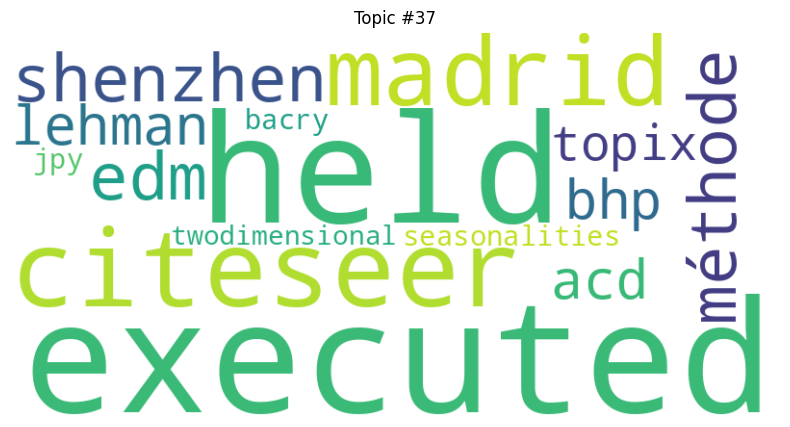

Topic #38:
Top terms: semiquantitative, unsymmetrical, almeida, cessation, transistion, rapoport, haplotype, uniformization, monatomic, diploid, clade, preempt, nadler, petersson, deforestation



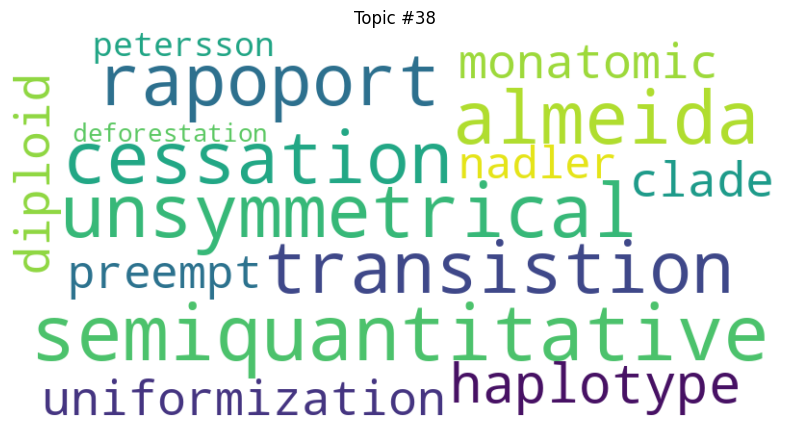

Topic #39:
Top terms: simmetry, postscript, plaquettes, thermoremanent, nonergodic, rigourous, meissner, bielefeld, remanent, jonsson, residually, diagramatic, glassful, gibbsian, theories



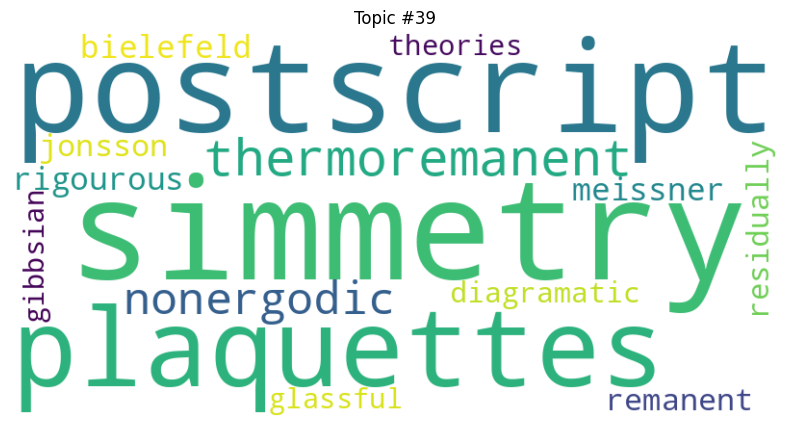

Topic #40:
Top terms: fci, nitride, limiter, tortuosity, bgk, magnetron, newcomb, weibel, nonextensivity, plasmas, marching, sonoluminescence, ponderomotive, kmc, butt



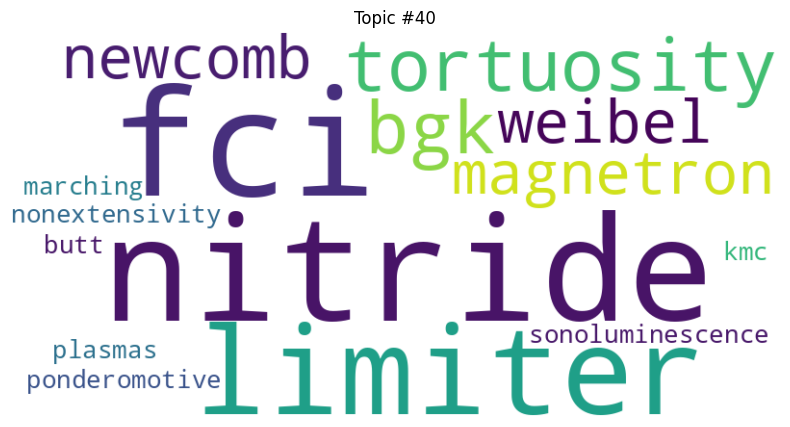

Topic #41:
Top terms: hoare, removable, wilf, nonoscillatory, xt, terminating, zeilberger, guy, kirkpatrick, krawtchouk, chudnovsky, sherrington, carleson, tragic, supposes



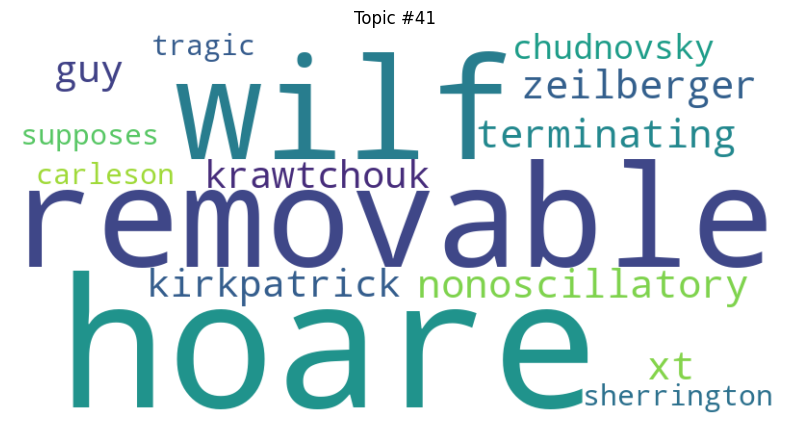

Topic #42:
Top terms: kadanoff, dia, ter, plaquettes, cont, glassful, untrapped, systematization, hotelling, newcomb, hardcore, metaheuristics, meissner, comonotonicity, realized



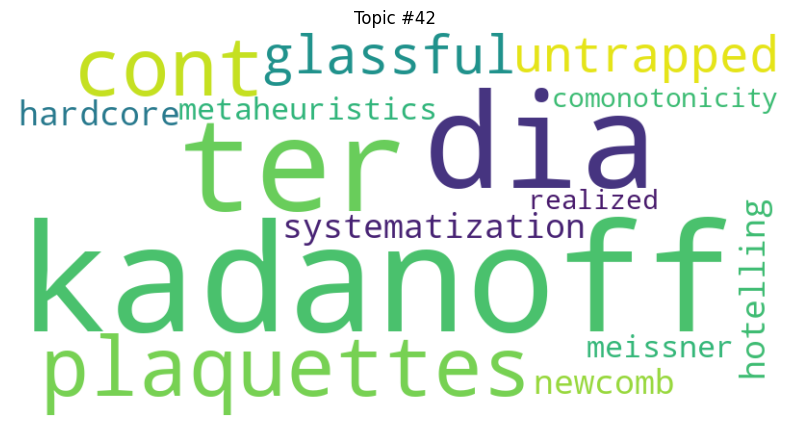

Topic #43:
Top terms: lls, nonincreasing, kramer, magnetoplasma, diamagnetism, helicon, activeness, loi, capacitively, almeida, quasibound, wiedemann, grandcanonical, forever, tanaka



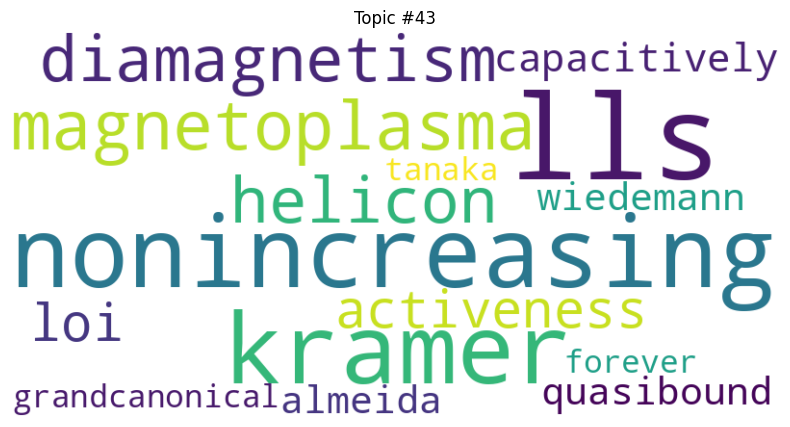

Topic #44:
Top terms: camouflage, seasonalities, topix, jpy, bacry, ug, rumor, evader, lehman, misrepresent, cac, cooperator, martingales, vd, pursuer



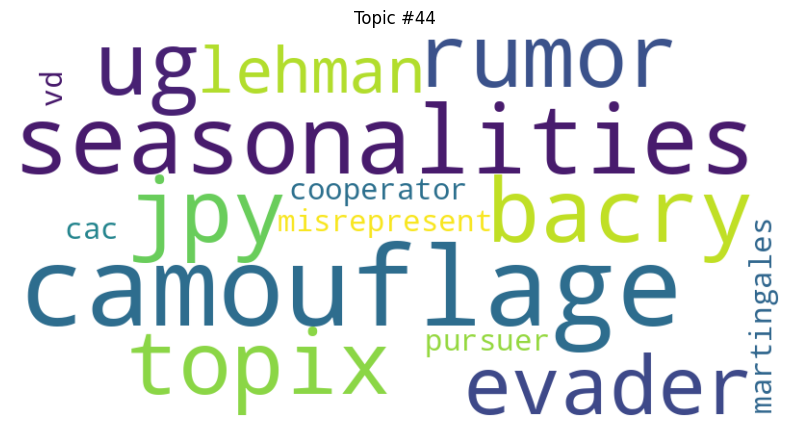

Topic #45:
Top terms: meanfield, arrived, tubing, rightmost, leftmost, braking, main, walkway, diam, demostrated, surjectivity, codification, gol, kung, uncomplicated



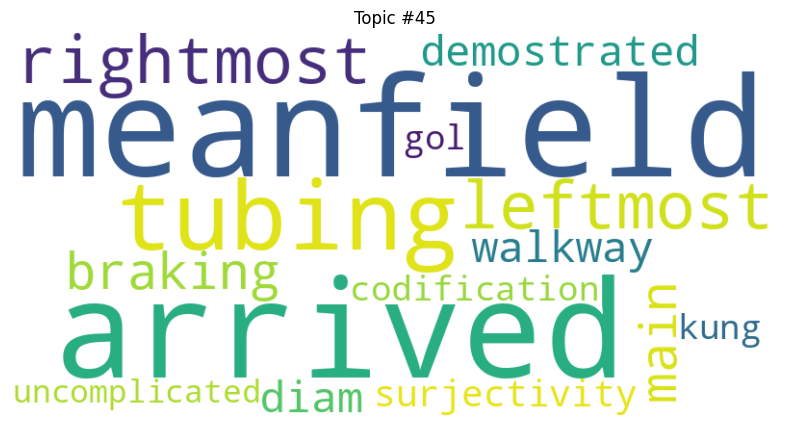

Topic #46:
Top terms: dicke, duke, qq, xxz, newcomb, ckm, pearce, algoritm, theories, meissner, tanh, tive, sato, hyperscaling, microcanonical



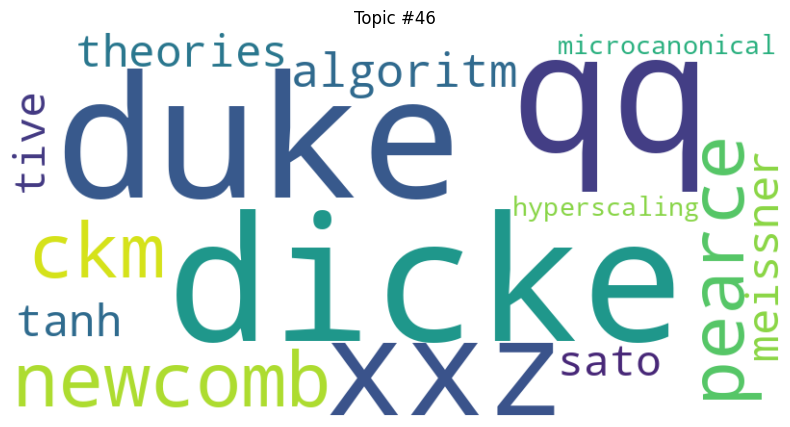

Topic #47:
Top terms: painlev, nagel, schreckenberg, regularise, asynchronicity, dsi, thermostatistics, derrida, ov, rca, throb, shaft, spaceship, economize, tragic



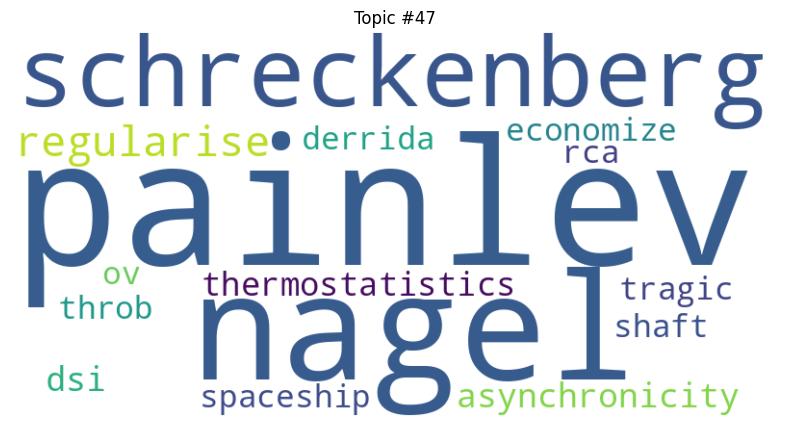

Topic #48:
Top terms: multispecies, decryption, plaintext, surjectivity, vanishingly, parliamentary, diam, tse, spectacularly, kung, manipulability, aca, lifted, pacman, jim



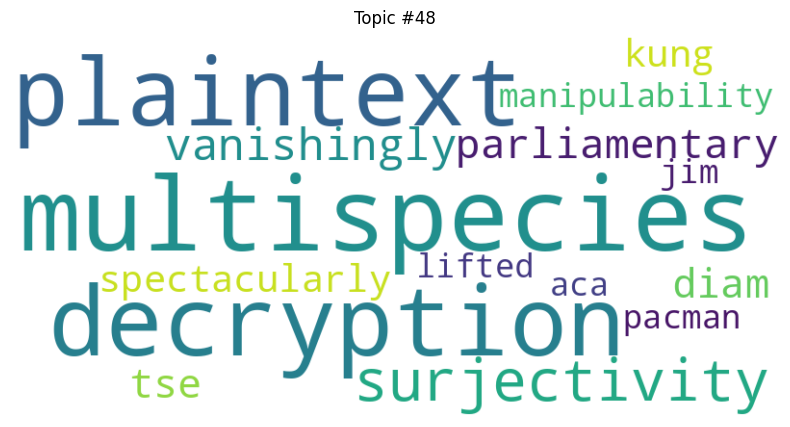

Topic #49:
Top terms: pomdps, vaguely, automatisation, punish, subnetworks, handover, wordnet, dsmt, oscar, seam, iraq, construe, intransitive, hurt, roadway



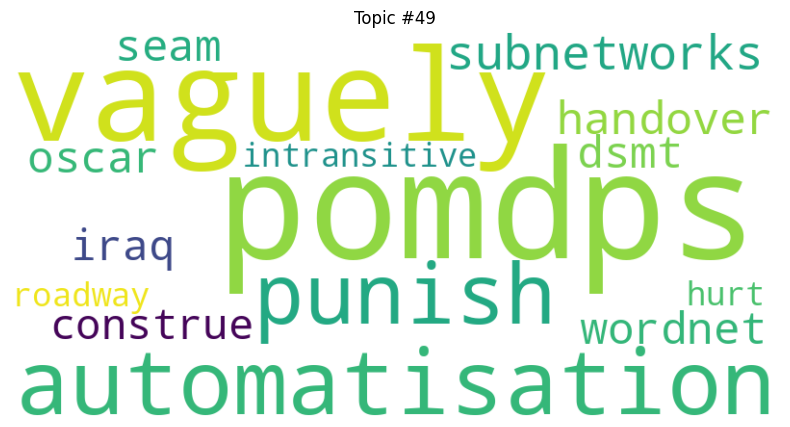

Topic #50:
Top terms: cgs, zorn, integrally, vacuously, bhattacharya, wrt, nowicki, zd, yoshida, schoutens, levin, moss, schensted, anosov, vandermonde



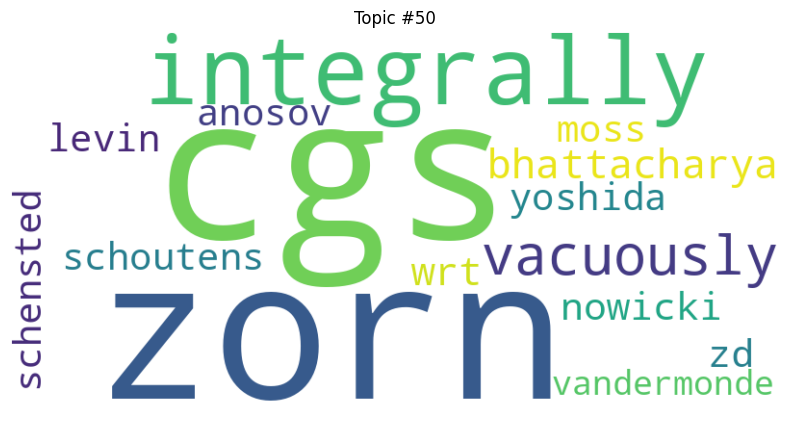

Topic #51:
Top terms: migdal, bounds, glassful, caesium, onsite, keldysh, intersite, transferability, rigourous, simmetry, ug, kjaer, huse, cargese, experiential



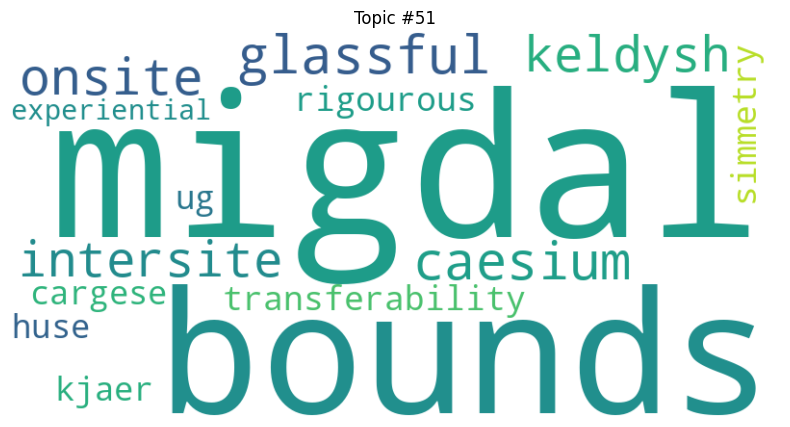

Topic #52:
Top terms: engel, residually, centralizers, treves, plotted, preimages, nonsolvable, narasimhan, levermore, parabolically, yy, tranversal, eigenequation, circumscribe, transversals



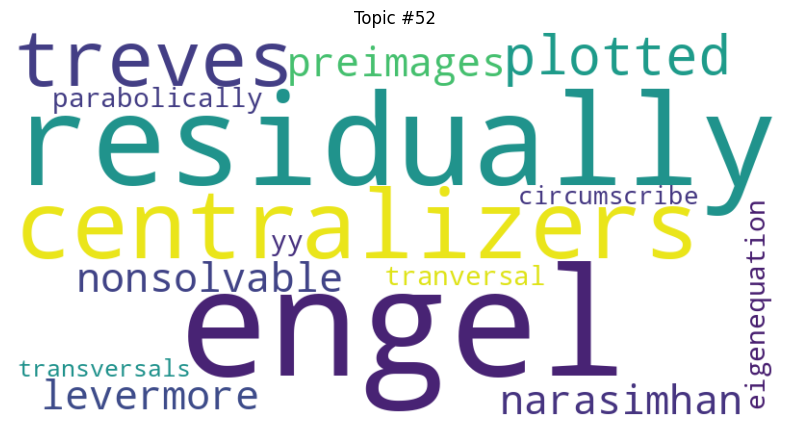

Topic #53:
Top terms: kozlov, lipschitzian, bouchaud, oleinik, sublevel, translated, detrending, dist, robustifying, halton, cointegrating, frenet, multiscaling, walkway, saloff



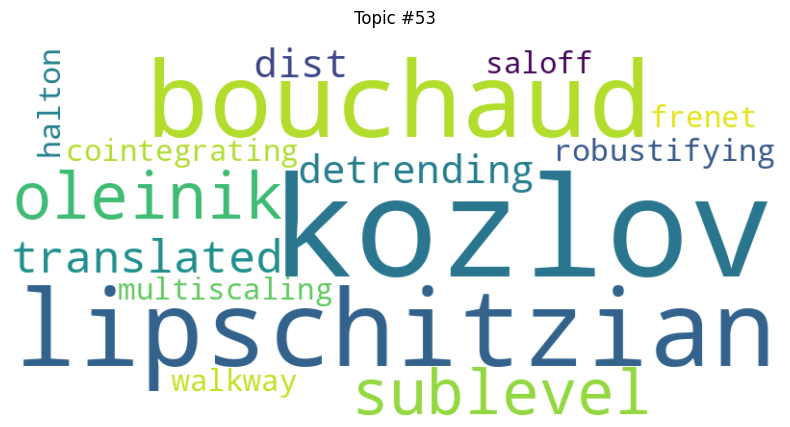

Topic #54:
Top terms: mentioned, suzuki, untrapped, muonium, bigl, bigr, transistion, lisp, feldman, extensions, lau, bigoplus, vicsek, fredholmness, closable



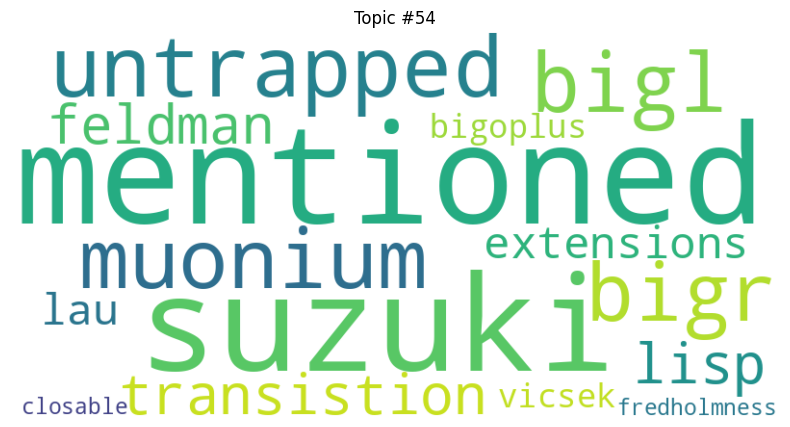

Topic #55:
Top terms: sesquilinear, wronskian, cuspidal, sarnak, coates, fannie, petersson, fekete, sgn, diaz, toral, eigenforms, parametrizes, fq, ash



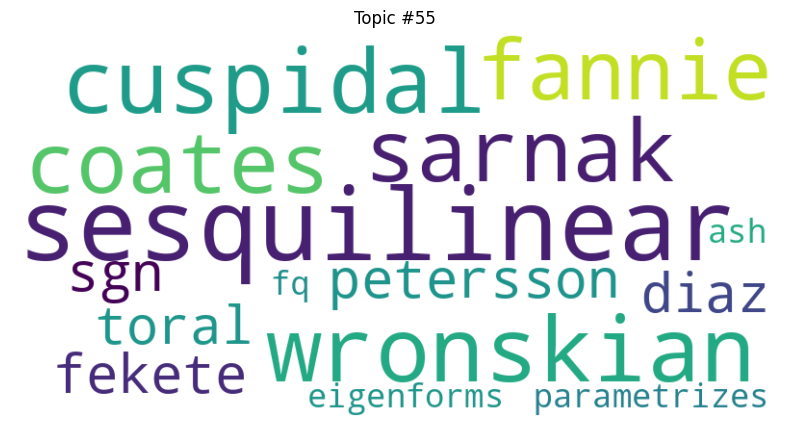

Topic #56:
Top terms: statisticians, exponents, isentropic, nonreversible, kozlov, lipschitzian, gue, buck, nonintegrable, tanaka, forever, johansson, lcr, strategical, bbbz



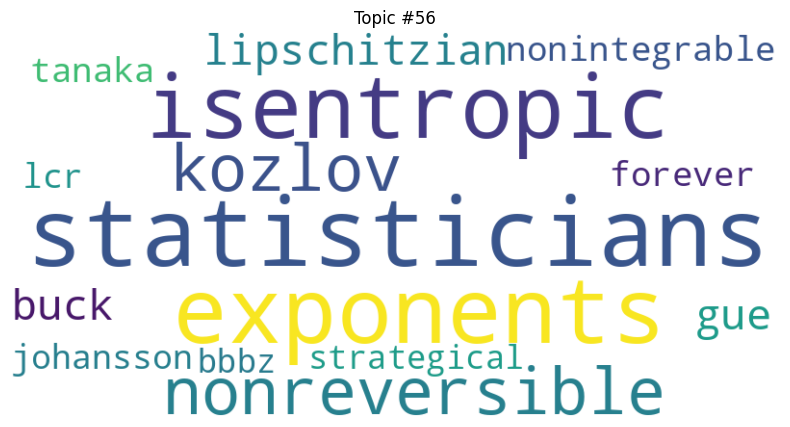

Topic #57:
Top terms: pitaevskii, feshbach, blowup, bkt, rotates, modulated, efimov, distinguished, zener, microcavity, kimball, bulgac, petrov, hawking, proximate



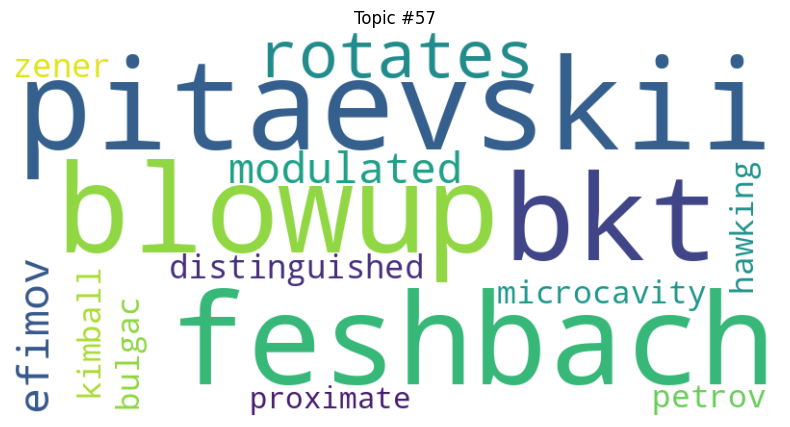

Topic #58:
Top terms: preconditioned, semidefiniteness, francis, layouts, memorization, plateful, protects, polylog, plentiful, wavy, nlog, deflate, ply, rv, polylogarithms



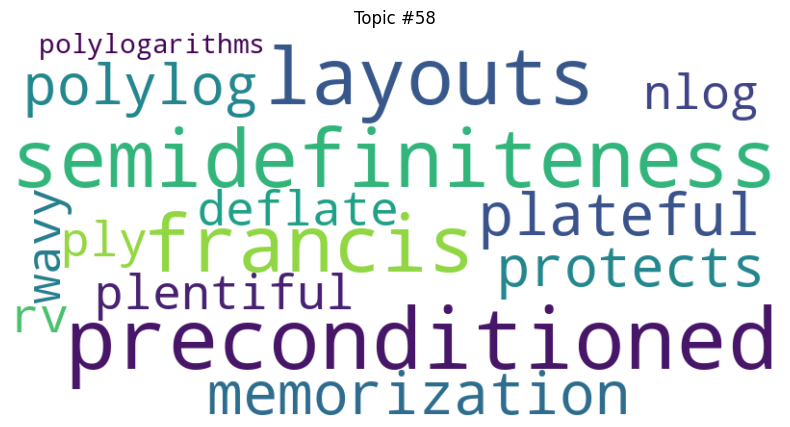

Topic #59:
Top terms: selfsimilar, lamplighter, gonzalez, sech, crush, defacto, dint, insider, ordination, equalize, elliptique, sparsest, offensive, angel, winkler



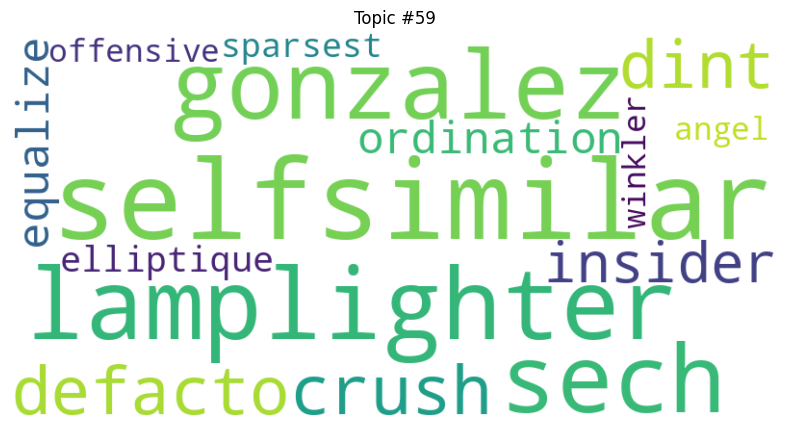

Topic #60:
Top terms: keldysh, convincing, antihydrogen, snd, hypersphere, talbot, heath, caesium, bogolyubov, nonconservation, lmm, agt, transistion, ry, quartette



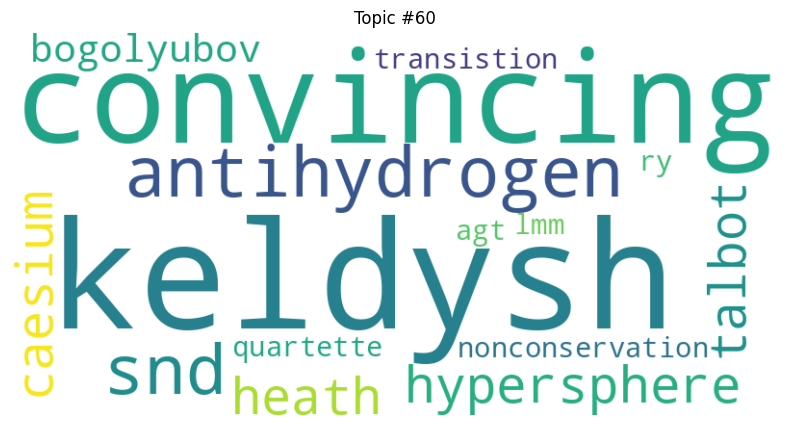

Topic #61:
Top terms: huse, morphic, motorway, cargese, nlin, manakov, suzuki, hourglass, modulational, shg, perfection, rans, approaches, thunderstorm, demonstrable



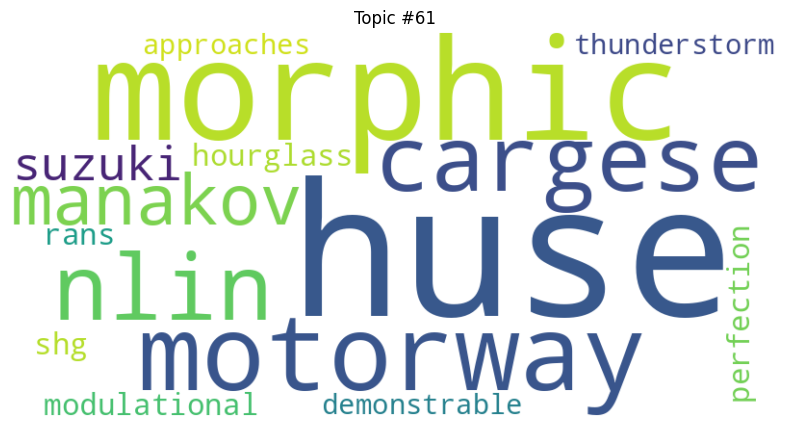

Topic #62:
Top terms: dml, hirano, pink, superficially, innovator, wipe, tailored, talent, glm, jarzynski, barry, receipt, horseshoe, judicial, maxprob



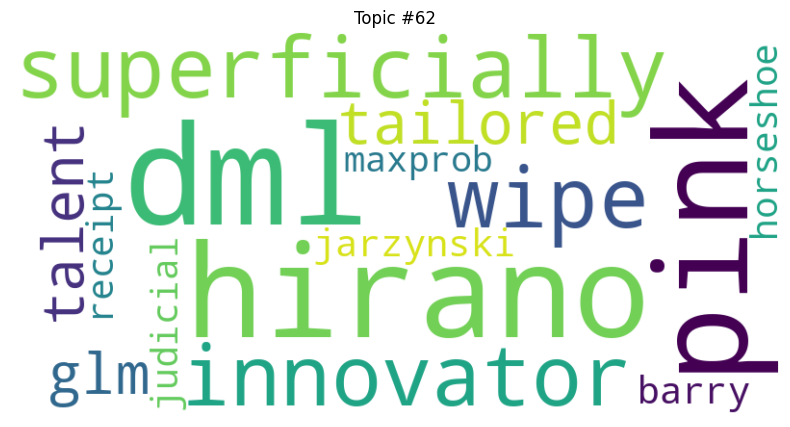

Topic #63:
Top terms: inapproximability, lncs, occurrent, floyd, decodable, stephan, kashiwara, superpolynomial, mct, boa, heaviest, coexists, succinctness, sta, hopcroft



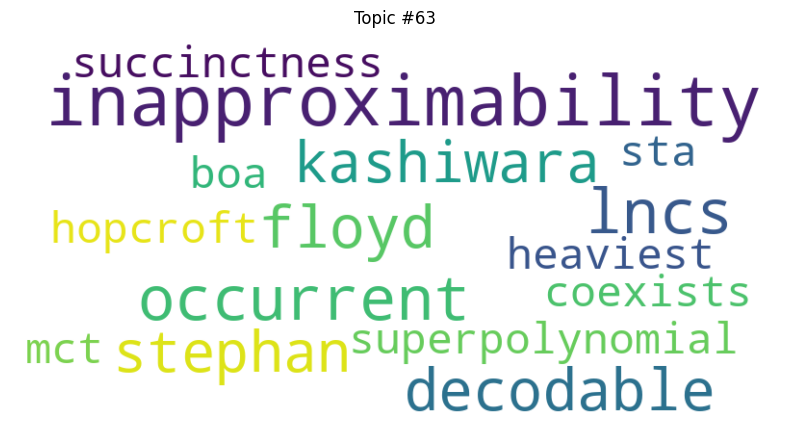

Topic #64:
Top terms: gardner, residues, rdm, uparrow, tagged, marinari, hypersphere, magnetoconductance, gruneisen, anyon, spm, imprinted, nadler, mccoy, amit



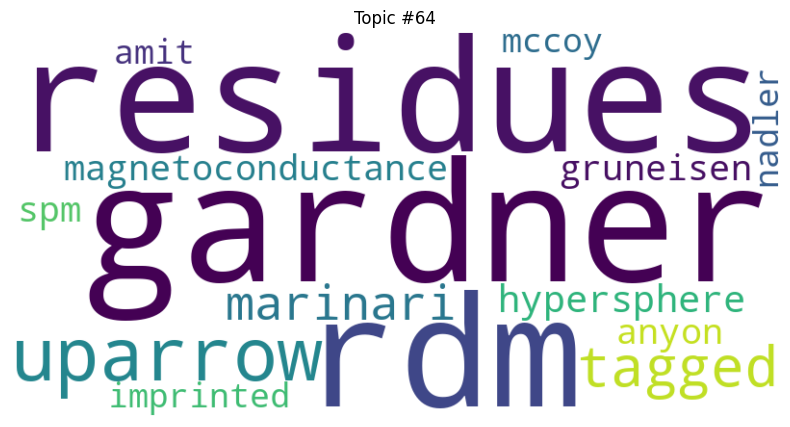

Topic #65:
Top terms: lawson, feng, tuneable, ccss, worldline, qualitatives, dampness, quelques, gruppen, narasimhan, nottingham, didactical, hasting, aj, freezing



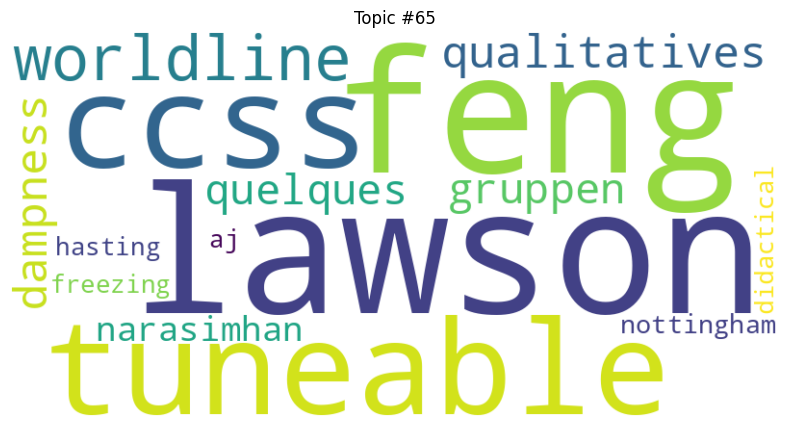

Topic #66:
Top terms: miwa, aperiodicity, zehnder, nonintegrable, gluing, farey, inconsistently, starlike, pspice, perez, gasolene, bivector, transferral, czech, ghosh



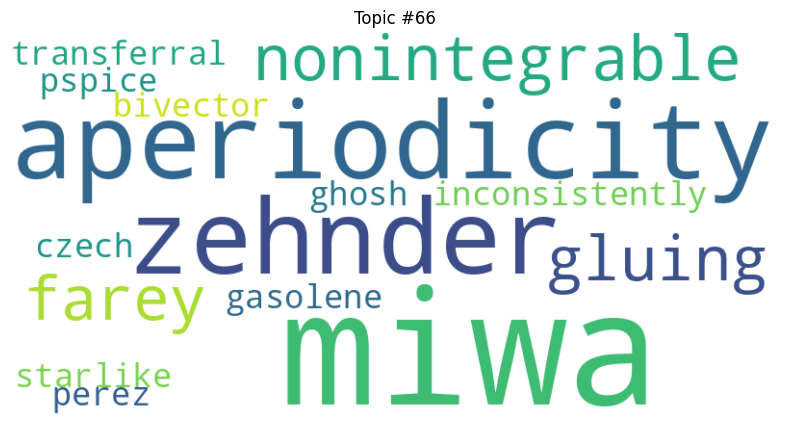

Topic #67:
Top terms: itp, aff, unvisited, rightful, worn, descendent, pointless, haystack, hnn, forefront, pz, golf, modelisation, sudoku, recode



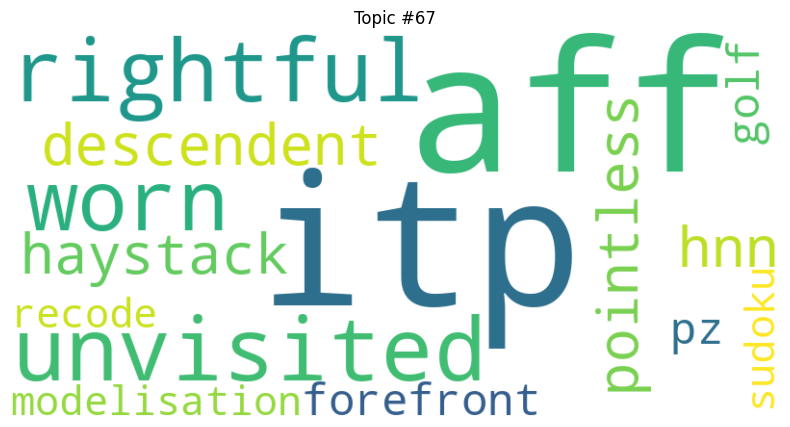

Topic #68:
Top terms: cea, villain, multicritical, kramer, renormalized, abrikosov, mcconnell, fluxoid, shafer, reformulations, reasoner, gflops, prog, lucas, nsp



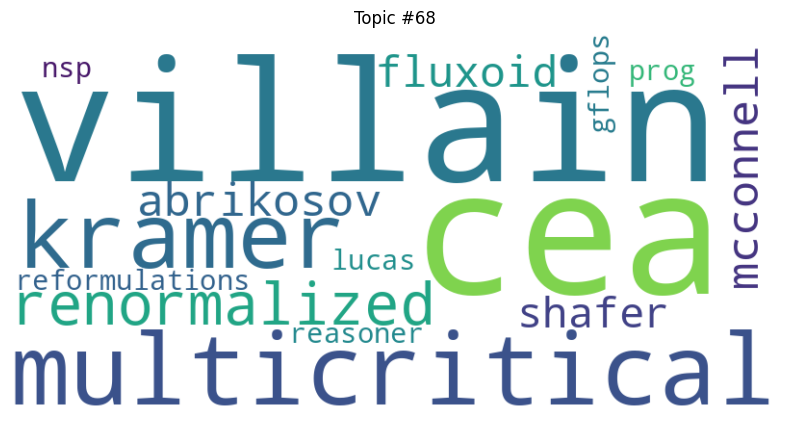

Topic #69:
Top terms: kauffman, caesium, queueing, braking, freezing, systeme, gardner, cyclist, salvage, goe, overfit, keldysh, memristive, knudsen, noninvertible



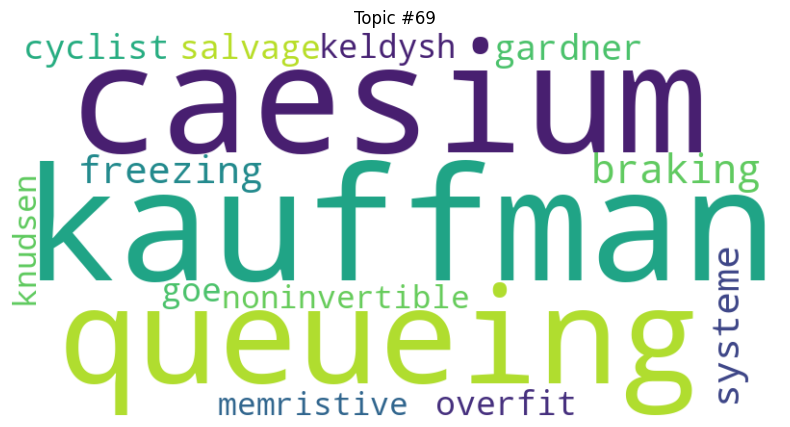

Topic #70:
Top terms: proving, caesium, keldysh, baer, smt, mln, relators, tanh, polylogarithms, overdetermined, sos, paths, jsr, magma, subregions



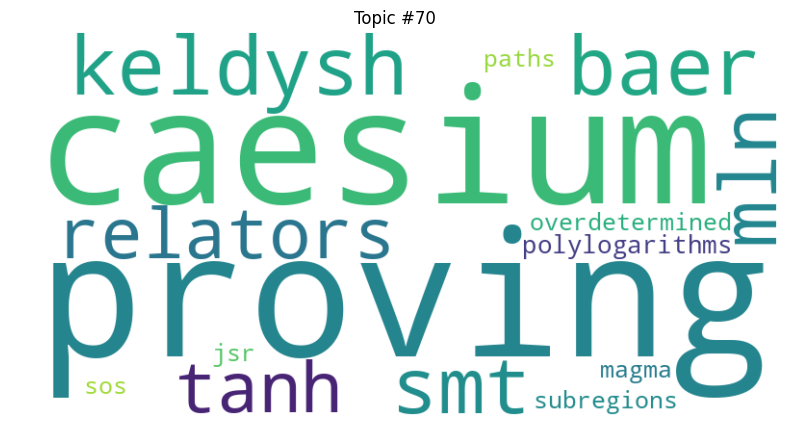

Topic #71:
Top terms: neurophysiological, ltp, nematode, surrogates, iit, reassembly, subnetwork, neurobiology, zooming, skull, improvise, melanogaster, csd, reinvent, algorithmics



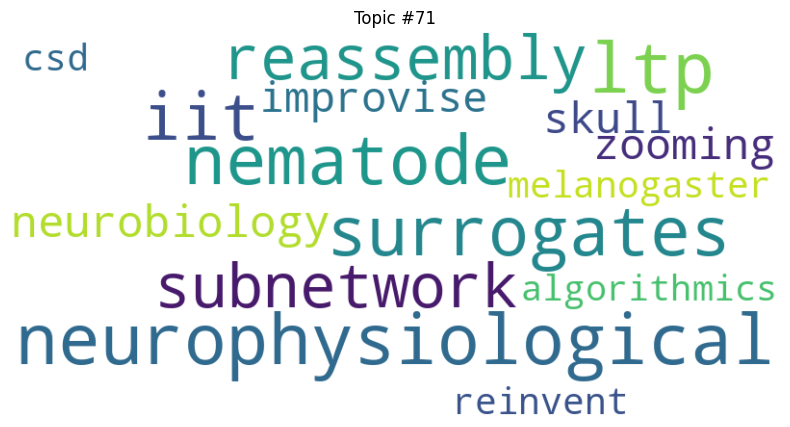

Topic #72:
Top terms: keldysh, cointegrating, explaining, subadditivity, berg, superselection, dcc, gerber, portfolios, levitation, ameliorate, quarterly, agt, dock, motifs



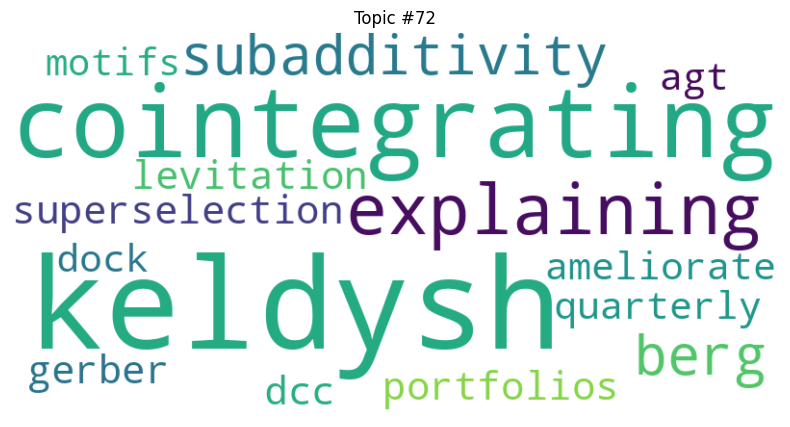

Topic #73:
Top terms: ccds, transistion, wei, radiofrequency, rephasing, halogen, mcwp, nearthreshold, antilepton, lippincott, francium, obe, contiuum, hydrogenlike, subrecoil



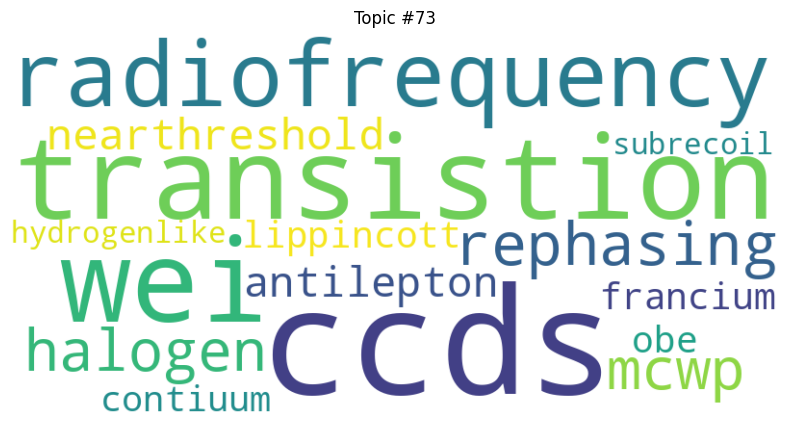

Topic #74:
Top terms: ccds, favourite, monster, maximises, snd, hanle, oscillates, esrf, evil, transistion, agt, watts, slm, fbm, cardy



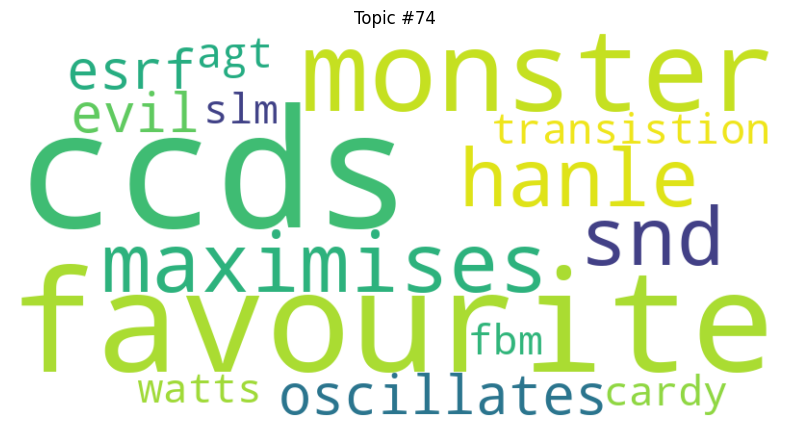

Topic #75:
Top terms: viceversa, relabeling, ry, cummings, rapidity, dts, intentionality, hua, ascribed, worlds, snd, multinational, occam, quartette, semantical



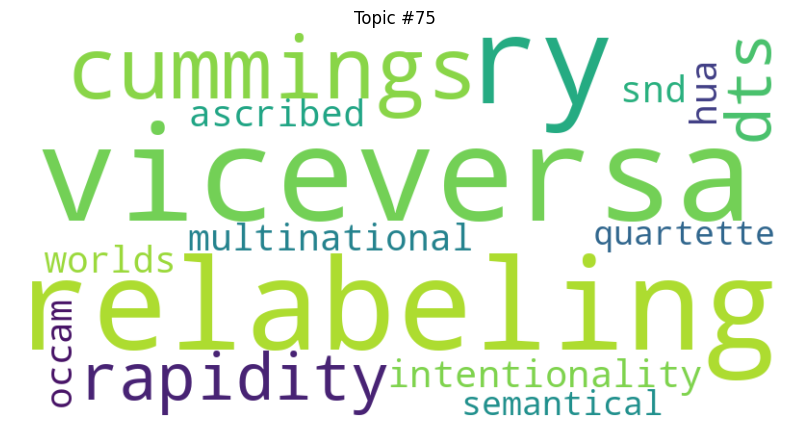

Topic #76:
Top terms: oecumenical, destructively, meissner, gasolene, colinear, digraphs, bodlaender, plaquettes, microcanonical, bsa, birman, slowing, sgn, halve, andrews



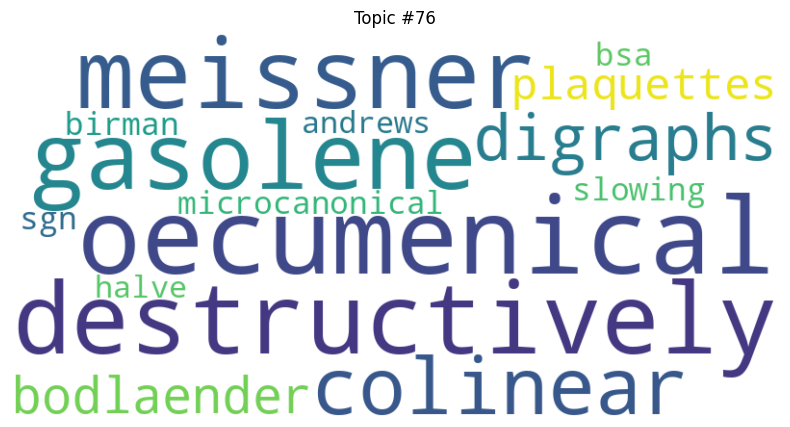

Topic #77:
Top terms: lexicographical, checked, constructional, condor, noncausal, forme, majorly, sos, matchmaking, sublanguage, modifier, castor, minimized, phenix, incrementality



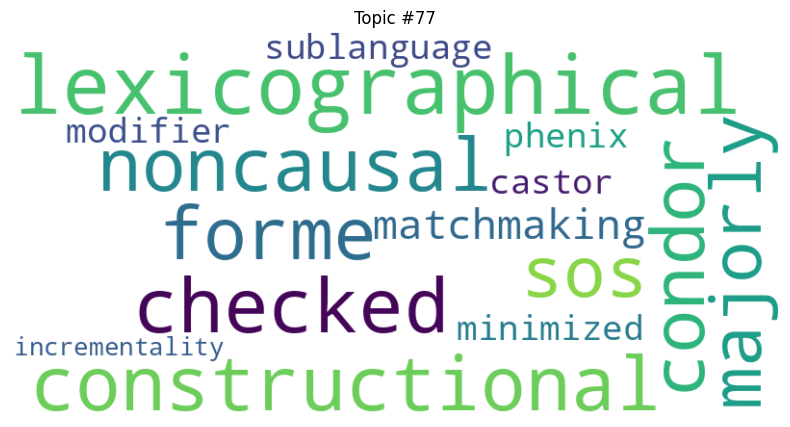

Topic #78:
Top terms: ccr, lau, publ, semiregular, cnt, walter, noncommuting, wep, biochip, unimodality, jp, vn, breiman, invariability, traceless



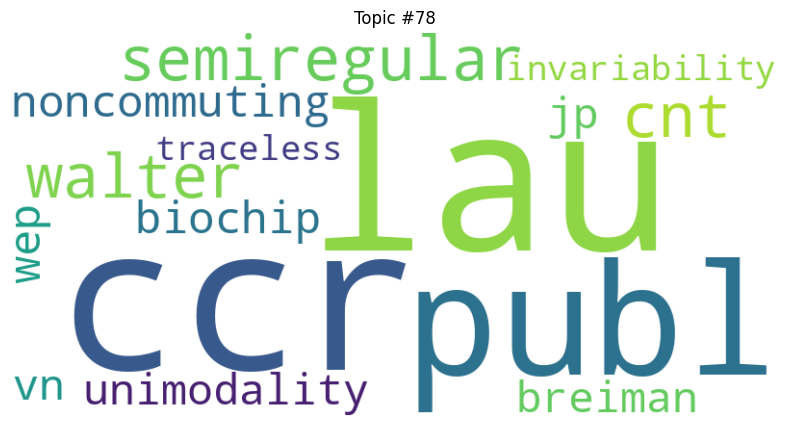

Topic #79:
Top terms: cq, multicritical, buffering, brexit, csd, deconfining, deconfinement, acronym, nyi, sato, allegation, sty, bitcoins, heteroskedasticity, supercharge



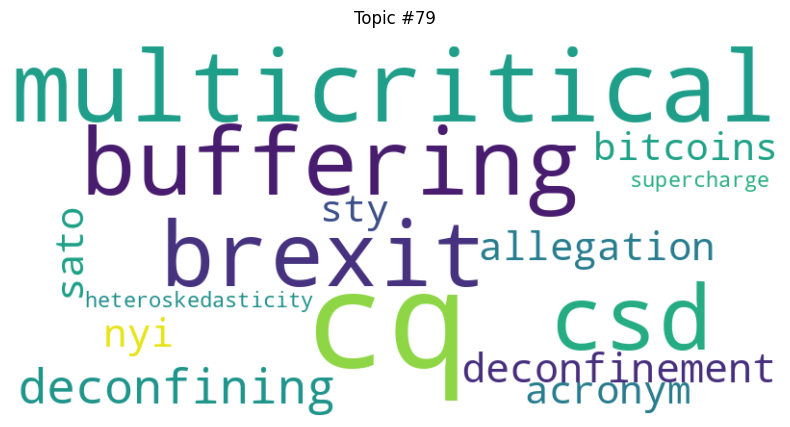

Topic #80:
Top terms: engle, lppls, bouchaud, amh, bail, cointegrating, nbi, oslo, installment, fco, fmnbls, wbls, wednesday, fbms, aparch



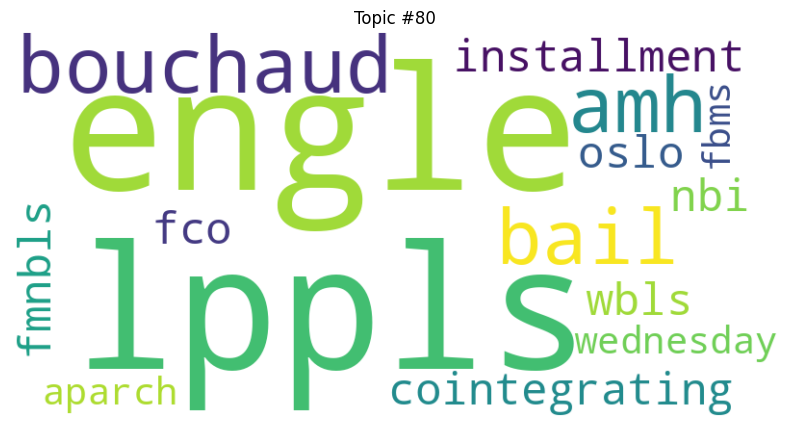

Topic #81:
Top terms: onedimensional, couplet, capacitively, err, nazionale, nondissipative, robnik, prohibition, parabolically, skyrme, renormalized, pth, unveiling, ucsd, scar



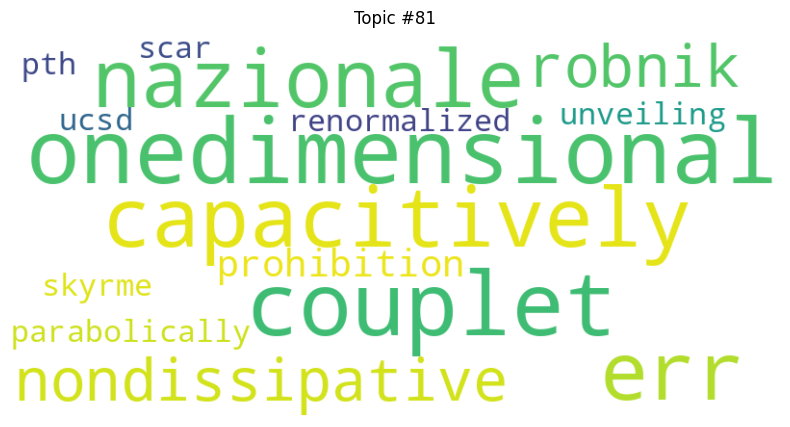

Topic #82:
Top terms: kirby, tuberculosis, tubing, ultralow, voxelized, possibilities, dubious, unbiasedly, joining, genera, kervaire, unplanned, reparameterization, copd, monoenergetic



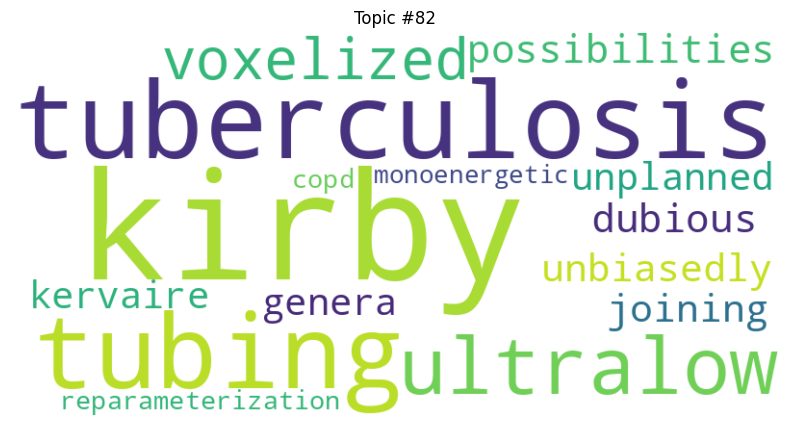

Topic #83:
Top terms: convincing, caesium, hua, transistion, lying, coifman, deuteron, cq, systematical, interception, unreported, meas, solidification, cliff, wei



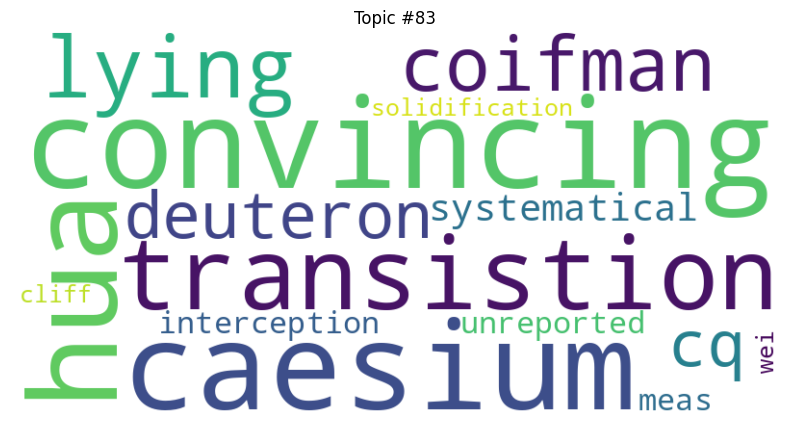

Topic #84:
Top terms: octagon, dodgson, baumslag, lagarias, peled, isometries, overrightarrow, monomorphism, busemann, spectre, kuperberg, pentahedral, cartier, nakajima, projectivization



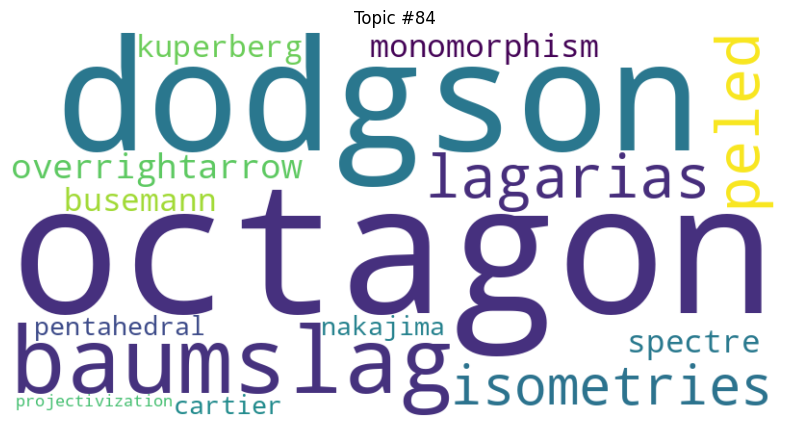

Topic #85:
Top terms: intentionality, collate, dubois, forex, halpern, mapped, strauss, webpage, dampen, superficial, superscript, smets, pound, distinguished, yeo



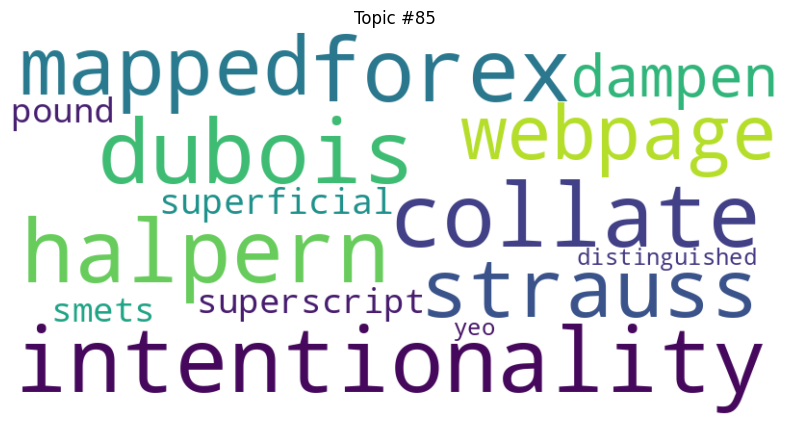

Topic #86:
Top terms: fatou, ccr, holland, immensely, grateful, sst, formatting, dickson, mentally, bezout, copying, translator, tribute, modularization, sextic



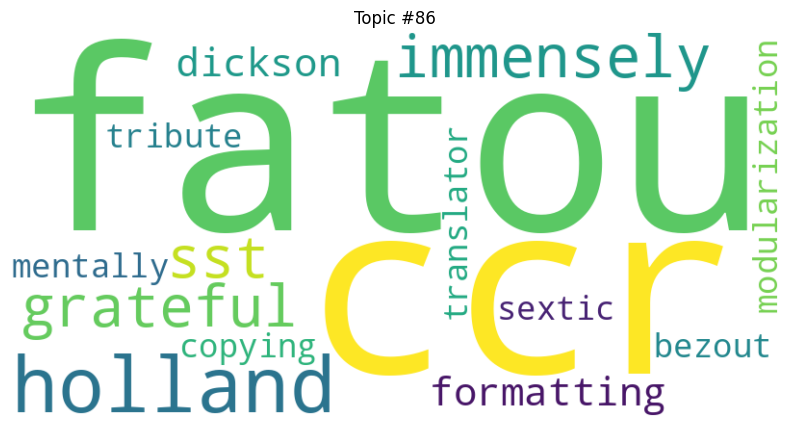

Topic #87:
Top terms: hmc, noncentral, nowcasting, inspector, roth, investigative, ggm, mlmc, speedups, nexus, regress, subsumption, sturmian, moo, categories



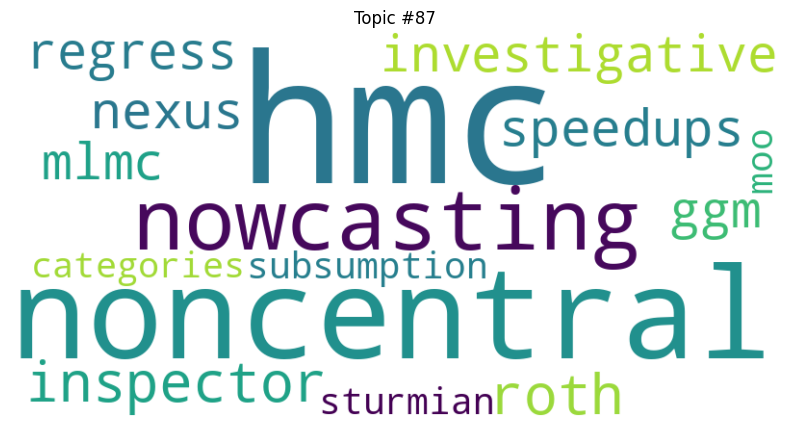

Topic #88:
Top terms: rotates, simplexes, gell, grammatically, illusory, broadens, acount, logistical, appell, auckland, drilling, mentally, invariantly, disconnectedness, multitarget



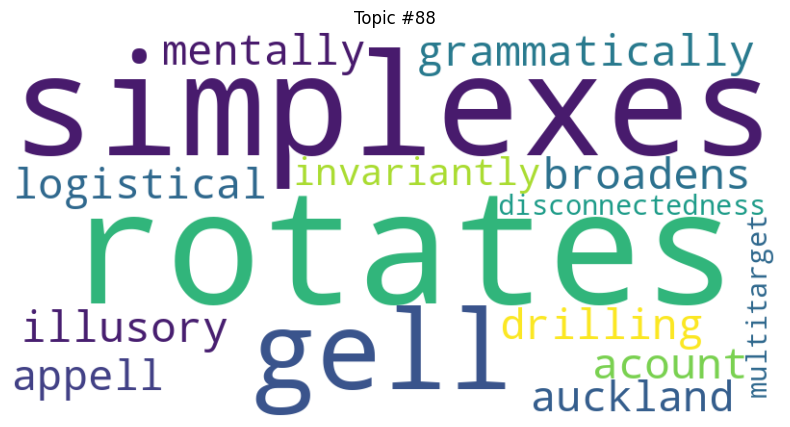

Topic #89:
Top terms: outil, madrid, phenomenal, ferrimagnetic, netflix, ghosh, universite, contraintes, dfrac, inp, centrosymmetric, salesperson, contented, ara, neel



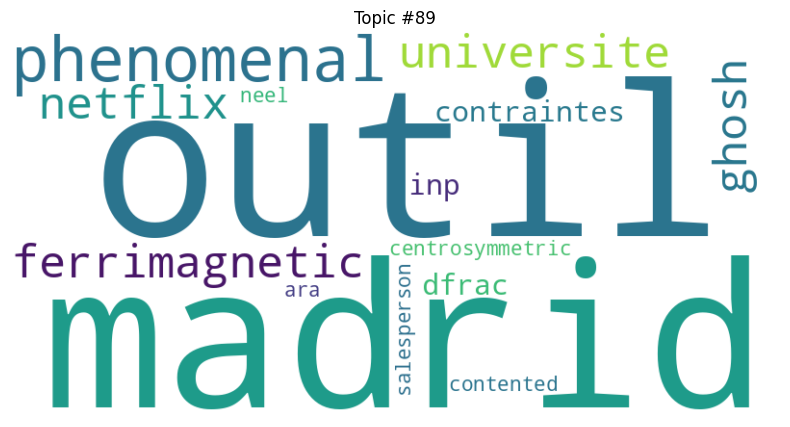

Topic #90:
Top terms: simplexes, superfluids, lenz, saff, naimark, pseudospectra, categorial, graf, weinberger, subtractive, tamarkin, mcintosh, srf, quasitriangular, univ



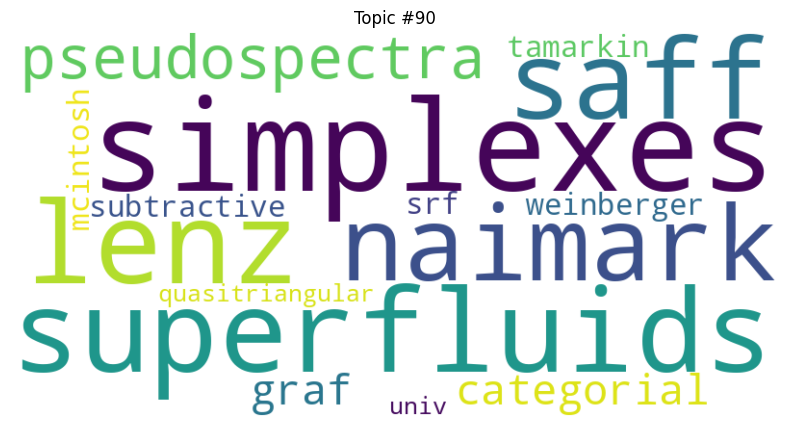

Topic #91:
Top terms: takagi, meromorphically, eastwood, arctangent, polydisk, sfm, presque, grauert, fewest, uniformization, spinodal, hydrogenic, pfl, sunada, isospectrality



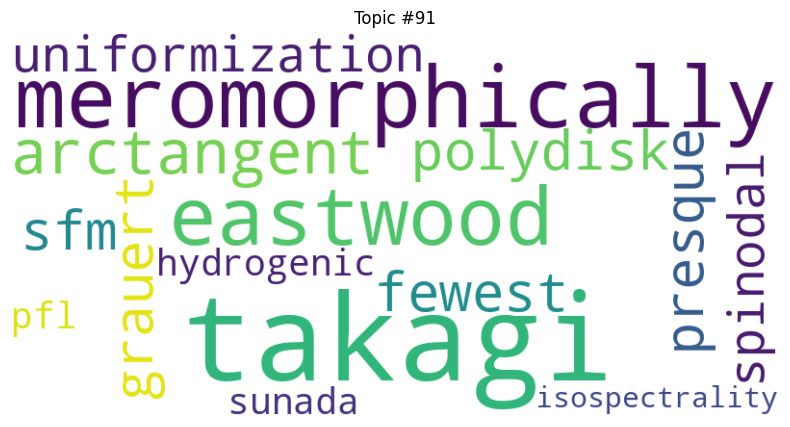

Topic #92:
Top terms: norwegian, leiden, explicate, tortuous, lars, mason, desirability, predate, corrected, succesfully, keating, overestimated, bruno, chromosomes, comprehensibility



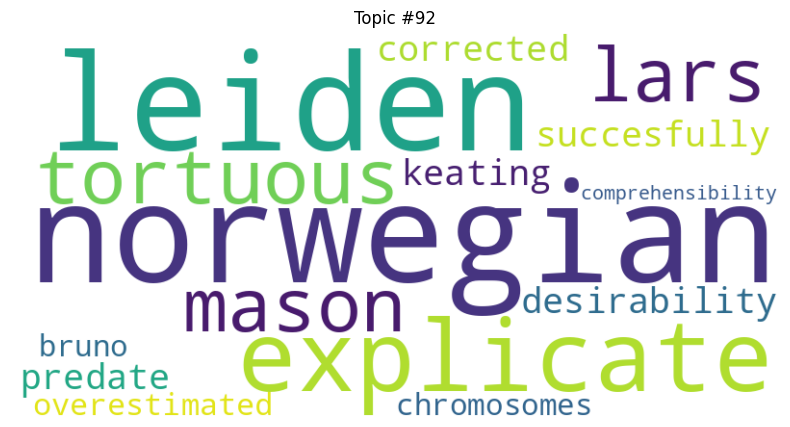

Topic #93:
Top terms: univ, henri, patterson, faulhaber, graf, subrings, conjoint, ran, dipoles, orbitally, fragmented, itp, gustav, crystallize, hci



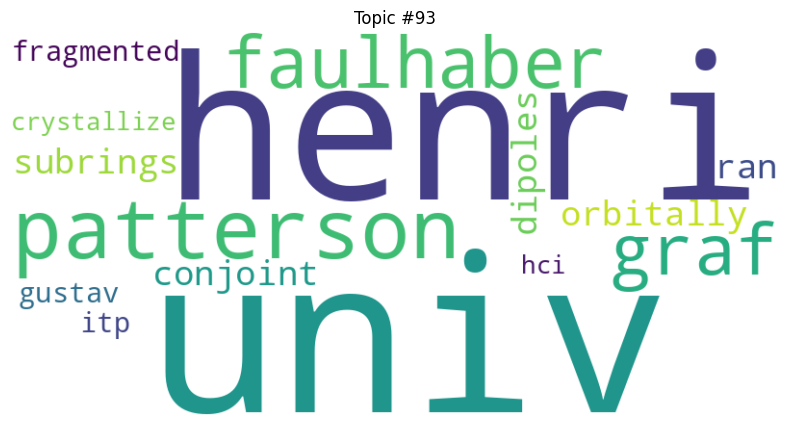

Topic #94:
Top terms: sturmian, appell, emphasized, intermodal, meanfield, graev, pictorial, blodgett, dpsk, neuman, cummings, kin, rdm, nonuniformly, expresions



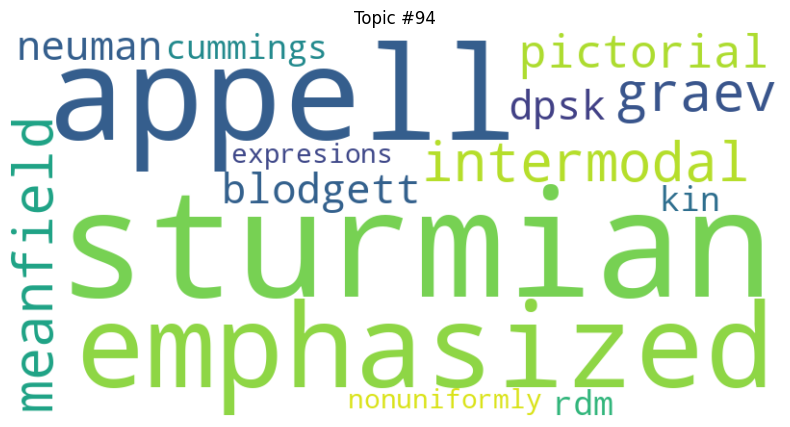

Topic #95:
Top terms: tumbler, keldysh, paramagnetism, sublayers, zelotes, antiferromagnetically, grinstein, gruneisen, magnetoconductance, tomonaga, screened, porter, plateaus, departs, buttiker



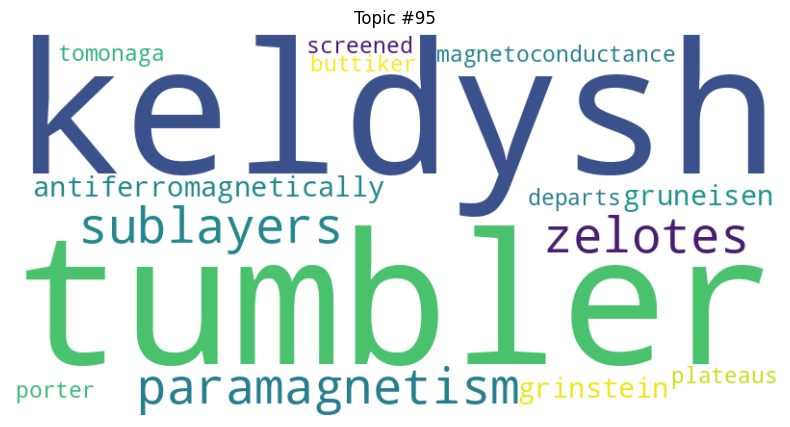

Topic #96:
Top terms: dia, lineshape, franck, benenti, gaudin, plaquettes, cuprous, anharmonicities, interstitials, pancake, tonks, governed, sagnac, lenght, condon



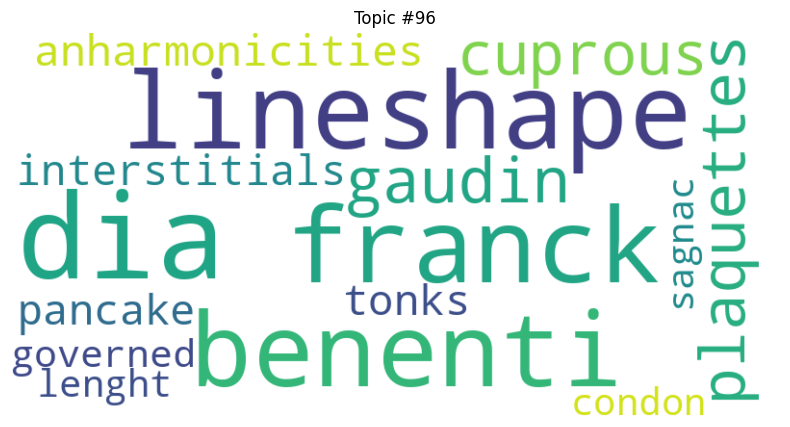

Topic #97:
Top terms: uniformization, kite, imperfectly, modus, nil, jonsson, shrunk, dop, ness, talent, tailored, ply, prec, reals, universes



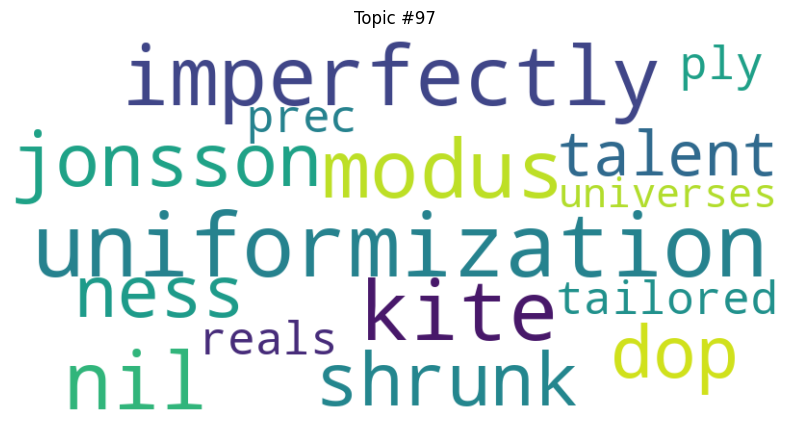

Topic #98:
Top terms: talbot, cummings, conf, quartette, accelerates, sturmian, convincing, nearthreshold, lithiumlike, chilton, chirping, didcot, dimuonium, dunham, kuchiev



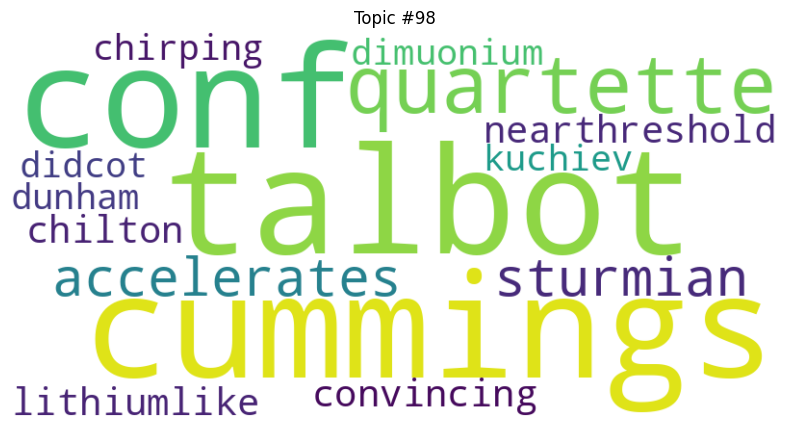

Topic #99:
Top terms: fixate, neil, workhorse, seam, dinner, ingenious, craig, att, bv, expedite, abp, traceable, crease, pga, prestressed



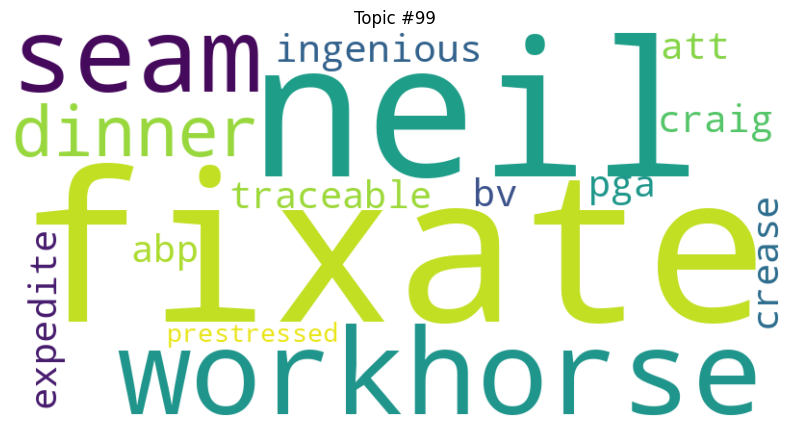

Topic #100:
Top terms: edgeworth, ftse, imai, convnet, gam, sinkhorn, intertwined, potter, endpoints, willard, martingales, mcts, strickland, demonetization, gjr



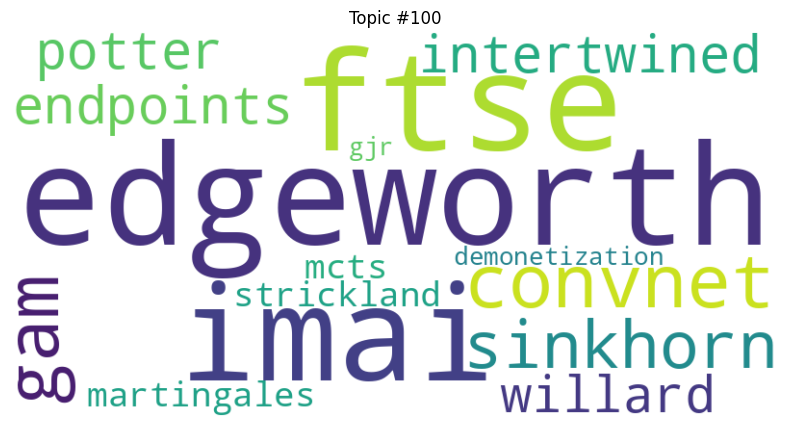

Topic #101:
Top terms: weird, eigenmode, burnt, categorise, adjective, vg, laden, converging, reflectionless, stud, stewartson, solidification, kuzmin, bandgaps, servo



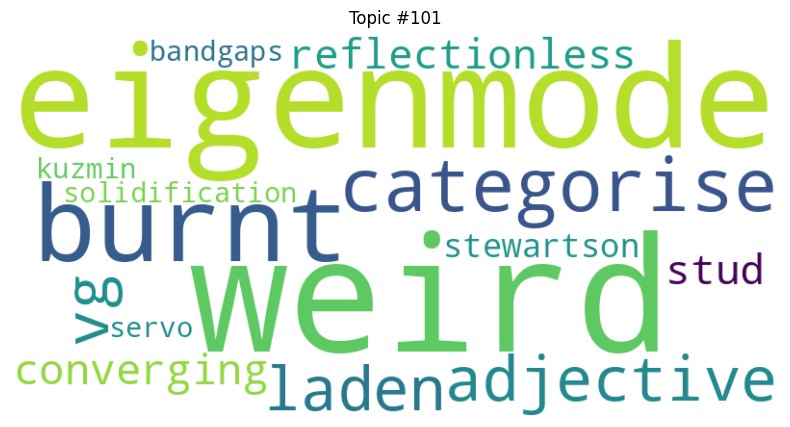

Topic #102:
Top terms: teichmuller, iwasawa, nil, appel, shack, digitalization, struct, lindenstrauss, omits, schroeder, scoping, fluoride, webster, archived, clements



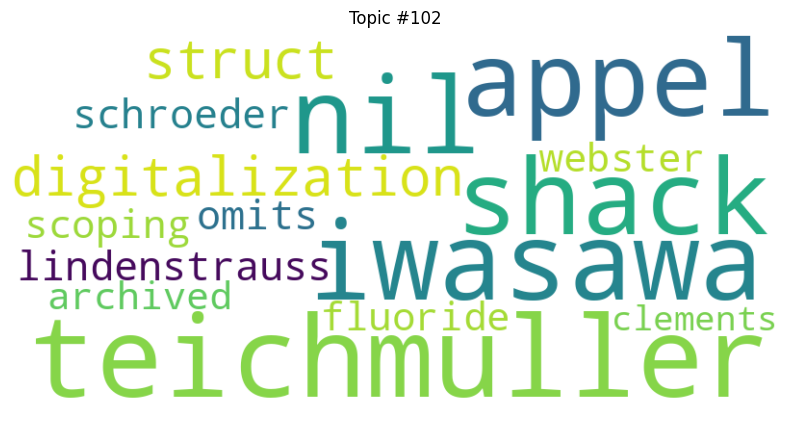

Topic #103:
Top terms: reflexivity, preexist, goldman, kz, pik, cnm, bicomplex, clockwise, insufficiently, favored, tac, inscription, zheng, erythrocyte, sleeve



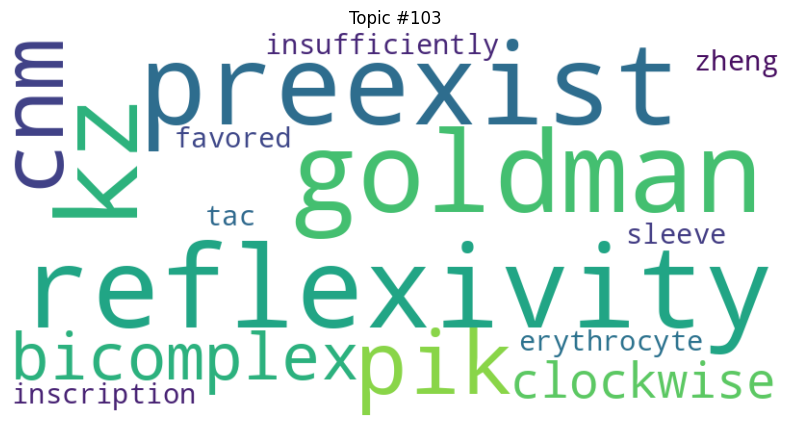

Topic #104:
Top terms: smectic, cohn, hove, gorkov, vj, wavevector, plaquette, voigt, depolarized, helfrich, layering, aerogel, diffuses, overlayer, okuda



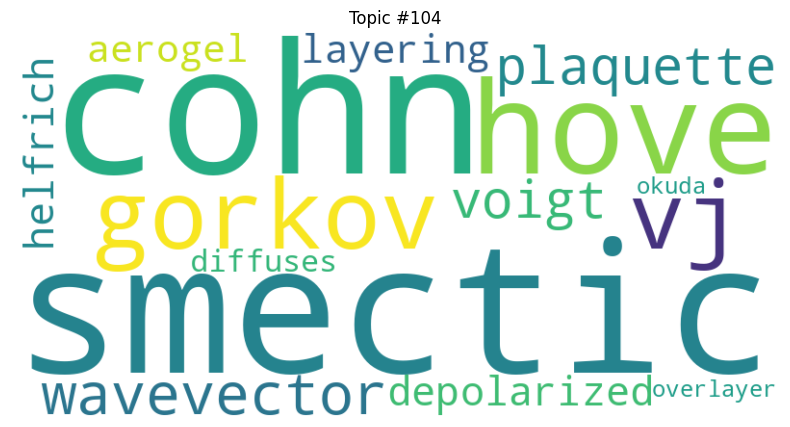

Topic #105:
Top terms: universes, nski, credence, stats, pretend, hotelling, equalise, sdf, multiplies, gumbel, recode, mond, agnostical, schreier, deduces



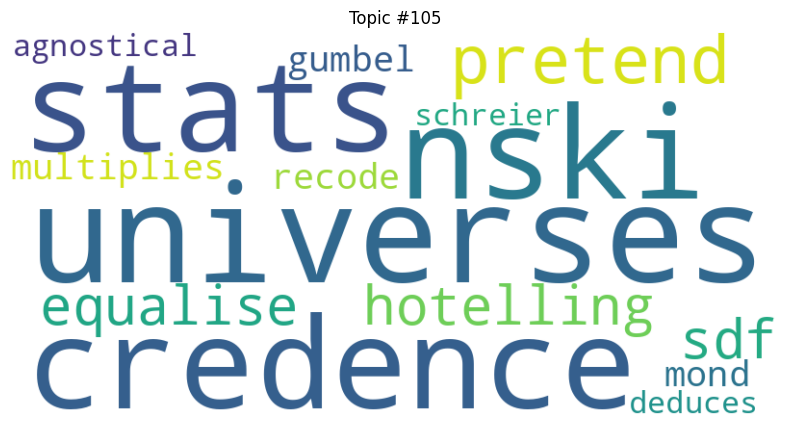

Topic #106:
Top terms: ytterbium, ess, skews, staggered, apologize, axi, xpm, multicritical, validly, ruling, monogenic, colloquium, brusselator, leray, nonincreasing



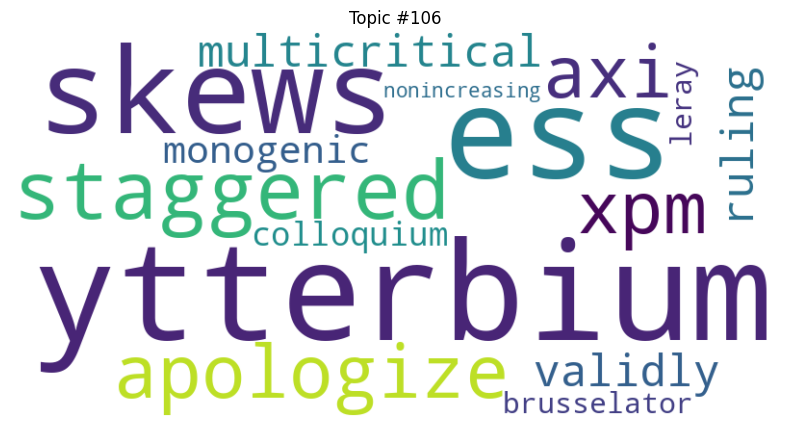

Topic #107:
Top terms: hotelling, zhao, sync, lad, iht, burbea, varma, tracy, jin, probab, johnstone, casual, capm, confirmatory, nolan



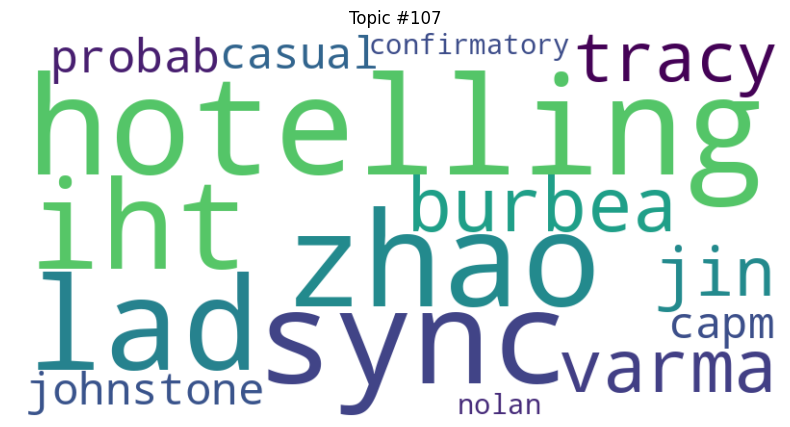

Topic #108:
Top terms: plaquette, antiparallel, kitt, eguchi, spacelike, occupancies, andreev, heller, eth, iraq, wavevector, burton, microk, marvin, tumbler



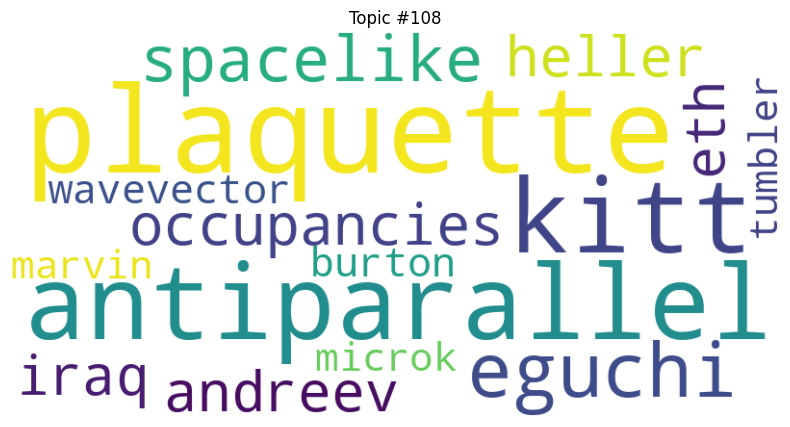

Topic #109:
Top terms: loi, herglotz, technicality, harmless, owen, symmetries, berezin, aubry, pgl, halmos, ostrovskii, dunford, limbs, motto, spectacularly



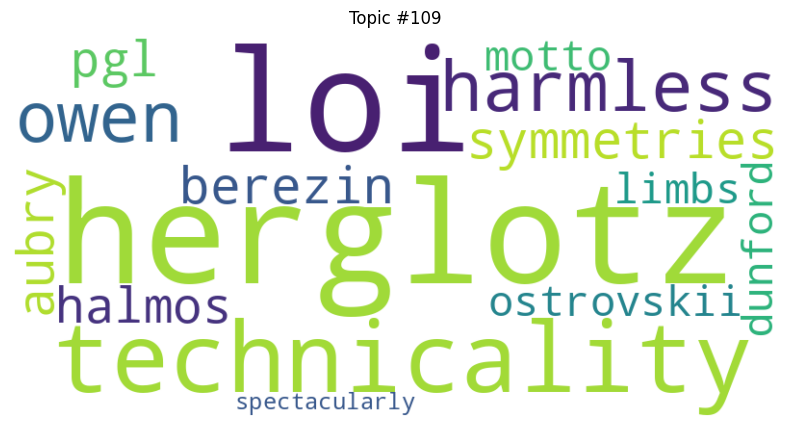

Topic #110:
Top terms: ekeland, fishburn, aot, diffuses, quadratures, immobility, mds, ballock, olympic, pervasiveness, argentine, blockwise, ahp, peakedness, simplifying



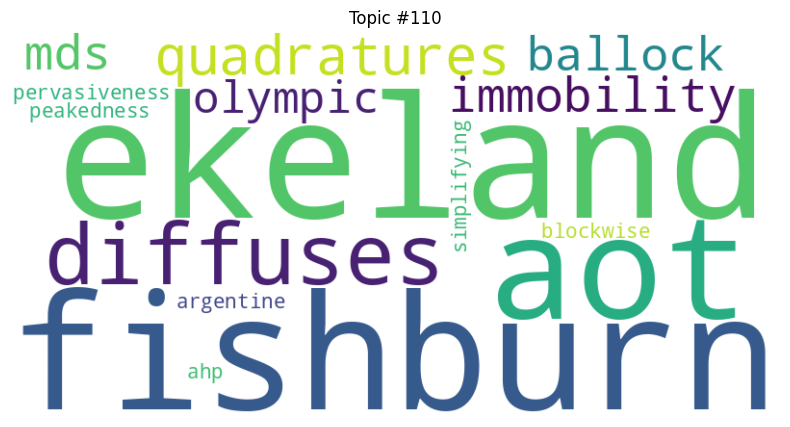

Topic #111:
Top terms: dominantly, sib, nonphysical, colombeau, punctured, skein, gerard, helfrich, detonation, devries, librate, aerogel, weightiness, commutability, univ



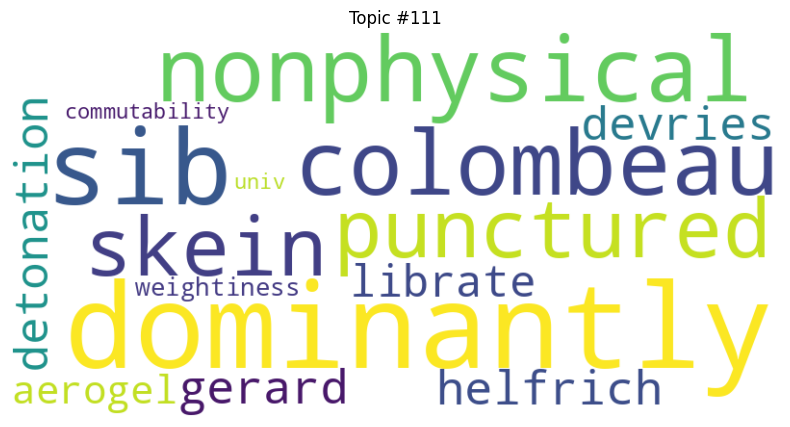

Topic #112:
Top terms: beer, announces, multielectron, marcus, programmatically, faa, impacted, preexist, livermore, osa, acyclicity, goldman, cryo, ripe, macrocell



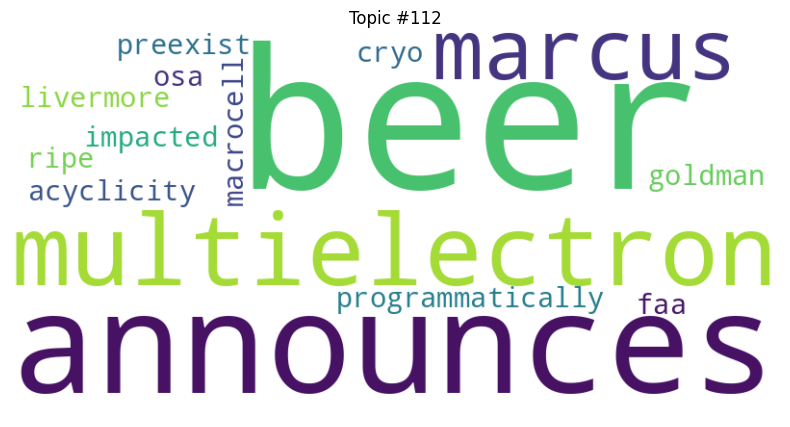

Topic #113:
Top terms: underutilized, ria, dcd, panorama, inexperienced, lanl, pretreatment, geqslant, vgg, damaging, torch, slippage, convnet, ang, ucm



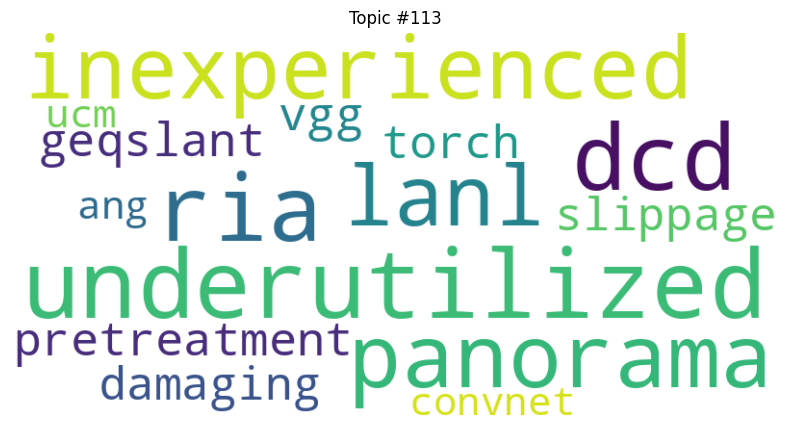

Topic #114:
Top terms: payout, ollmer, karatzas, bielecki, nutz, isoelastic, eraire, xou, frey, subordinator, noncollinear, burster, spde, ern, turnpike



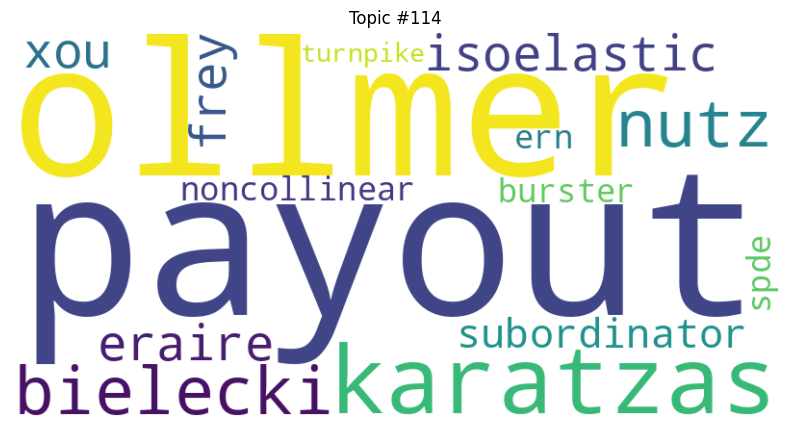

Topic #115:
Top terms: sfb, retire, clayton, carlisle, tco, envelopment, bequest, invests, eut, decumulation, dse, unattainable, heteroskedastic, unbridle, haven



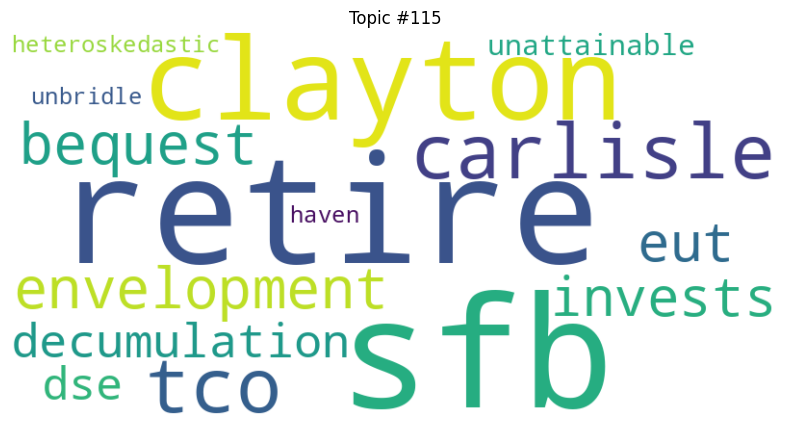

Topic #116:
Top terms: inst, hookrightarrow, jin, theoreme, casual, nilpotente, fini, rickard, algebres, nonaffine, hsieh, subring, varma, indeterminates, raised



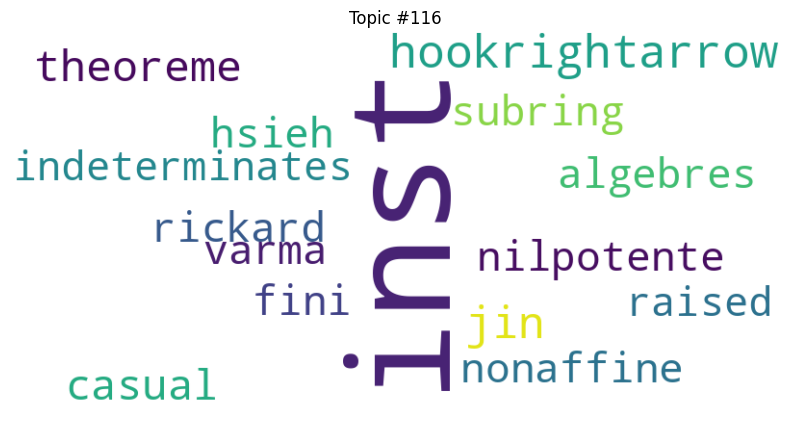

Topic #117:
Top terms: ofthe, characterises, departures, grading, sln, factorizes, ljusternik, cj, unsettle, alvarez, aff, bogomol, strominger, superset, nxn



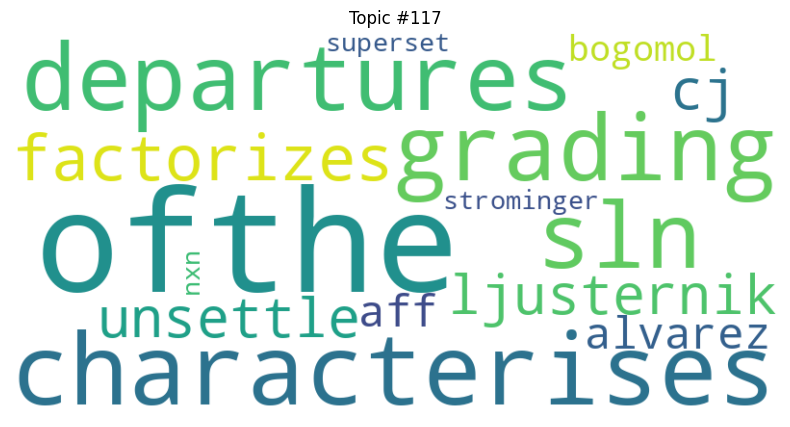

Topic #118:
Top terms: reflectionless, mj, superheated, unirradiated, gem, cattaneo, gustav, mbit, wronskians, mds, stead, discs, perturbing, tonne, eh



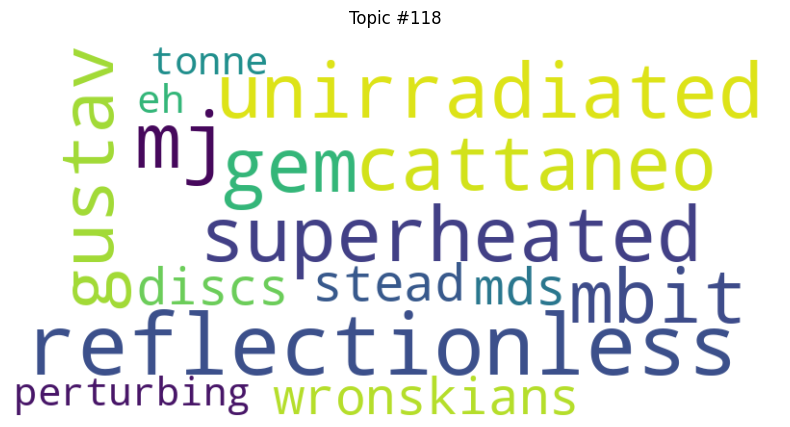

Topic #119:
Top terms: pertubation, zygmund, commutant, bicritical, irrationally, bolle, rabinowitz, fatou, stuff, asymtotic, uninformed, andronov, convergency, eckmann, depicts



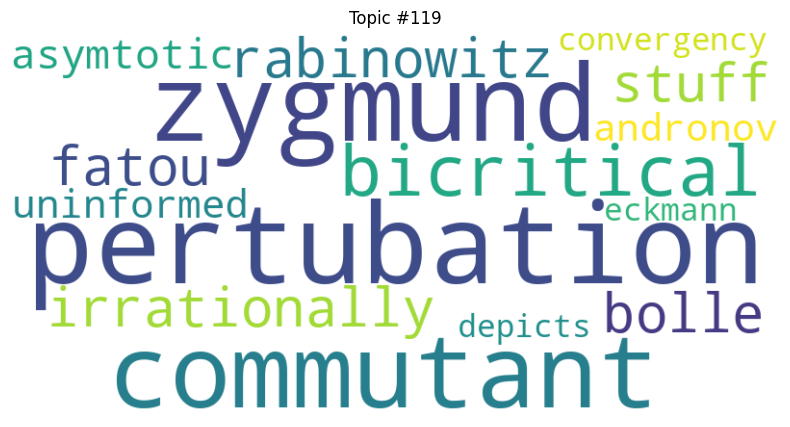

Topic #120:
Top terms: etfs, kilohertz, deposited, nanosystems, bicritical, jastrow, physisorption, annealing, meshkov, nanocluster, attosecond, ati, krypton, scandium, nanoclusters



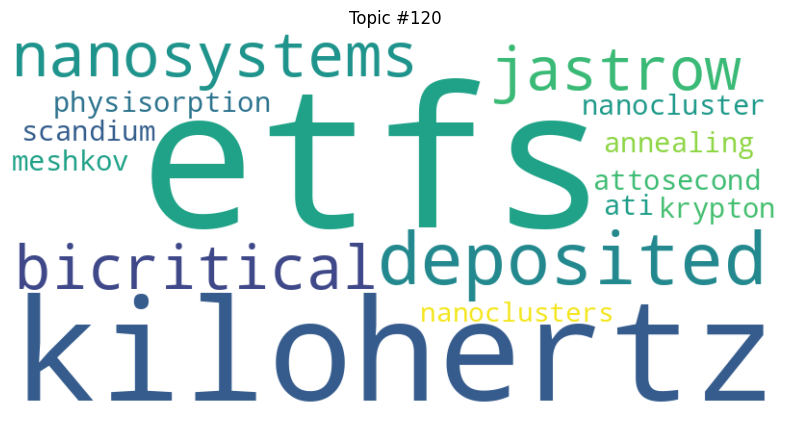

Topic #121:
Top terms: mikhailov, cot, counteracts, microk, tidally, intensely, nonselfadjoint, umemura, efficiencies, stimulated, denumerable, shg, cessation, bandgaps, systematical



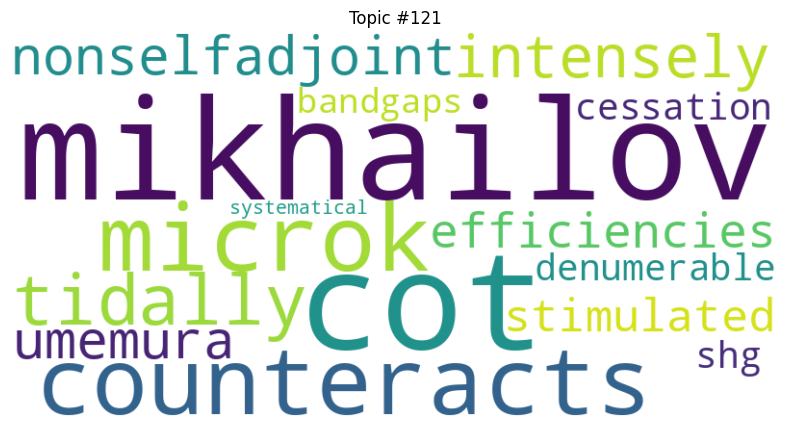

Topic #122:
Top terms: dws, coevolutionary, cahn, polyacetylene, kbt, ppv, steroid, crystallisation, reentrant, pearl, fet, luce, discounted, compartmentalise, heel



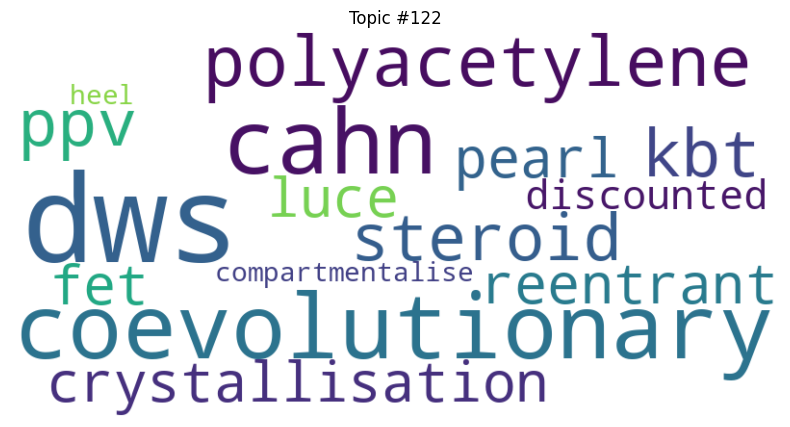

Topic #123:
Top terms: omits, hookrightarrow, nonsymmetric, distinguished, theoreme, narasimhan, geneva, hypercomplex, jac, shilov, webster, duflo, denef, supermanifolds, vivant



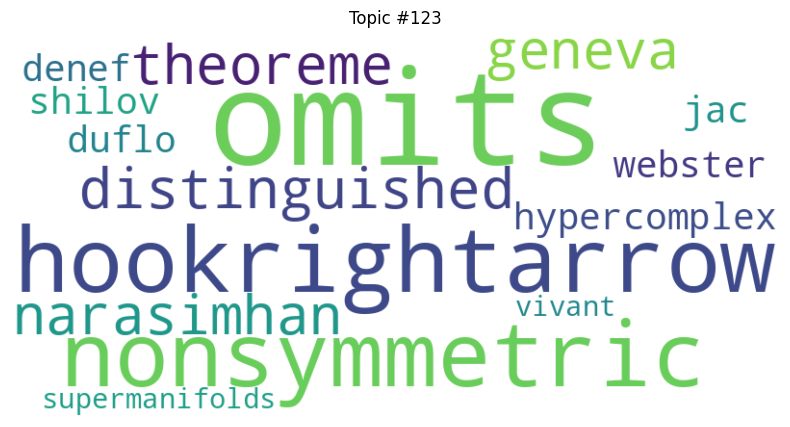

Topic #124:
Top terms: aubry, reflected, gpe, nonpolynomial, superoperator, skyrmions, attests, charging, confining, campbell, deexcitation, octupole, heteronuclear, rovibronic, photoassociative



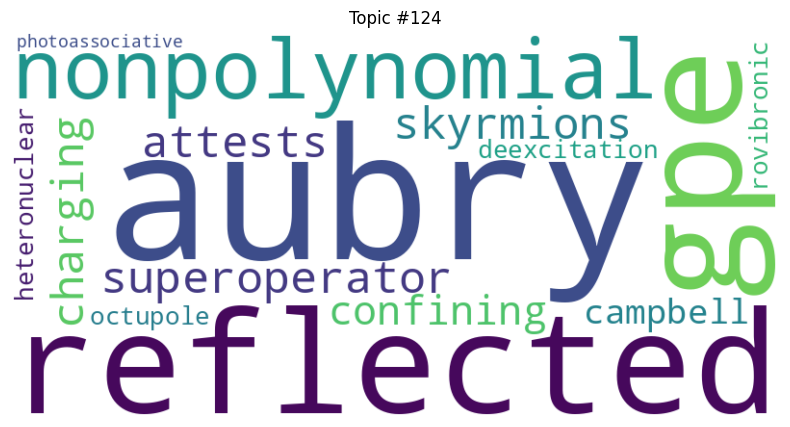

Topic #125:
Top terms: coordinator, landweber, axiomatize, lec, virtualized, unwieldy, vlc, blocker, endless, ppp, editing, aerogel, lar, pce, pcl



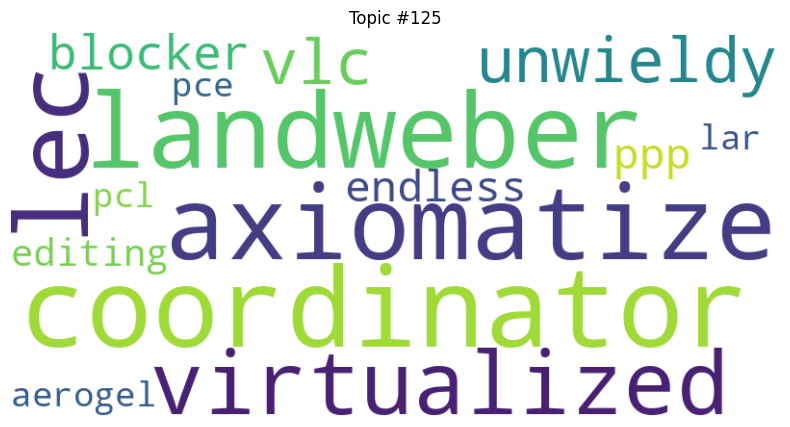

Topic #126:
Top terms: sax, penetrates, snd, bol, msh, catcher, aspiration, acis, gsc, calorimetry, fledgling, cot, footpoints, lsr, resistively



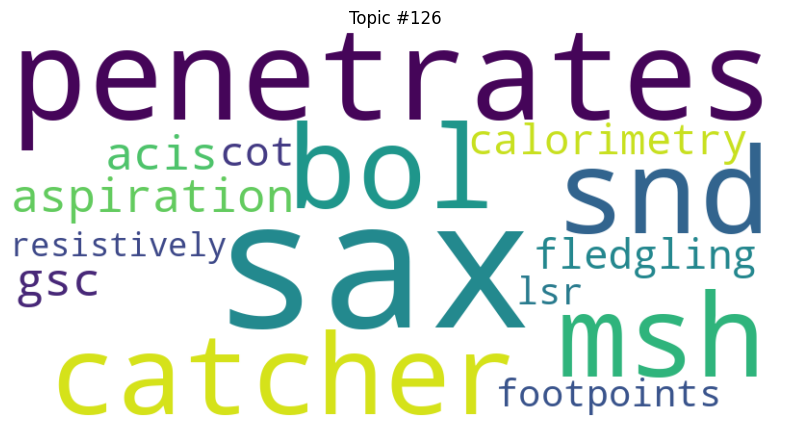

Topic #127:
Top terms: lindahl, valiron, pseudometric, pseudometrics, infeasibility, tds, metrically, decisiveness, roam, abolish, addictive, semifinite, ipc, cartwright, tony



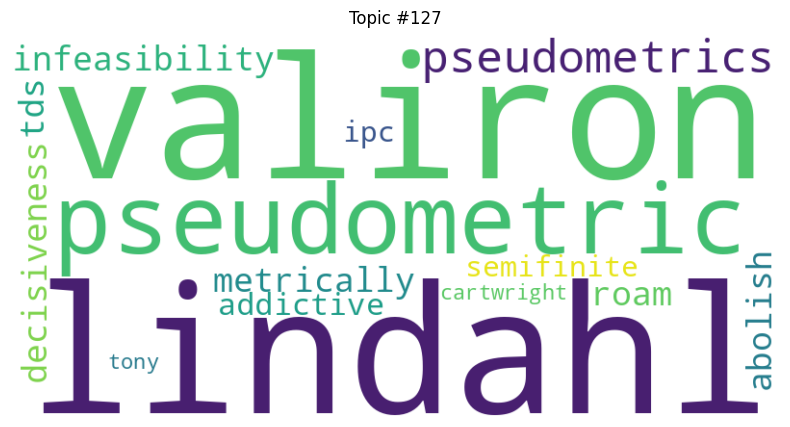

Topic #128:
Top terms: acyclicity, reacts, knightian, misrepresent, oligopoly, dga, repairable, defender, incentivized, bpa, coinduction, deferral, nucleolus, balcan, sme



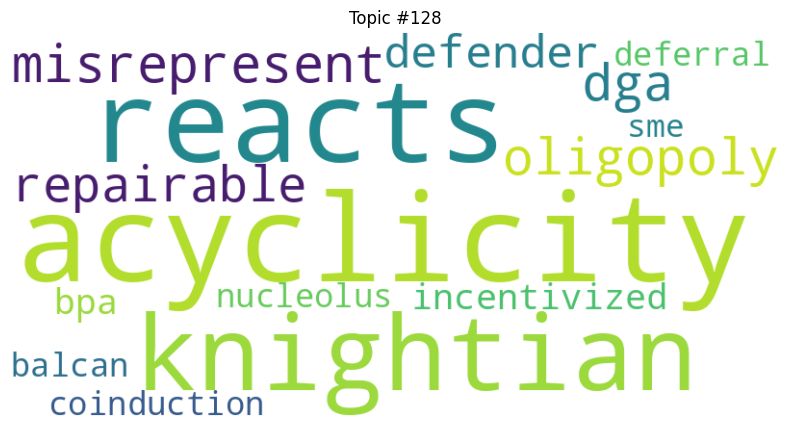

Topic #129:
Top terms: conormal, constrict, cochains, folded, sideways, millson, abs, stasheff, konno, coisotropic, dong, gluings, charcteristic, bidifferential, cohomologous



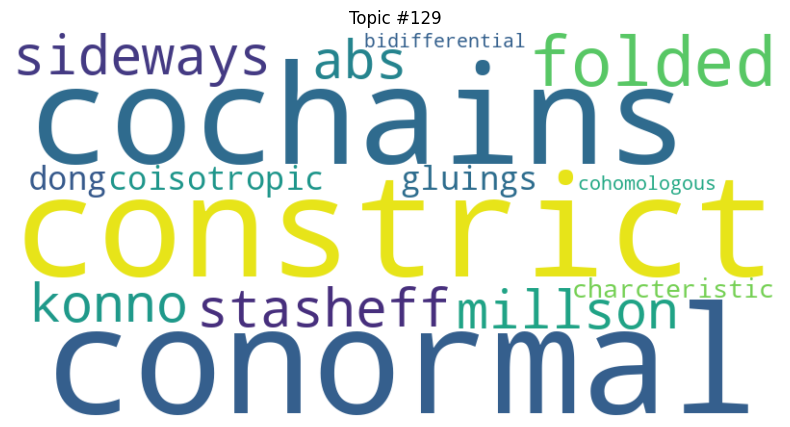

Topic #130:
Top terms: qf, amitsur, lw, sanderson, rallis, gordan, superring, sekiguchi, levitzki, nilradical, preprojective, idealizer, semistable, cloture, murakami



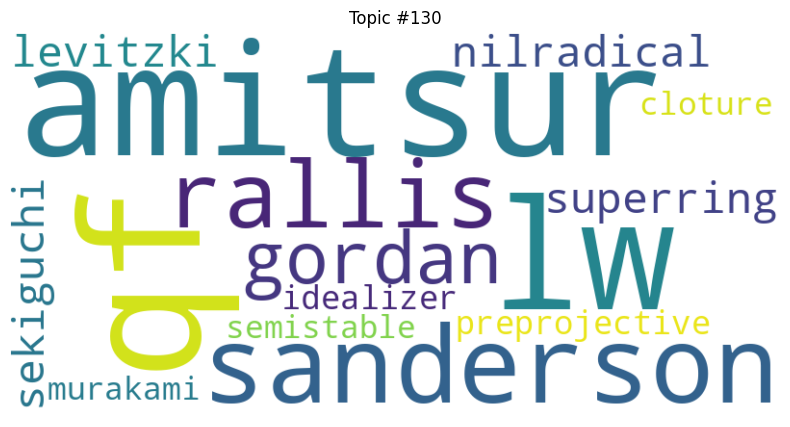

Topic #131:
Top terms: kronheimer, invariants, gau, satake, bigraded, homogenes, flato, takhtajan, olicher, sence, components, spinorial, schnirelmann, skeleta, factoring



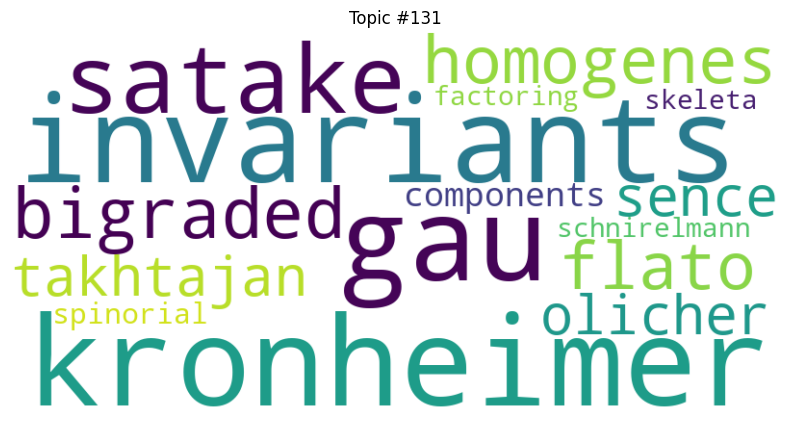

Topic #132:
Top terms: bigraded, bowtie, elastica, subregular, contruct, eckart, ramanujan, monster, liso, recess, ingres, fuks, shanskii, takhtajan, olicher



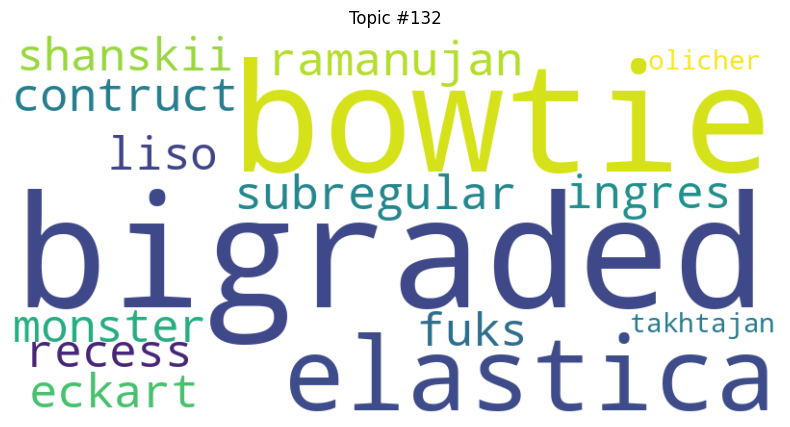

Topic #133:
Top terms: gws, coma, anticorrelation, hight, viscously, transonic, centrifugally, groundbased, comets, lbt, lightcurve, adafs, magnetohydrodynamical, circum, flaring



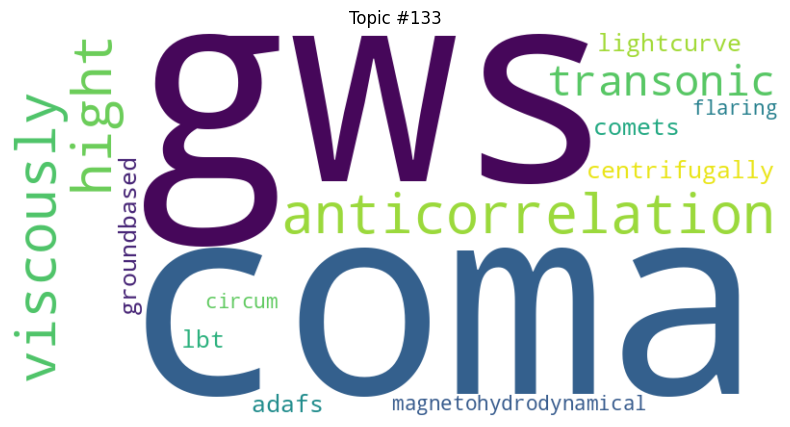

Topic #134:
Top terms: phason, irrelevance, interplane, berezinskii, noncollinear, righi, disordering, korringa, fullerides, interplanar, semiinfinite, reentrant, quasielectrons, ultrasmall, subgap



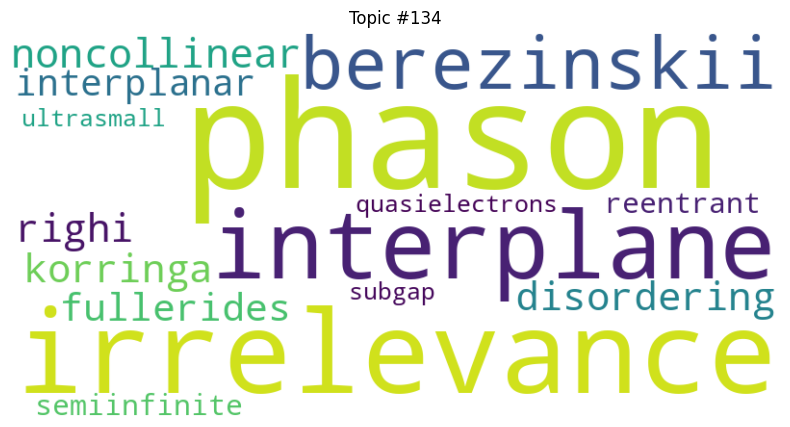

Topic #135:
Top terms: invariableness, versal, sah, leafwise, radul, alexandroff, subposets, mgl, moscovici, qdg, cocovering, cocylindrical, foxby, schlichting, vdb



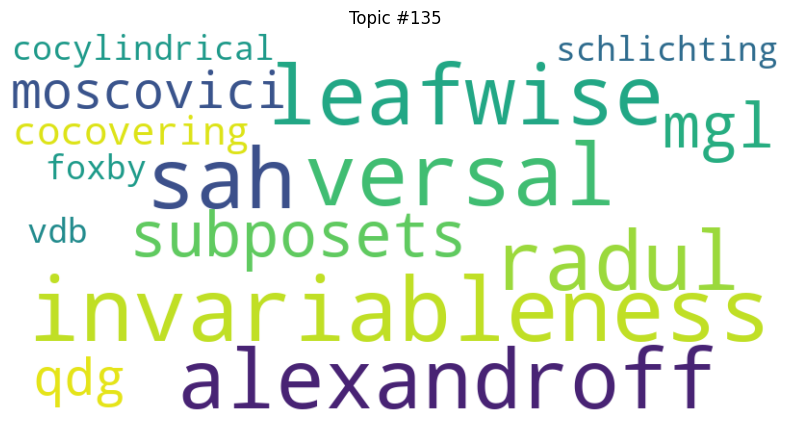

Topic #136:
Top terms: hood, cabbage, fnn, nutshell, parole, traitement, fnns, uwpt, comedie, shouted, phasiness, phonated, erieurs, vadi, comma



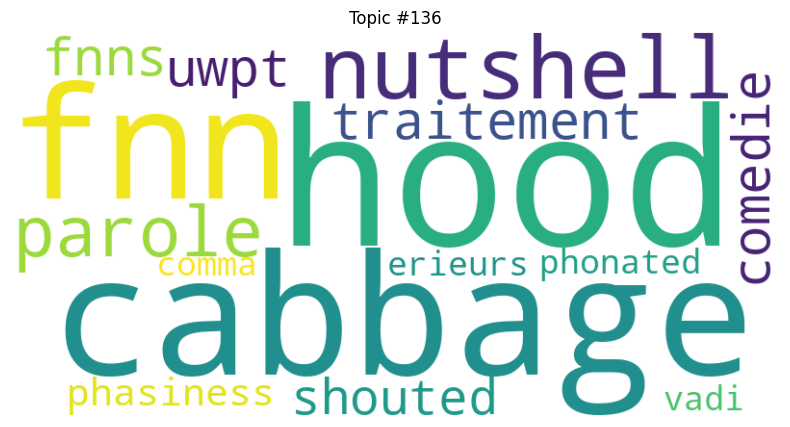

Topic #137:
Top terms: striped, permitted, ocular, transmissivity, quell, mechanotransduction, protease, glandular, sportive, rectal, sscs, misfolded, malformation, integrin, peroxidase



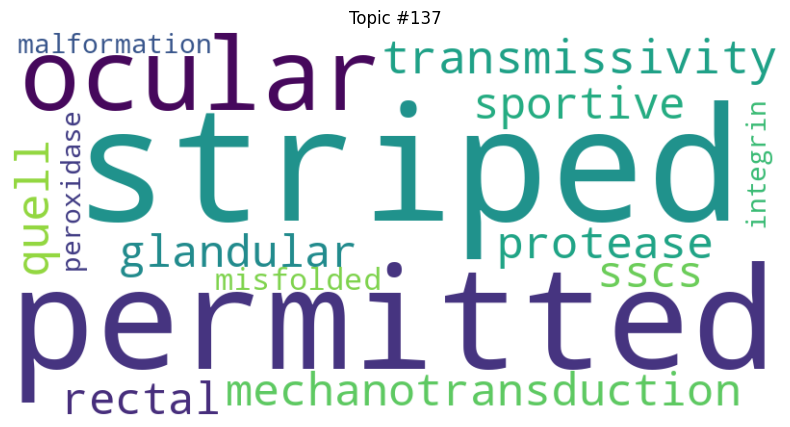

Topic #138:
Top terms: dafne, tgc, interpolates, ez, nedm, harvmac, rencontres, slepton, sleptons, bbbarf, kosower, anisotropies, dhr, enjl, piee



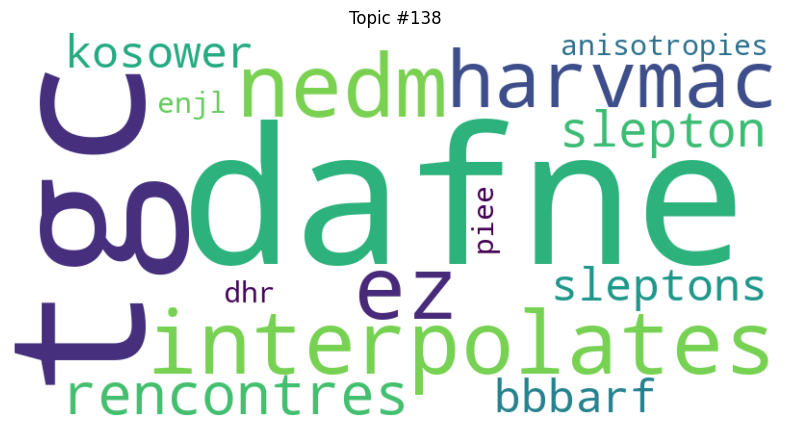

Topic #139:
Top terms: mckean, leland, jeanblanc, underlyings, pricers, pides, rmq, letf, bsdes, duffie, wwr, boukas, pellerey, safarian, labord



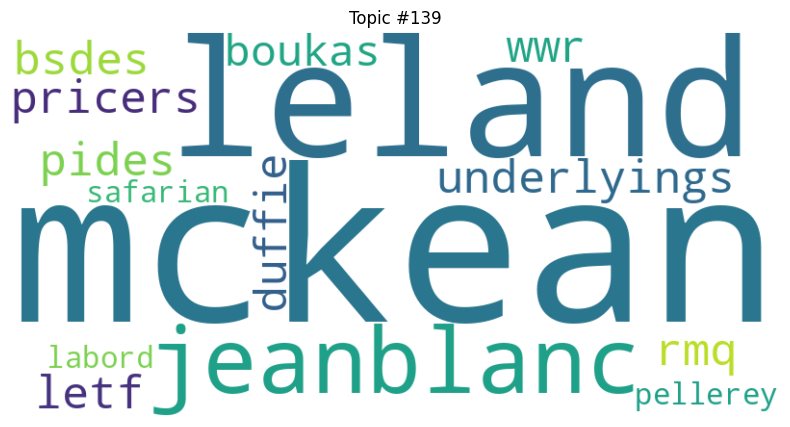

Topic #140:
Top terms: xrt, afterglows, ergs, rosat, supernovae, lightcurves, spi, westerbork, trgb, paczy, nrao, deimos, magellan, cmd, alfven



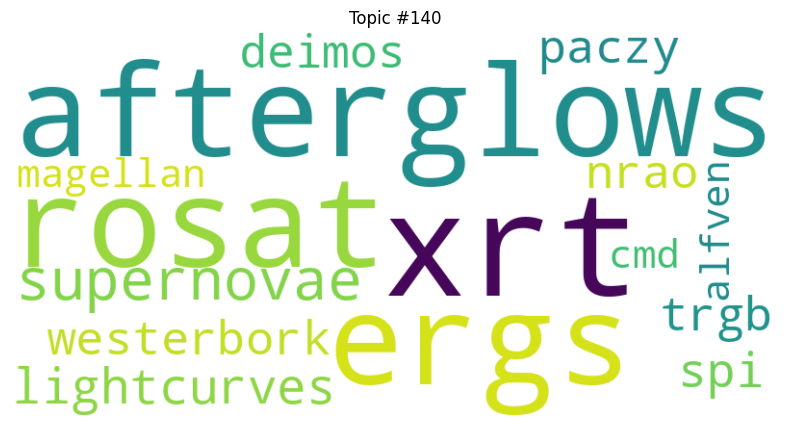

In [ ]:
topic_labels = {}
top_words_per_topic = []

# Get the feature names from the vectorizer
category_names = vectorizer_best.get_feature_names_out()
num_top_terms = 15  # Number of top terms to display for each topic

# Loop through each topic identified by LSA
for topic_idx, topic in enumerate(lsa_best.components_):
    # Ensure we have enough terms to display
    num_terms = len(topic)
    if num_terms < num_top_terms:
        print(f"Topic #{topic_idx}:")
        print("Not enough terms to display.")
    else:
        # Get indices of the top terms for the current topic
        top_terms_idx = np.argsort(topic)[-num_top_terms:][::-1]

        # Get the top terms based on the indices
        top_terms = [category_names[i] for i in top_terms_idx]
        top_terms_freq = {category_names[i]: topic[i] for i in top_terms_idx}

        top_words_per_topic.append(top_terms)

        # Combine the top words into a single label
        label = ", ".join(top_terms)
        topic_labels[topic_idx] = label  # Store the label for the current topic

        # Print the topic and its top terms
        print(f"Topic #{topic_idx}:")
        print("Top terms:", ", ".join(top_terms))
        print()

        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white', colormap='viridis').generate_from_frequencies(top_terms_freq)

        # Display the word cloud
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')  # Hide axes
        plt.title(f"Topic #{topic_idx}")
        plt.show()

In [ ]:
top_words_per_topic = []
feature_names = vectorizer_best.get_feature_names_out()

for topic_idx, topic in enumerate(lsa_best.components_):
    # Get the top 10 words for each topic
    top_word_indices = topic.argsort()[-10:][::-1]  # Get indices of the top 10 words
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

gensim_dictionary_train = gensim.corpora.Dictionary([text.split() for text in combined_train_df['train_input']])

top_words_per_topic_ids = []
for top_words in top_words_per_topic:
    top_words_ids = [gensim_dictionary_train.token2id[word] for word in top_words if word in gensim_dictionary_train.token2id]
    top_words_per_topic_ids.append(top_words_ids)

# Step 5: Compute coherence score using Gensim's CoherenceModel
coherence_model_train = CoherenceModel(
    topics=top_words_per_topic_ids,
    texts=[text.split() for text in combined_train_df['train_input']],
    dictionary=gensim_dictionary_train,
    coherence='c_v'
)

# Step 6: Get and print the coherence score
coherence_score_train = coherence_model_train.get_coherence()
print(f"Training Data Topic Coherence Score: {coherence_score_train:.4f}")


Training Data Topic Coherence Score: 0.4970


In [ ]:
with open('lsa_model.pkl', 'wb') as model_file:
    pickle.dump((lsa_best, X_tfidf_best), model_file)

print("LSA model Successfully saved to 'lsa_model.pkl'.")

LSA model Successfully saved to 'lsa_model.pkl'.


In [ ]:
# Mount Google Drive
drive.mount('/content/drive')

# Define the save path in Google Drive
save_path = '/content/drive/MyDrive/RDS/RDSY3S1/FYP1/Code/lsa_model.pkl'

# Save the model to the specified path
with open(save_path, 'wb') as model_file:
    pickle.dump((lsa_best, X_tfidf_best), model_file)

print(f"LSA model successfully saved to '{save_path}'.")

# Verify the file has been saved
print("Files in the target directory:")
print(os.listdir('/content/drive/MyDrive/RDS/RDSY3S1/FYP1/Code/'))


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
LSA model successfully saved to '/content/drive/MyDrive/RDS/RDSY3S1/FYP1/Code/lsa_model.pkl'.
Files in the target directory:
['subjectClassify.csv', 'Subject.txt', 'Untitled document.gdoc', 'test_data.pkl', 'train_data.pkl', 'cleaned_dataset.pkl', 'Modeling1.ipynb', 'lsa_model.pkl']


### Testing Model

In [ ]:
test_d= test_data[['WordTitle', 'WordSummary']].apply(lambda x: ' '.join(x['WordTitle'].split() + x['WordSummary'].split()), axis=1).tolist()

vt_test = vectorizer_best.transform(test_d)

# Apply the trained LSA model to the test data
lsa_test = lsa_best.transform(vt_test)

In [ ]:
# Apply preprocessing to all rows in the DataFrame
test_df['test_input'] = test_df['test_input'].apply(preprocess_text)

# Group by 'train_label' and combine texts, removing duplicate words
combined_test_df = (
    test_df
    .groupby('test_label')['test_input']
    .apply(lambda x: ' '.join(set(' '.join(x).split())))
    .reset_index()
)

# Display the combined DataFrame
print("Combined DataFrame based on train_label without repeating words:")
print(combined_test_df)

Combined DataFrame based on train_label without repeating words:
                            test_label  \
0                  Accelerator Physics   
1          Adaptation and Optimization   
2              Algebraic Combinatorics   
3                   Algebraic Geometry   
4                   Algebraic Topology   
..                                 ...   
136                Systems and Control   
137              Theoretical Economics   
138                             Theory   
139  Trading and Market Microstructure   
140                      Tumor Biology   

                                            test_input  
0    step proper exotic regime model chicane combin...  
1    step regime model steadily positively law time...  
2    step veronese y noteq short binomial bridge eq...  
3    step proper curvature modification y hurwitz s...  
4    step morse y theoretical widehat converge mora...  
..                                                 ...  
136  step pp proper thermoelect

#### Evaluation of Testing Model

In [ ]:
top_words_per_topic = []
feature_names = vectorizer_best.get_feature_names_out()

for topic_idx, topic in enumerate(lsa_best.components_):
    # Get the top 10 words for each topic
    top_word_indices = topic.argsort()[-10:][::-1]  # Get indices of the top 10 words
    top_words = [feature_names[i] for i in top_word_indices]
    top_words_per_topic.append(top_words)

gensim_dictionary_test = gensim.corpora.Dictionary([text.split() for text in combined_test_df['test_input']])

top_words_per_topic_ids = []
for top_words in top_words_per_topic:
    top_words_ids = [gensim_dictionary_test.token2id[word] for word in top_words if word in gensim_dictionary_test.token2id]
    top_words_per_topic_ids.append(top_words_ids)

# Step 5: Compute coherence score using Gensim's CoherenceModel
coherence_model_test = CoherenceModel(
    topics=top_words_per_topic_ids,
    texts=[text.split() for text in combined_test_df['test_input']],
    dictionary=gensim_dictionary_test,
    coherence='c_v'
)

# Step 6: Get and print the coherence score
coherence_score_test = coherence_model_test.get_coherence()
print(f"Testing Data Topic Coherence Score: {coherence_score_test:.4f}")


Testing Data Topic Coherence Score: 0.3539


In [ ]:
# Example document titles (replace with actual document identifiers or titles)
document_titles = [f"Title {i}" for i in range(len(combined_test_df))]

# Number of documents to print (set to None to print all)
num_docs_to_print = 5

# To track unique topic distributions
printed_distributions = set()

# Print the topic distribution for each document
print_count = 0
for doc_idx, topic_distribution in enumerate(lsa_test):
    # Skip if we've printed the maximum number of documents
    if num_docs_to_print is not None and print_count >= num_docs_to_print:
        break

    # Convert topic distribution to a tuple for comparison (hashable type)
    topic_distribution_tuple = tuple(np.round(topic_distribution, 4))

    # Skip if this distribution has already been printed
    if topic_distribution_tuple in printed_distributions:
        continue

    # Add to the set of printed distributions
    printed_distributions.add(topic_distribution_tuple)

    # Retrieve the document title
    doc_title = document_titles[doc_idx]  # Replace with actual title or identifier
    print(f"Document {doc_idx} ({doc_title}) topic distribution:")

    # Create a list of (topic_idx, score) tuples and sort by score in descending order
    topic_scores = [(topic_idx, score) for topic_idx, score in enumerate(topic_distribution)]
    topic_scores_sorted = sorted(topic_scores, key=lambda x: x[1], reverse=True)

    # Print top topics for this document
    for topic_idx, score in topic_scores_sorted:
        print(f"  Topic {topic_idx}: {score:.4f}")

    # Increment the print counter
    print_count += 1


Document 0 (Title 0) topic distribution:
  Topic 30: 0.0227
  Topic 40: 0.0212
  Topic 24: 0.0175
  Topic 56: 0.0173
  Topic 90: 0.0170
  Topic 43: 0.0167
  Topic 19: 0.0159
  Topic 65: 0.0137
  Topic 130: 0.0131
  Topic 0: 0.0122
  Topic 98: 0.0119
  Topic 49: 0.0114
  Topic 99: 0.0112
  Topic 34: 0.0103
  Topic 25: 0.0096
  Topic 76: 0.0095
  Topic 117: 0.0090
  Topic 85: 0.0087
  Topic 122: 0.0086
  Topic 42: 0.0085
  Topic 111: 0.0076
  Topic 124: 0.0074
  Topic 114: 0.0074
  Topic 127: 0.0068
  Topic 4: 0.0068
  Topic 83: 0.0066
  Topic 26: 0.0065
  Topic 92: 0.0065
  Topic 41: 0.0064
  Topic 18: 0.0064
  Topic 2: 0.0061
  Topic 52: 0.0060
  Topic 97: 0.0059
  Topic 119: 0.0057
  Topic 33: 0.0053
  Topic 109: 0.0051
  Topic 23: 0.0042
  Topic 68: 0.0041
  Topic 14: 0.0040
  Topic 64: 0.0039
  Topic 36: 0.0039
  Topic 31: 0.0038
  Topic 128: 0.0032
  Topic 87: 0.0031
  Topic 15: 0.0031
  Topic 17: 0.0030
  Topic 27: 0.0028
  Topic 116: 0.0027
  Topic 79: 0.0025
  Topic 110: 0.0025


In [ ]:
# Create a mapping from index to test_label
label_mapping = {index: label for index, label in enumerate(combined_test_df['test_label'])}

# Find the topic with the highest score for each document
most_relevant_topics = np.argmax(lsa_test, axis=1)

# Define the number of documents to print
num_docs_to_print = 1000  # Adjust this number as needed

# Print the most relevant topic for the first 1000 documents
for doc_idx, topic_idx in enumerate(most_relevant_topics):
    if doc_idx >= num_docs_to_print:  # Stop after printing the first 1000 documents
        break
    topic_name = label_mapping.get(topic_idx, f"Topic {topic_idx}")  # Use the mapping or default to Topic {topic_idx}
    print(f"Document {doc_idx} is most relevant to Topic: {topic_name}")


Document 0 is most relevant to Topic: Computational Statistics
Document 1 is most relevant to Topic: Subcellular Processes
Document 2 is most relevant to Topic: Accelerator Physics
Document 3 is most relevant to Topic: Accelerator Physics
Document 4 is most relevant to Topic: Computational Statistics
Document 5 is most relevant to Topic: Accelerator Physics
Document 6 is most relevant to Topic: Computational Statistics
Document 7 is most relevant to Topic: Complex Variables
Document 8 is most relevant to Topic: Accelerator Physics
Document 9 is most relevant to Topic: Computational Statistics
Document 10 is most relevant to Topic: Differential Geometry
Document 11 is most relevant to Topic: Computational Statistics
Document 12 is most relevant to Topic: Artificial Intelligence
Document 13 is most relevant to Topic: Computational Statistics
Document 14 is most relevant to Topic: Computational Statistics
Document 15 is most relevant to Topic: Self-Organizing Systems
Document 16 is most r

In [ ]:
# Create a mapping from index to test_label
label_mapping = {index: label for index, label in enumerate(combined_test_df['test_label'])}

# Find the topic with the highest score for each document
most_relevant_topics = np.argmax(lsa_test, axis=1)

# Map topic indices to descriptive topic names
mapped_topics = [label_mapping.get(topic_idx, f"Topic {topic_idx}") for topic_idx in most_relevant_topics]

# Count occurrences of each topic
topic_counts = Counter(mapped_topics)

# Print the topic distribution
print("Topic Distribution:")
for topic_name, count in topic_counts.items():
    print(f"{topic_name}: {count} documents")

Topic Distribution:
Computational Statistics: 84 documents
Subcellular Processes: 88 documents
Accelerator Physics: 2709 documents
Complex Variables: 26 documents
Differential Geometry: 87 documents
Artificial Intelligence: 170 documents
Self-Organizing Systems: 39 documents
Applied Physics: 134 documents
Statistics: 60 documents
Spectral Theory: 53 documents
History and Overview: 53 documents
Software Development: 6 documents
Data Analysis: 39 documents
Mesoscale and Hall Effect: 54 documents
Education and Physics: 35 documents
Graphics: 34 documents
Space Physics: 38 documents
Quantum Algebra: 19 documents
Tumor Biology: 68 documents
Chaotic Dynamics: 71 documents
History of Physics: 10 documents
Theory: 48 documents
Instrumentation and Methods for Astrophysics: 60 documents
Scientific Computing: 28 documents
Algebraic Combinatorics: 349 documents
Computational Geometry: 110 documents
Non-coding RNA: 39 documents
Applications: 150 documents
Genomics: 76 documents
Economics: 27 docume

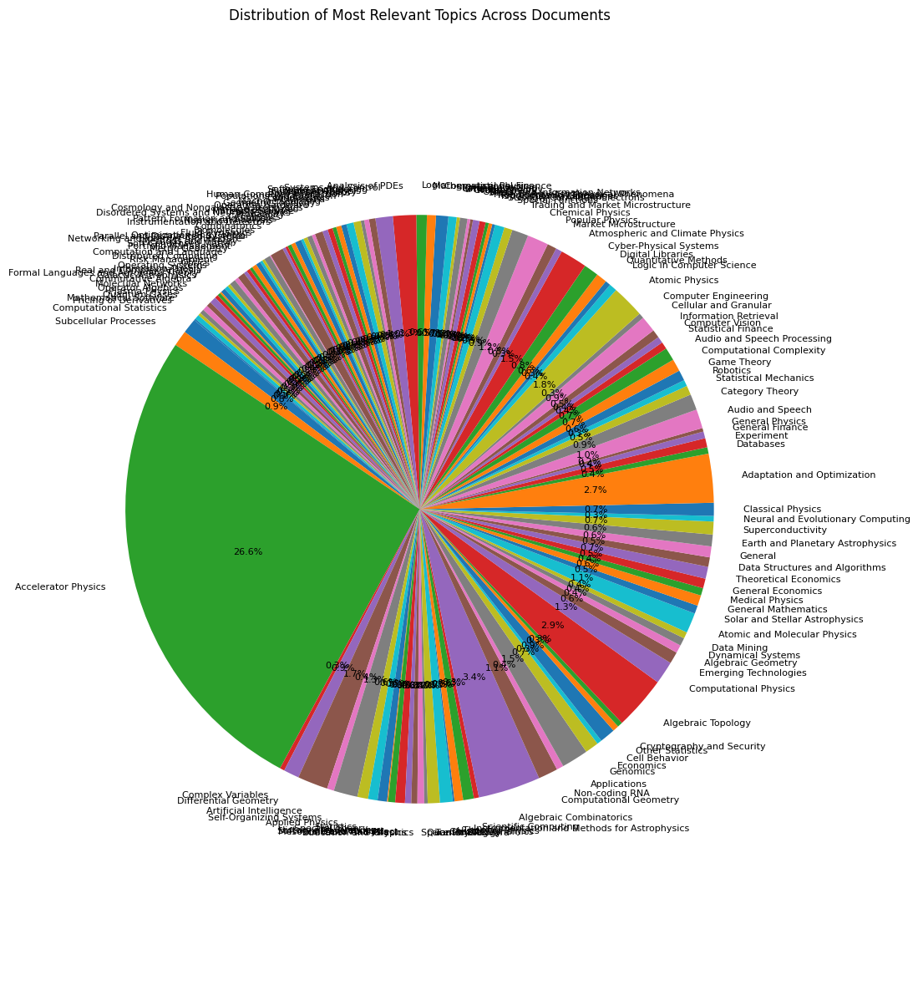

In [ ]:
# Create a mapping from index to test_label
label_mapping = {index: label for index, label in enumerate(combined_test_df['test_label'])}

# Find the topic with the highest score for each document
most_relevant_topics = np.argmax(lsa_test, axis=1)

# Map topic indices to descriptive topic names
mapped_topics = [label_mapping.get(topic_idx, f"Topic {topic_idx}") for topic_idx in most_relevant_topics]

# Count occurrences of each topic
topic_counts = Counter(mapped_topics)

# Data for the pie chart
labels = list(topic_counts.keys())
sizes = list(topic_counts.values())

# Create the pie chart
plt.figure(figsize=(10, 15))
plt.pie(
    sizes, labels=labels, autopct='%1.1f%%', startangle=140, textprops={'fontsize': 8}
)
plt.title("Distribution of Most Relevant Topics Across Documents")
plt.axis('equal')  # Equal aspect ratio ensures that the pie chart is circular.
plt.show()

In [ ]:
# Map the test labels to numeric indices (if they are strings)
correct_labels = test_df['test_label']
label_to_index = {label: idx for idx, label in enumerate(combined_test_df['test_label'])}
correct_labels_numeric = correct_labels.map(label_to_index)

# Now compute the confusion matrix
conf_matrix = confusion_matrix(correct_labels_numeric, most_relevant_topics)

# Clustering Purity
def clustering_purity(conf_matrix):
    total_correct = np.sum(np.amax(conf_matrix, axis=1))
    total_docs = np.sum(conf_matrix)
    return total_correct / total_docs

purity_score = clustering_purity(conf_matrix)
print(f"Clustering Purity: {purity_score:.4f}")

# Precision, Recall, F1 Score
precision, recall, f1, support = precision_recall_fscore_support(correct_labels_numeric, most_relevant_topics, average='weighted')

print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

Clustering Purity: 0.3315
Precision: 0.0072
Recall: 0.0060
F1 Score: 0.0051


### Input Testing

In [ ]:
def print_relevant_topics(user_input):
    # Transform the user input
    user_input_vector = vectorizer_best.transform([user_input])

    # Transform user input vector with the LSA model
    user_input_lsa = lsa_best.transform(user_input_vector)

    # Get topic distribution for the user input
    topic_distribution = user_input_lsa[0]

    # Get the indices of the top 2 topics
    top_topics_idx = np.argsort(topic_distribution)[-2:][::-1]

    # Map topic indices to topic labels
    idx_to_label = {idx: label for idx, label in enumerate(combined_test_df['test_label'])}

    # Print the results with topic labels instead of indices
    print("\nMost relevant topics:")
    for topic_idx in top_topics_idx:
        topic_label = idx_to_label[topic_idx]  # Get topic label
        print(f"Topic: {topic_label} - Score: {topic_distribution[topic_idx]:.4f}")

    # Create a bar chart for the top topics
    top_topic_scores = [topic_distribution[idx] for idx in top_topics_idx]
    top_topic_labels = [idx_to_label[idx] for idx in top_topics_idx]  # Use topic labels here
    percentages = [score * 100 for score in top_topic_scores]

    plt.figure(figsize=(8, 4))
    plt.bar(top_topic_labels, percentages, color='#B2B0EA')
    plt.xlabel('Topics')
    plt.ylabel('Percentage (%)')
    plt.title('Top 2 Relevant Topics')
    plt.ylim(0, 100)
    plt.show()

Enter your text: Natural language processing (NLP) is gaining momentum in management research for its ability to automatically analyze and comprehend human language. Yet, despite its extensive application in management research, there is neither a comprehensive review of extant literature on such applications, nor is there a detailed walkthrough on how it can be employed as an analytical technique. To this end, we review articles in the UT Dallas List of 24 Leading Business Journals that employ NLP as their focal analytical technique to elucidate how textual data can be harnessed for advancing management theories across multiple disciplines. We describe the available toolkits and procedural steps for employing NLP as an analytical technique as well as its advantages and disadvantages. In so doing, we highlight the managerial and technological challenges associated with the application of NLP in management research in order to guide future inquires.

Most relevant topics:
Topic: Databas

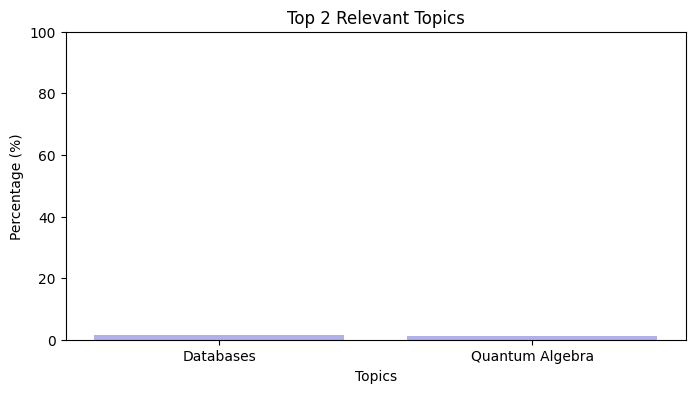

In [ ]:
user_input = input("Enter your text: ")
print_relevant_topics(user_input)